In [1]:
import sklearn as sk

In [2]:
import pandas as pd
import numpy as np

In [3]:
data = pd.read_csv('/Users/marcberghouse/Downloads/Water-Table-Depth-Prediction-PyTorch-master/data/demo.csv')

In [4]:
y=data.Depth
x=data.iloc[:,0:6]
x

,Year,Month,Irrigation,Rainfall,Tem,Evaporation
0,2000,1,1992.508320,314.195717,-19.295408,12040.447639
1,2000,2,-2042.251709,-1633.766775,-38.449836,18045.516826
2,2000,3,-1374.450691,868.263712,-36.962377,90248.598688
3,2000,4,29951.326599,309.857142,-13.165645,141672.950997
4,2000,5,43748.371155,-291.325005,19.602103,188789.213348
...,...,...,...,...,...,...
163,2013,8,19170.849833,1711.239565,92.150263,133324.710105
164,2013,9,17390.147122,14636.845534,96.190950,99089.007225
165,2013,10,68788.714886,-251.937762,87.420502,81966.091226
166,2013,11,-1052.841773,-243.565260,58.526044,31874.837843


In [5]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(np.array(x), np.array(y), test_size=0.2, random_state=42)

In [6]:
X_train

array([[ 2.00500000e+03,  1.00000000e+01,  5.85586406e+04,
         3.60679427e+04,  7.75209698e+01,  5.59571689e+04],
       [ 2.01100000e+03,  5.00000000e+00,  4.67784990e+04,
         2.73503188e+03,  1.81755183e+01,  1.89061385e+05],
       [ 2.00000000e+03,  3.00000000e+00, -1.37445069e+03,
         8.68263712e+02, -3.69623765e+01,  9.02485987e+04],
       [ 2.00700000e+03,  1.00000000e+01,  6.90455357e+04,
         1.26005843e+04,  9.35948081e+01,  7.19996992e+04],
       [ 2.01100000e+03,  3.00000000e+00, -2.31546876e+03,
        -7.05134362e+02, -5.29468241e+01,  5.25518806e+04],
       [ 2.01200000e+03,  9.00000000e+00,  1.50756051e+04,
         1.42047958e+04,  8.87135554e+01,  8.86962930e+04],
       [ 2.00700000e+03,  7.00000000e+00,  4.35779170e+04,
         2.33779328e+04,  7.90143582e+01,  1.35487719e+05],
       [ 2.00900000e+03,  7.00000000e+00,  4.30632204e+04,
         1.69717448e+04,  8.95029135e+01,  1.88137937e+05],
       [ 2.00200000e+03,  3.00000000e+00, -2.182

In [10]:
from sklearn.ensemble import RandomForestRegressor
regr_forest = make_pipeline(StandardScaler(),RandomForestRegressor(max_depth=16, random_state=0))
regr_forest.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestregressor',
                 RandomForestRegressor(max_depth=16, random_state=0))])

In [8]:
regr_neigh =sk.neighbors.KNeighborsRegressor(n_neighbors=20)
regr_neigh.fit(X_train,y_train)

KNeighborsRegressor(n_neighbors=20)

In [9]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import SGDRegressor
regr_sgd = make_pipeline(StandardScaler(),SGDRegressor(max_iter=1000, tol=1e-3))
regr_sgd.fit(X_train,y_train)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor())])

In [22]:
from sklearn import svm
regr_svr = svm.SVR(kernel='poly',C=1,tol=1e-6,epsilon=1)
regr_svr.fit(X_train,y_train)


SVR(C=1, epsilon=1, kernel='poly', tol=1e-06)

In [69]:
from sklearn.neural_network import MLPRegressor
regr_mlp = make_pipeline(StandardScaler(), MLPRegressor(learning_rate_init=3e-5,random_state=0, max_iter=100000,verbose=True,tol=1e-5, validation_fraction=.1))
regr_mlp.fit(X_train, y_train)

Iteration 1, loss = 29.59077378
Iteration 2, loss = 29.58304655
Iteration 3, loss = 29.57531987
Iteration 4, loss = 29.56759511
Iteration 5, loss = 29.55987229
Iteration 6, loss = 29.55215161
Iteration 7, loss = 29.54443331
Iteration 8, loss = 29.53671633
Iteration 9, loss = 29.52900082
Iteration 10, loss = 29.52128660
Iteration 11, loss = 29.51357508
Iteration 12, loss = 29.50586562
Iteration 13, loss = 29.49815872
Iteration 14, loss = 29.49045378
Iteration 15, loss = 29.48275070
Iteration 16, loss = 29.47505016
Iteration 17, loss = 29.46735144
Iteration 18, loss = 29.45965465
Iteration 19, loss = 29.45196135
Iteration 20, loss = 29.44427043
Iteration 21, loss = 29.43658156
Iteration 22, loss = 29.42889442
Iteration 23, loss = 29.42120737
Iteration 24, loss = 29.41352008
Iteration 25, loss = 29.40583268
Iteration 26, loss = 29.39815059
Iteration 27, loss = 29.39047093
Iteration 28, loss = 29.38279312
Iteration 29, loss = 29.37511719
Iteration 30, loss = 29.36744234
Iteration 31, loss 

Iteration 290, loss = 27.42807026
Iteration 291, loss = 27.42080278
Iteration 292, loss = 27.41353594
Iteration 293, loss = 27.40627034
Iteration 294, loss = 27.39900614
Iteration 295, loss = 27.39174337
Iteration 296, loss = 27.38448201
Iteration 297, loss = 27.37722216
Iteration 298, loss = 27.36996417
Iteration 299, loss = 27.36270828
Iteration 300, loss = 27.35545299
Iteration 301, loss = 27.34819788
Iteration 302, loss = 27.34094385
Iteration 303, loss = 27.33369063
Iteration 304, loss = 27.32643822
Iteration 305, loss = 27.31918690
Iteration 306, loss = 27.31193676
Iteration 307, loss = 27.30468807
Iteration 308, loss = 27.29744095
Iteration 309, loss = 27.29019314
Iteration 310, loss = 27.28294719
Iteration 311, loss = 27.27570306
Iteration 312, loss = 27.26846101
Iteration 313, loss = 27.26122036
Iteration 314, loss = 27.25398099
Iteration 315, loss = 27.24674318
Iteration 316, loss = 27.23950684
Iteration 317, loss = 27.23227334
Iteration 318, loss = 27.22504130
Iteration 319,

Iteration 626, loss = 25.04953661
Iteration 627, loss = 25.04260978
Iteration 628, loss = 25.03568419
Iteration 629, loss = 25.02875937
Iteration 630, loss = 25.02183453
Iteration 631, loss = 25.01491137
Iteration 632, loss = 25.00799072
Iteration 633, loss = 25.00107192
Iteration 634, loss = 24.99415428
Iteration 635, loss = 24.98723776
Iteration 636, loss = 24.98031959
Iteration 637, loss = 24.97340258
Iteration 638, loss = 24.96648685
Iteration 639, loss = 24.95957203
Iteration 640, loss = 24.95265412
Iteration 641, loss = 24.94573692
Iteration 642, loss = 24.93881891
Iteration 643, loss = 24.93190188
Iteration 644, loss = 24.92498184
Iteration 645, loss = 24.91806146
Iteration 646, loss = 24.91114121
Iteration 647, loss = 24.90421945
Iteration 648, loss = 24.89729676
Iteration 649, loss = 24.89037494
Iteration 650, loss = 24.88345598
Iteration 651, loss = 24.87653788
Iteration 652, loss = 24.86962015
Iteration 653, loss = 24.86270229
Iteration 654, loss = 24.85578489
Iteration 655,

Iteration 959, loss = 22.77759436
Iteration 960, loss = 22.77086037
Iteration 961, loss = 22.76412593
Iteration 962, loss = 22.75739151
Iteration 963, loss = 22.75065691
Iteration 964, loss = 22.74392429
Iteration 965, loss = 22.73719313
Iteration 966, loss = 22.73046177
Iteration 967, loss = 22.72373104
Iteration 968, loss = 22.71700059
Iteration 969, loss = 22.71027110
Iteration 970, loss = 22.70354285
Iteration 971, loss = 22.69681482
Iteration 972, loss = 22.69008782
Iteration 973, loss = 22.68336123
Iteration 974, loss = 22.67663463
Iteration 975, loss = 22.66990854
Iteration 976, loss = 22.66318350
Iteration 977, loss = 22.65646018
Iteration 978, loss = 22.64973815
Iteration 979, loss = 22.64301599
Iteration 980, loss = 22.63629420
Iteration 981, loss = 22.62957314
Iteration 982, loss = 22.62285247
Iteration 983, loss = 22.61613165
Iteration 984, loss = 22.60941142
Iteration 985, loss = 22.60269181
Iteration 986, loss = 22.59597285
Iteration 987, loss = 22.58925484
Iteration 988,

Iteration 1286, loss = 20.60155710
Iteration 1287, loss = 20.59498292
Iteration 1288, loss = 20.58840832
Iteration 1289, loss = 20.58183450
Iteration 1290, loss = 20.57526210
Iteration 1291, loss = 20.56869057
Iteration 1292, loss = 20.56211971
Iteration 1293, loss = 20.55554951
Iteration 1294, loss = 20.54898000
Iteration 1295, loss = 20.54241125
Iteration 1296, loss = 20.53584313
Iteration 1297, loss = 20.52927531
Iteration 1298, loss = 20.52270826
Iteration 1299, loss = 20.51614217
Iteration 1300, loss = 20.50957730
Iteration 1301, loss = 20.50301325
Iteration 1302, loss = 20.49645012
Iteration 1303, loss = 20.48988578
Iteration 1304, loss = 20.48332250
Iteration 1305, loss = 20.47676004
Iteration 1306, loss = 20.47019826
Iteration 1307, loss = 20.46363719
Iteration 1308, loss = 20.45707690
Iteration 1309, loss = 20.45051731
Iteration 1310, loss = 20.44395906
Iteration 1311, loss = 20.43740244
Iteration 1312, loss = 20.43084667
Iteration 1313, loss = 20.42429175
Iteration 1314, loss

Iteration 1586, loss = 18.65271324
Iteration 1587, loss = 18.64627483
Iteration 1588, loss = 18.63983733
Iteration 1589, loss = 18.63340076
Iteration 1590, loss = 18.62696488
Iteration 1591, loss = 18.62052975
Iteration 1592, loss = 18.61409551
Iteration 1593, loss = 18.60766219
Iteration 1594, loss = 18.60123014
Iteration 1595, loss = 18.59479958
Iteration 1596, loss = 18.58837025
Iteration 1597, loss = 18.58194193
Iteration 1598, loss = 18.57551453
Iteration 1599, loss = 18.56908805
Iteration 1600, loss = 18.56266243
Iteration 1601, loss = 18.55623745
Iteration 1602, loss = 18.54981363
Iteration 1603, loss = 18.54339077
Iteration 1604, loss = 18.53696883
Iteration 1605, loss = 18.53054775
Iteration 1606, loss = 18.52412709
Iteration 1607, loss = 18.51770652
Iteration 1608, loss = 18.51128657
Iteration 1609, loss = 18.50486711
Iteration 1610, loss = 18.49844880
Iteration 1611, loss = 18.49203095
Iteration 1612, loss = 18.48561380
Iteration 1613, loss = 18.47919732
Iteration 1614, loss

Iteration 1876, loss = 16.81567715
Iteration 1877, loss = 16.80942905
Iteration 1878, loss = 16.80318076
Iteration 1879, loss = 16.79693334
Iteration 1880, loss = 16.79068673
Iteration 1881, loss = 16.78444127
Iteration 1882, loss = 16.77819663
Iteration 1883, loss = 16.77195289
Iteration 1884, loss = 16.76571012
Iteration 1885, loss = 16.75946819
Iteration 1886, loss = 16.75322727
Iteration 1887, loss = 16.74698750
Iteration 1888, loss = 16.74074863
Iteration 1889, loss = 16.73451067
Iteration 1890, loss = 16.72827365
Iteration 1891, loss = 16.72203722
Iteration 1892, loss = 16.71579916
Iteration 1893, loss = 16.70956159
Iteration 1894, loss = 16.70332491
Iteration 1895, loss = 16.69708893
Iteration 1896, loss = 16.69085369
Iteration 1897, loss = 16.68461917
Iteration 1898, loss = 16.67838539
Iteration 1899, loss = 16.67215185
Iteration 1900, loss = 16.66591867
Iteration 1901, loss = 16.65968619
Iteration 1902, loss = 16.65345458
Iteration 1903, loss = 16.64722361
Iteration 1904, loss

Iteration 2185, loss = 14.91963245
Iteration 2186, loss = 14.91361432
Iteration 2187, loss = 14.90759663
Iteration 2188, loss = 14.90157863
Iteration 2189, loss = 14.89556043
Iteration 2190, loss = 14.88954302
Iteration 2191, loss = 14.88352635
Iteration 2192, loss = 14.87751038
Iteration 2193, loss = 14.87149511
Iteration 2194, loss = 14.86548061
Iteration 2195, loss = 14.85946608
Iteration 2196, loss = 14.85345186
Iteration 2197, loss = 14.84743713
Iteration 2198, loss = 14.84142278
Iteration 2199, loss = 14.83540903
Iteration 2200, loss = 14.82939586
Iteration 2201, loss = 14.82338336
Iteration 2202, loss = 14.81737167
Iteration 2203, loss = 14.81136047
Iteration 2204, loss = 14.80534962
Iteration 2205, loss = 14.79933951
Iteration 2206, loss = 14.79333015
Iteration 2207, loss = 14.78732147
Iteration 2208, loss = 14.78131354
Iteration 2209, loss = 14.77530627
Iteration 2210, loss = 14.76929970
Iteration 2211, loss = 14.76329364
Iteration 2212, loss = 14.75728835
Iteration 2213, loss

Iteration 2477, loss = 13.19630992
Iteration 2478, loss = 13.19054077
Iteration 2479, loss = 13.18477274
Iteration 2480, loss = 13.17900586
Iteration 2481, loss = 13.17324017
Iteration 2482, loss = 13.16747559
Iteration 2483, loss = 13.16171217
Iteration 2484, loss = 13.15594987
Iteration 2485, loss = 13.15018870
Iteration 2486, loss = 13.14442871
Iteration 2487, loss = 13.13866990
Iteration 2488, loss = 13.13291224
Iteration 2489, loss = 13.12715392
Iteration 2490, loss = 13.12139588
Iteration 2491, loss = 13.11563843
Iteration 2492, loss = 13.10988170
Iteration 2493, loss = 13.10412554
Iteration 2494, loss = 13.09837021
Iteration 2495, loss = 13.09261551
Iteration 2496, loss = 13.08686171
Iteration 2497, loss = 13.08110884
Iteration 2498, loss = 13.07535696
Iteration 2499, loss = 13.06960610
Iteration 2500, loss = 13.06385642
Iteration 2501, loss = 13.05810751
Iteration 2502, loss = 13.05235964
Iteration 2503, loss = 13.04661299
Iteration 2504, loss = 13.04086738
Iteration 2505, loss

Iteration 2796, loss = 11.40667280
Iteration 2797, loss = 11.40123440
Iteration 2798, loss = 11.39579734
Iteration 2799, loss = 11.39036115
Iteration 2800, loss = 11.38492625
Iteration 2801, loss = 11.37949262
Iteration 2802, loss = 11.37405967
Iteration 2803, loss = 11.36862789
Iteration 2804, loss = 11.36319728
Iteration 2805, loss = 11.35776725
Iteration 2806, loss = 11.35233817
Iteration 2807, loss = 11.34691022
Iteration 2808, loss = 11.34148280
Iteration 2809, loss = 11.33605563
Iteration 2810, loss = 11.33062882
Iteration 2811, loss = 11.32520299
Iteration 2812, loss = 11.31977820
Iteration 2813, loss = 11.31435448
Iteration 2814, loss = 11.30893126
Iteration 2815, loss = 11.30350766
Iteration 2816, loss = 11.29808494
Iteration 2817, loss = 11.29266335
Iteration 2818, loss = 11.28724274
Iteration 2819, loss = 11.28182314
Iteration 2820, loss = 11.27640464
Iteration 2821, loss = 11.27098601
Iteration 2822, loss = 11.26556759
Iteration 2823, loss = 11.26014990
Iteration 2824, loss

Iteration 3129, loss = 9.66058531
Iteration 3130, loss = 9.65556148
Iteration 3131, loss = 9.65053899
Iteration 3132, loss = 9.64551786
Iteration 3133, loss = 9.64049815
Iteration 3134, loss = 9.63547984
Iteration 3135, loss = 9.63046293
Iteration 3136, loss = 9.62544741
Iteration 3137, loss = 9.62043334
Iteration 3138, loss = 9.61542088
Iteration 3139, loss = 9.61040979
Iteration 3140, loss = 9.60540017
Iteration 3141, loss = 9.60039200
Iteration 3142, loss = 9.59538525
Iteration 3143, loss = 9.59037998
Iteration 3144, loss = 9.58537619
Iteration 3145, loss = 9.58037351
Iteration 3146, loss = 9.57537226
Iteration 3147, loss = 9.57037251
Iteration 3148, loss = 9.56537427
Iteration 3149, loss = 9.56037746
Iteration 3150, loss = 9.55538218
Iteration 3151, loss = 9.55038854
Iteration 3152, loss = 9.54539636
Iteration 3153, loss = 9.54040564
Iteration 3154, loss = 9.53541638
Iteration 3155, loss = 9.53042857
Iteration 3156, loss = 9.52544214
Iteration 3157, loss = 9.52045704
Iteration 3158

Iteration 3460, loss = 8.07770662
Iteration 3461, loss = 8.07316375
Iteration 3462, loss = 8.06862236
Iteration 3463, loss = 8.06408245
Iteration 3464, loss = 8.05954409
Iteration 3465, loss = 8.05500721
Iteration 3466, loss = 8.05047183
Iteration 3467, loss = 8.04593792
Iteration 3468, loss = 8.04140523
Iteration 3469, loss = 8.03687402
Iteration 3470, loss = 8.03234429
Iteration 3471, loss = 8.02781607
Iteration 3472, loss = 8.02328937
Iteration 3473, loss = 8.01876417
Iteration 3474, loss = 8.01424060
Iteration 3475, loss = 8.00971860
Iteration 3476, loss = 8.00519815
Iteration 3477, loss = 8.00067925
Iteration 3478, loss = 7.99616195
Iteration 3479, loss = 7.99164627
Iteration 3480, loss = 7.98713217
Iteration 3481, loss = 7.98261961
Iteration 3482, loss = 7.97810858
Iteration 3483, loss = 7.97359911
Iteration 3484, loss = 7.96909121
Iteration 3485, loss = 7.96458498
Iteration 3486, loss = 7.96008031
Iteration 3487, loss = 7.95557722
Iteration 3488, loss = 7.95107570
Iteration 3489

Iteration 3793, loss = 6.65016433
Iteration 3794, loss = 6.64614041
Iteration 3795, loss = 6.64211811
Iteration 3796, loss = 6.63809740
Iteration 3797, loss = 6.63407832
Iteration 3798, loss = 6.63006085
Iteration 3799, loss = 6.62604500
Iteration 3800, loss = 6.62203076
Iteration 3801, loss = 6.61801812
Iteration 3802, loss = 6.61400726
Iteration 3803, loss = 6.60999798
Iteration 3804, loss = 6.60599032
Iteration 3805, loss = 6.60198424
Iteration 3806, loss = 6.59797980
Iteration 3807, loss = 6.59397703
Iteration 3808, loss = 6.58997588
Iteration 3809, loss = 6.58597645
Iteration 3810, loss = 6.58197850
Iteration 3811, loss = 6.57798189
Iteration 3812, loss = 6.57398684
Iteration 3813, loss = 6.56999333
Iteration 3814, loss = 6.56600141
Iteration 3815, loss = 6.56201107
Iteration 3816, loss = 6.55802235
Iteration 3817, loss = 6.55403525
Iteration 3818, loss = 6.55004989
Iteration 3819, loss = 6.54606617
Iteration 3820, loss = 6.54208404
Iteration 3821, loss = 6.53810354
Iteration 3822

Iteration 4103, loss = 5.47988206
Iteration 4104, loss = 5.47635952
Iteration 4105, loss = 5.47283863
Iteration 4106, loss = 5.46931933
Iteration 4107, loss = 5.46580185
Iteration 4108, loss = 5.46228610
Iteration 4109, loss = 5.45877204
Iteration 4110, loss = 5.45525974
Iteration 4111, loss = 5.45174917
Iteration 4112, loss = 5.44824035
Iteration 4113, loss = 5.44473332
Iteration 4114, loss = 5.44122808
Iteration 4115, loss = 5.43772454
Iteration 4116, loss = 5.43422269
Iteration 4117, loss = 5.43072253
Iteration 4118, loss = 5.42722403
Iteration 4119, loss = 5.42372721
Iteration 4120, loss = 5.42023206
Iteration 4121, loss = 5.41673860
Iteration 4122, loss = 5.41324680
Iteration 4123, loss = 5.40975661
Iteration 4124, loss = 5.40626810
Iteration 4125, loss = 5.40278131
Iteration 4126, loss = 5.39929621
Iteration 4127, loss = 5.39581278
Iteration 4128, loss = 5.39233104
Iteration 4129, loss = 5.38885107
Iteration 4130, loss = 5.38537277
Iteration 4131, loss = 5.38189616
Iteration 4132

Iteration 4439, loss = 4.38967878
Iteration 4440, loss = 4.38671326
Iteration 4441, loss = 4.38374939
Iteration 4442, loss = 4.38078716
Iteration 4443, loss = 4.37782656
Iteration 4444, loss = 4.37486766
Iteration 4445, loss = 4.37191047
Iteration 4446, loss = 4.36895489
Iteration 4447, loss = 4.36600072
Iteration 4448, loss = 4.36304812
Iteration 4449, loss = 4.36009715
Iteration 4450, loss = 4.35714787
Iteration 4451, loss = 4.35420023
Iteration 4452, loss = 4.35125434
Iteration 4453, loss = 4.34831016
Iteration 4454, loss = 4.34536769
Iteration 4455, loss = 4.34242687
Iteration 4456, loss = 4.33948773
Iteration 4457, loss = 4.33655001
Iteration 4458, loss = 4.33361322
Iteration 4459, loss = 4.33067799
Iteration 4460, loss = 4.32774442
Iteration 4461, loss = 4.32481222
Iteration 4462, loss = 4.32188162
Iteration 4463, loss = 4.31895253
Iteration 4464, loss = 4.31602498
Iteration 4465, loss = 4.31309902
Iteration 4466, loss = 4.31017479
Iteration 4467, loss = 4.30725218
Iteration 4468

Iteration 4785, loss = 3.45999648
Iteration 4786, loss = 3.45758960
Iteration 4787, loss = 3.45518431
Iteration 4788, loss = 3.45278060
Iteration 4789, loss = 3.45037846
Iteration 4790, loss = 3.44797750
Iteration 4791, loss = 3.44557786
Iteration 4792, loss = 3.44317971
Iteration 4793, loss = 3.44078312
Iteration 4794, loss = 3.43838809
Iteration 4795, loss = 3.43599457
Iteration 4796, loss = 3.43360261
Iteration 4797, loss = 3.43121224
Iteration 4798, loss = 3.42882345
Iteration 4799, loss = 3.42643622
Iteration 4800, loss = 3.42405064
Iteration 4801, loss = 3.42166665
Iteration 4802, loss = 3.41928425
Iteration 4803, loss = 3.41690345
Iteration 4804, loss = 3.41452425
Iteration 4805, loss = 3.41214664
Iteration 4806, loss = 3.40977060
Iteration 4807, loss = 3.40739619
Iteration 4808, loss = 3.40502337
Iteration 4809, loss = 3.40265213
Iteration 4810, loss = 3.40028250
Iteration 4811, loss = 3.39791448
Iteration 4812, loss = 3.39554805
Iteration 4813, loss = 3.39318322
Iteration 4814

Iteration 5107, loss = 2.76534463
Iteration 5108, loss = 2.76343344
Iteration 5109, loss = 2.76152369
Iteration 5110, loss = 2.75961540
Iteration 5111, loss = 2.75770858
Iteration 5112, loss = 2.75580328
Iteration 5113, loss = 2.75389944
Iteration 5114, loss = 2.75199699
Iteration 5115, loss = 2.75009601
Iteration 5116, loss = 2.74819658
Iteration 5117, loss = 2.74629855
Iteration 5118, loss = 2.74440197
Iteration 5119, loss = 2.74250677
Iteration 5120, loss = 2.74061276
Iteration 5121, loss = 2.73872019
Iteration 5122, loss = 2.73682907
Iteration 5123, loss = 2.73493939
Iteration 5124, loss = 2.73305122
Iteration 5125, loss = 2.73116452
Iteration 5126, loss = 2.72927930
Iteration 5127, loss = 2.72739554
Iteration 5128, loss = 2.72551323
Iteration 5129, loss = 2.72363241
Iteration 5130, loss = 2.72175307
Iteration 5131, loss = 2.71987520
Iteration 5132, loss = 2.71799883
Iteration 5133, loss = 2.71612393
Iteration 5134, loss = 2.71425058
Iteration 5135, loss = 2.71237868
Iteration 5136

Iteration 5442, loss = 2.20517187
Iteration 5443, loss = 2.20372974
Iteration 5444, loss = 2.20228941
Iteration 5445, loss = 2.20085046
Iteration 5446, loss = 2.19941286
Iteration 5447, loss = 2.19797660
Iteration 5448, loss = 2.19654166
Iteration 5449, loss = 2.19510806
Iteration 5450, loss = 2.19367582
Iteration 5451, loss = 2.19224493
Iteration 5452, loss = 2.19081536
Iteration 5453, loss = 2.18938712
Iteration 5454, loss = 2.18796020
Iteration 5455, loss = 2.18653462
Iteration 5456, loss = 2.18511037
Iteration 5457, loss = 2.18368746
Iteration 5458, loss = 2.18226586
Iteration 5459, loss = 2.18084558
Iteration 5460, loss = 2.17942656
Iteration 5461, loss = 2.17800888
Iteration 5462, loss = 2.17659255
Iteration 5463, loss = 2.17517749
Iteration 5464, loss = 2.17376361
Iteration 5465, loss = 2.17235055
Iteration 5466, loss = 2.17093874
Iteration 5467, loss = 2.16952815
Iteration 5468, loss = 2.16811885
Iteration 5469, loss = 2.16671086
Iteration 5470, loss = 2.16530412
Iteration 5471

Iteration 5789, loss = 1.77892183
Iteration 5790, loss = 1.77789486
Iteration 5791, loss = 1.77686894
Iteration 5792, loss = 1.77584414
Iteration 5793, loss = 1.77482041
Iteration 5794, loss = 1.77379773
Iteration 5795, loss = 1.77277609
Iteration 5796, loss = 1.77175550
Iteration 5797, loss = 1.77073597
Iteration 5798, loss = 1.76971755
Iteration 5799, loss = 1.76870022
Iteration 5800, loss = 1.76768395
Iteration 5801, loss = 1.76666868
Iteration 5802, loss = 1.76565444
Iteration 5803, loss = 1.76464122
Iteration 5804, loss = 1.76362902
Iteration 5805, loss = 1.76261784
Iteration 5806, loss = 1.76160770
Iteration 5807, loss = 1.76059859
Iteration 5808, loss = 1.75959057
Iteration 5809, loss = 1.75858360
Iteration 5810, loss = 1.75757775
Iteration 5811, loss = 1.75657303
Iteration 5812, loss = 1.75556937
Iteration 5813, loss = 1.75456678
Iteration 5814, loss = 1.75356523
Iteration 5815, loss = 1.75256477
Iteration 5816, loss = 1.75156537
Iteration 5817, loss = 1.75056702
Iteration 5818

Iteration 6123, loss = 1.49039088
Iteration 6124, loss = 1.48967757
Iteration 6125, loss = 1.48896506
Iteration 6126, loss = 1.48825340
Iteration 6127, loss = 1.48754259
Iteration 6128, loss = 1.48683261
Iteration 6129, loss = 1.48612344
Iteration 6130, loss = 1.48541512
Iteration 6131, loss = 1.48470763
Iteration 6132, loss = 1.48400097
Iteration 6133, loss = 1.48329513
Iteration 6134, loss = 1.48259011
Iteration 6135, loss = 1.48188589
Iteration 6136, loss = 1.48118254
Iteration 6137, loss = 1.48048002
Iteration 6138, loss = 1.47977831
Iteration 6139, loss = 1.47907741
Iteration 6140, loss = 1.47837731
Iteration 6141, loss = 1.47767802
Iteration 6142, loss = 1.47697957
Iteration 6143, loss = 1.47628186
Iteration 6144, loss = 1.47558493
Iteration 6145, loss = 1.47488882
Iteration 6146, loss = 1.47419352
Iteration 6147, loss = 1.47349905
Iteration 6148, loss = 1.47280537
Iteration 6149, loss = 1.47211250
Iteration 6150, loss = 1.47142054
Iteration 6151, loss = 1.47072941
Iteration 6152

Iteration 6459, loss = 1.29144663
Iteration 6460, loss = 1.29096052
Iteration 6461, loss = 1.29047496
Iteration 6462, loss = 1.28998995
Iteration 6463, loss = 1.28950555
Iteration 6464, loss = 1.28902170
Iteration 6465, loss = 1.28853839
Iteration 6466, loss = 1.28805564
Iteration 6467, loss = 1.28757343
Iteration 6468, loss = 1.28709177
Iteration 6469, loss = 1.28661064
Iteration 6470, loss = 1.28613006
Iteration 6471, loss = 1.28565000
Iteration 6472, loss = 1.28517049
Iteration 6473, loss = 1.28469150
Iteration 6474, loss = 1.28421307
Iteration 6475, loss = 1.28373518
Iteration 6476, loss = 1.28325782
Iteration 6477, loss = 1.28278095
Iteration 6478, loss = 1.28230462
Iteration 6479, loss = 1.28182885
Iteration 6480, loss = 1.28135357
Iteration 6481, loss = 1.28087881
Iteration 6482, loss = 1.28040457
Iteration 6483, loss = 1.27993087
Iteration 6484, loss = 1.27945768
Iteration 6485, loss = 1.27898499
Iteration 6486, loss = 1.27851280
Iteration 6487, loss = 1.27804114
Iteration 6488

Iteration 6806, loss = 1.14964824
Iteration 6807, loss = 1.14930476
Iteration 6808, loss = 1.14896166
Iteration 6809, loss = 1.14861885
Iteration 6810, loss = 1.14827636
Iteration 6811, loss = 1.14793418
Iteration 6812, loss = 1.14759227
Iteration 6813, loss = 1.14725069
Iteration 6814, loss = 1.14690943
Iteration 6815, loss = 1.14656850
Iteration 6816, loss = 1.14622789
Iteration 6817, loss = 1.14588759
Iteration 6818, loss = 1.14554761
Iteration 6819, loss = 1.14520800
Iteration 6820, loss = 1.14486877
Iteration 6821, loss = 1.14452979
Iteration 6822, loss = 1.14419116
Iteration 6823, loss = 1.14385276
Iteration 6824, loss = 1.14351460
Iteration 6825, loss = 1.14317675
Iteration 6826, loss = 1.14283920
Iteration 6827, loss = 1.14250197
Iteration 6828, loss = 1.14216502
Iteration 6829, loss = 1.14182837
Iteration 6830, loss = 1.14149209
Iteration 6831, loss = 1.14115628
Iteration 6832, loss = 1.14082076
Iteration 6833, loss = 1.14048554
Iteration 6834, loss = 1.14015063
Iteration 6835

Iteration 7151, loss = 1.04625972
Iteration 7152, loss = 1.04599659
Iteration 7153, loss = 1.04573445
Iteration 7154, loss = 1.04547260
Iteration 7155, loss = 1.04521093
Iteration 7156, loss = 1.04494943
Iteration 7157, loss = 1.04468798
Iteration 7158, loss = 1.04442665
Iteration 7159, loss = 1.04416548
Iteration 7160, loss = 1.04390447
Iteration 7161, loss = 1.04364363
Iteration 7162, loss = 1.04338302
Iteration 7163, loss = 1.04312270
Iteration 7164, loss = 1.04286241
Iteration 7165, loss = 1.04260228
Iteration 7166, loss = 1.04234231
Iteration 7167, loss = 1.04208250
Iteration 7168, loss = 1.04182287
Iteration 7169, loss = 1.04156339
Iteration 7170, loss = 1.04130407
Iteration 7171, loss = 1.04104490
Iteration 7172, loss = 1.04078590
Iteration 7173, loss = 1.04052707
Iteration 7174, loss = 1.04026839
Iteration 7175, loss = 1.04000990
Iteration 7176, loss = 1.03975157
Iteration 7177, loss = 1.03949341
Iteration 7178, loss = 1.03923542
Iteration 7179, loss = 1.03897741
Iteration 7180

Iteration 7485, loss = 0.96688270
Iteration 7486, loss = 0.96666539
Iteration 7487, loss = 0.96644816
Iteration 7488, loss = 0.96623102
Iteration 7489, loss = 0.96601386
Iteration 7490, loss = 0.96579670
Iteration 7491, loss = 0.96557964
Iteration 7492, loss = 0.96536264
Iteration 7493, loss = 0.96514577
Iteration 7494, loss = 0.96492916
Iteration 7495, loss = 0.96471262
Iteration 7496, loss = 0.96449607
Iteration 7497, loss = 0.96427959
Iteration 7498, loss = 0.96406320
Iteration 7499, loss = 0.96384690
Iteration 7500, loss = 0.96363067
Iteration 7501, loss = 0.96341450
Iteration 7502, loss = 0.96319840
Iteration 7503, loss = 0.96298241
Iteration 7504, loss = 0.96276656
Iteration 7505, loss = 0.96255079
Iteration 7506, loss = 0.96233510
Iteration 7507, loss = 0.96211947
Iteration 7508, loss = 0.96190391
Iteration 7509, loss = 0.96168831
Iteration 7510, loss = 0.96147272
Iteration 7511, loss = 0.96125722
Iteration 7512, loss = 0.96104183
Iteration 7513, loss = 0.96082653
Iteration 7514

Iteration 7804, loss = 0.90164949
Iteration 7805, loss = 0.90145448
Iteration 7806, loss = 0.90125946
Iteration 7807, loss = 0.90106448
Iteration 7808, loss = 0.90086955
Iteration 7809, loss = 0.90067462
Iteration 7810, loss = 0.90047974
Iteration 7811, loss = 0.90028493
Iteration 7812, loss = 0.90009027
Iteration 7813, loss = 0.89989575
Iteration 7814, loss = 0.89970136
Iteration 7815, loss = 0.89950704
Iteration 7816, loss = 0.89931274
Iteration 7817, loss = 0.89911847
Iteration 7818, loss = 0.89892425
Iteration 7819, loss = 0.89873010
Iteration 7820, loss = 0.89853599
Iteration 7821, loss = 0.89834194
Iteration 7822, loss = 0.89814791
Iteration 7823, loss = 0.89795404
Iteration 7824, loss = 0.89776030
Iteration 7825, loss = 0.89756666
Iteration 7826, loss = 0.89737306
Iteration 7827, loss = 0.89717950
Iteration 7828, loss = 0.89698605
Iteration 7829, loss = 0.89679268
Iteration 7830, loss = 0.89659936
Iteration 7831, loss = 0.89640612
Iteration 7832, loss = 0.89621295
Iteration 7833

Iteration 8147, loss = 0.83842325
Iteration 8148, loss = 0.83824703
Iteration 8149, loss = 0.83807090
Iteration 8150, loss = 0.83789479
Iteration 8151, loss = 0.83771868
Iteration 8152, loss = 0.83754255
Iteration 8153, loss = 0.83736641
Iteration 8154, loss = 0.83719021
Iteration 8155, loss = 0.83701396
Iteration 8156, loss = 0.83683772
Iteration 8157, loss = 0.83666158
Iteration 8158, loss = 0.83648543
Iteration 8159, loss = 0.83630923
Iteration 8160, loss = 0.83613304
Iteration 8161, loss = 0.83595673
Iteration 8162, loss = 0.83578015
Iteration 8163, loss = 0.83560315
Iteration 8164, loss = 0.83542611
Iteration 8165, loss = 0.83524901
Iteration 8166, loss = 0.83507186
Iteration 8167, loss = 0.83489467
Iteration 8168, loss = 0.83471745
Iteration 8169, loss = 0.83454021
Iteration 8170, loss = 0.83436296
Iteration 8171, loss = 0.83418569
Iteration 8172, loss = 0.83400841
Iteration 8173, loss = 0.83383096
Iteration 8174, loss = 0.83365354
Iteration 8175, loss = 0.83347615
Iteration 8176

Iteration 8471, loss = 0.78239778
Iteration 8472, loss = 0.78222967
Iteration 8473, loss = 0.78206159
Iteration 8474, loss = 0.78189351
Iteration 8475, loss = 0.78172545
Iteration 8476, loss = 0.78155740
Iteration 8477, loss = 0.78138935
Iteration 8478, loss = 0.78122125
Iteration 8479, loss = 0.78105316
Iteration 8480, loss = 0.78088510
Iteration 8481, loss = 0.78071708
Iteration 8482, loss = 0.78054908
Iteration 8483, loss = 0.78038109
Iteration 8484, loss = 0.78021312
Iteration 8485, loss = 0.78004521
Iteration 8486, loss = 0.77987735
Iteration 8487, loss = 0.77970952
Iteration 8488, loss = 0.77954171
Iteration 8489, loss = 0.77937394
Iteration 8490, loss = 0.77920620
Iteration 8491, loss = 0.77903849
Iteration 8492, loss = 0.77887081
Iteration 8493, loss = 0.77870304
Iteration 8494, loss = 0.77853528
Iteration 8495, loss = 0.77836753
Iteration 8496, loss = 0.77819981
Iteration 8497, loss = 0.77803210
Iteration 8498, loss = 0.77786442
Iteration 8499, loss = 0.77769676
Iteration 8500

Iteration 8802, loss = 0.72830283
Iteration 8803, loss = 0.72814603
Iteration 8804, loss = 0.72798932
Iteration 8805, loss = 0.72783263
Iteration 8806, loss = 0.72767599
Iteration 8807, loss = 0.72751946
Iteration 8808, loss = 0.72736294
Iteration 8809, loss = 0.72720636
Iteration 8810, loss = 0.72704977
Iteration 8811, loss = 0.72689319
Iteration 8812, loss = 0.72673664
Iteration 8813, loss = 0.72658010
Iteration 8814, loss = 0.72642358
Iteration 8815, loss = 0.72626707
Iteration 8816, loss = 0.72611040
Iteration 8817, loss = 0.72595365
Iteration 8818, loss = 0.72579688
Iteration 8819, loss = 0.72564011
Iteration 8820, loss = 0.72548332
Iteration 8821, loss = 0.72532654
Iteration 8822, loss = 0.72516978
Iteration 8823, loss = 0.72501312
Iteration 8824, loss = 0.72485640
Iteration 8825, loss = 0.72469965
Iteration 8826, loss = 0.72454291
Iteration 8827, loss = 0.72438617
Iteration 8828, loss = 0.72422944
Iteration 8829, loss = 0.72407268
Iteration 8830, loss = 0.72391595
Iteration 8831

Iteration 9126, loss = 0.67859633
Iteration 9127, loss = 0.67844862
Iteration 9128, loss = 0.67830093
Iteration 9129, loss = 0.67815315
Iteration 9130, loss = 0.67800540
Iteration 9131, loss = 0.67785772
Iteration 9132, loss = 0.67771005
Iteration 9133, loss = 0.67756239
Iteration 9134, loss = 0.67741479
Iteration 9135, loss = 0.67726722
Iteration 9136, loss = 0.67711966
Iteration 9137, loss = 0.67697213
Iteration 9138, loss = 0.67682461
Iteration 9139, loss = 0.67667709
Iteration 9140, loss = 0.67652960
Iteration 9141, loss = 0.67638216
Iteration 9142, loss = 0.67623470
Iteration 9143, loss = 0.67608727
Iteration 9144, loss = 0.67593971
Iteration 9145, loss = 0.67579215
Iteration 9146, loss = 0.67564460
Iteration 9147, loss = 0.67549702
Iteration 9148, loss = 0.67534944
Iteration 9149, loss = 0.67520194
Iteration 9150, loss = 0.67505462
Iteration 9151, loss = 0.67490730
Iteration 9152, loss = 0.67476002
Iteration 9153, loss = 0.67461278
Iteration 9154, loss = 0.67446555
Iteration 9155

Iteration 9453, loss = 0.63233624
Iteration 9454, loss = 0.63220073
Iteration 9455, loss = 0.63206543
Iteration 9456, loss = 0.63193012
Iteration 9457, loss = 0.63179485
Iteration 9458, loss = 0.63165963
Iteration 9459, loss = 0.63152442
Iteration 9460, loss = 0.63138922
Iteration 9461, loss = 0.63125404
Iteration 9462, loss = 0.63111895
Iteration 9463, loss = 0.63098383
Iteration 9464, loss = 0.63084874
Iteration 9465, loss = 0.63071372
Iteration 9466, loss = 0.63057882
Iteration 9467, loss = 0.63044391
Iteration 9468, loss = 0.63030903
Iteration 9469, loss = 0.63017408
Iteration 9470, loss = 0.63003913
Iteration 9471, loss = 0.62990424
Iteration 9472, loss = 0.62976934
Iteration 9473, loss = 0.62963448
Iteration 9474, loss = 0.62949966
Iteration 9475, loss = 0.62936480
Iteration 9476, loss = 0.62922994
Iteration 9477, loss = 0.62909509
Iteration 9478, loss = 0.62896027
Iteration 9479, loss = 0.62882546
Iteration 9480, loss = 0.62869069
Iteration 9481, loss = 0.62855604
Iteration 9482

Iteration 9789, loss = 0.58798334
Iteration 9790, loss = 0.58785555
Iteration 9791, loss = 0.58772780
Iteration 9792, loss = 0.58760011
Iteration 9793, loss = 0.58747249
Iteration 9794, loss = 0.58734489
Iteration 9795, loss = 0.58721736
Iteration 9796, loss = 0.58708987
Iteration 9797, loss = 0.58696242
Iteration 9798, loss = 0.58683499
Iteration 9799, loss = 0.58670774
Iteration 9800, loss = 0.58658058
Iteration 9801, loss = 0.58645353
Iteration 9802, loss = 0.58632663
Iteration 9803, loss = 0.58619980
Iteration 9804, loss = 0.58607299
Iteration 9805, loss = 0.58594618
Iteration 9806, loss = 0.58581947
Iteration 9807, loss = 0.58569283
Iteration 9808, loss = 0.58556641
Iteration 9809, loss = 0.58544025
Iteration 9810, loss = 0.58531417
Iteration 9811, loss = 0.58518813
Iteration 9812, loss = 0.58506213
Iteration 9813, loss = 0.58493615
Iteration 9814, loss = 0.58481022
Iteration 9815, loss = 0.58468432
Iteration 9816, loss = 0.58455850
Iteration 9817, loss = 0.58443279
Iteration 9818

Iteration 10122, loss = 0.54756668
Iteration 10123, loss = 0.54744965
Iteration 10124, loss = 0.54733262
Iteration 10125, loss = 0.54721564
Iteration 10126, loss = 0.54709872
Iteration 10127, loss = 0.54698187
Iteration 10128, loss = 0.54686502
Iteration 10129, loss = 0.54674815
Iteration 10130, loss = 0.54663122
Iteration 10131, loss = 0.54651434
Iteration 10132, loss = 0.54639754
Iteration 10133, loss = 0.54628074
Iteration 10134, loss = 0.54616383
Iteration 10135, loss = 0.54604646
Iteration 10136, loss = 0.54592887
Iteration 10137, loss = 0.54581120
Iteration 10138, loss = 0.54569349
Iteration 10139, loss = 0.54557573
Iteration 10140, loss = 0.54545791
Iteration 10141, loss = 0.54533996
Iteration 10142, loss = 0.54522196
Iteration 10143, loss = 0.54510400
Iteration 10144, loss = 0.54498600
Iteration 10145, loss = 0.54486797
Iteration 10146, loss = 0.54474993
Iteration 10147, loss = 0.54463189
Iteration 10148, loss = 0.54451383
Iteration 10149, loss = 0.54439579
Iteration 10150, los

Iteration 10451, loss = 0.51125280
Iteration 10452, loss = 0.51114960
Iteration 10453, loss = 0.51104635
Iteration 10454, loss = 0.51094319
Iteration 10455, loss = 0.51084003
Iteration 10456, loss = 0.51073687
Iteration 10457, loss = 0.51063380
Iteration 10458, loss = 0.51053077
Iteration 10459, loss = 0.51042771
Iteration 10460, loss = 0.51032470
Iteration 10461, loss = 0.51022173
Iteration 10462, loss = 0.51011878
Iteration 10463, loss = 0.51001580
Iteration 10464, loss = 0.50991296
Iteration 10465, loss = 0.50981013
Iteration 10466, loss = 0.50970728
Iteration 10467, loss = 0.50960441
Iteration 10468, loss = 0.50950163
Iteration 10469, loss = 0.50939889
Iteration 10470, loss = 0.50929618
Iteration 10471, loss = 0.50919358
Iteration 10472, loss = 0.50909099
Iteration 10473, loss = 0.50898850
Iteration 10474, loss = 0.50888606
Iteration 10475, loss = 0.50878360
Iteration 10476, loss = 0.50868122
Iteration 10477, loss = 0.50857885
Iteration 10478, loss = 0.50847660
Iteration 10479, los

Iteration 10788, loss = 0.47861107
Iteration 10789, loss = 0.47852012
Iteration 10790, loss = 0.47842924
Iteration 10791, loss = 0.47833836
Iteration 10792, loss = 0.47824749
Iteration 10793, loss = 0.47815665
Iteration 10794, loss = 0.47806583
Iteration 10795, loss = 0.47797498
Iteration 10796, loss = 0.47788427
Iteration 10797, loss = 0.47779358
Iteration 10798, loss = 0.47770289
Iteration 10799, loss = 0.47761216
Iteration 10800, loss = 0.47752162
Iteration 10801, loss = 0.47743105
Iteration 10802, loss = 0.47734063
Iteration 10803, loss = 0.47725029
Iteration 10804, loss = 0.47715993
Iteration 10805, loss = 0.47706961
Iteration 10806, loss = 0.47697931
Iteration 10807, loss = 0.47688912
Iteration 10808, loss = 0.47679898
Iteration 10809, loss = 0.47670884
Iteration 10810, loss = 0.47661873
Iteration 10811, loss = 0.47652865
Iteration 10812, loss = 0.47643864
Iteration 10813, loss = 0.47634864
Iteration 10814, loss = 0.47625864
Iteration 10815, loss = 0.47616868
Iteration 10816, los

Iteration 11127, loss = 0.44986821
Iteration 11128, loss = 0.44978876
Iteration 11129, loss = 0.44970931
Iteration 11130, loss = 0.44962988
Iteration 11131, loss = 0.44955049
Iteration 11132, loss = 0.44947113
Iteration 11133, loss = 0.44939181
Iteration 11134, loss = 0.44931246
Iteration 11135, loss = 0.44923323
Iteration 11136, loss = 0.44915389
Iteration 11137, loss = 0.44907457
Iteration 11138, loss = 0.44899534
Iteration 11139, loss = 0.44891608
Iteration 11140, loss = 0.44883693
Iteration 11141, loss = 0.44875773
Iteration 11142, loss = 0.44867857
Iteration 11143, loss = 0.44859950
Iteration 11144, loss = 0.44852041
Iteration 11145, loss = 0.44844133
Iteration 11146, loss = 0.44836235
Iteration 11147, loss = 0.44828346
Iteration 11148, loss = 0.44820455
Iteration 11149, loss = 0.44812561
Iteration 11150, loss = 0.44804671
Iteration 11151, loss = 0.44796787
Iteration 11152, loss = 0.44788906
Iteration 11153, loss = 0.44781030
Iteration 11154, loss = 0.44773152
Iteration 11155, los

Iteration 11442, loss = 0.42595448
Iteration 11443, loss = 0.42588262
Iteration 11444, loss = 0.42581084
Iteration 11445, loss = 0.42573908
Iteration 11446, loss = 0.42566741
Iteration 11447, loss = 0.42559584
Iteration 11448, loss = 0.42552424
Iteration 11449, loss = 0.42545277
Iteration 11450, loss = 0.42538141
Iteration 11451, loss = 0.42531014
Iteration 11452, loss = 0.42523886
Iteration 11453, loss = 0.42516764
Iteration 11454, loss = 0.42509644
Iteration 11455, loss = 0.42502526
Iteration 11456, loss = 0.42495414
Iteration 11457, loss = 0.42488304
Iteration 11458, loss = 0.42481203
Iteration 11459, loss = 0.42474141
Iteration 11460, loss = 0.42467083
Iteration 11461, loss = 0.42460029
Iteration 11462, loss = 0.42452986
Iteration 11463, loss = 0.42445943
Iteration 11464, loss = 0.42438899
Iteration 11465, loss = 0.42431859
Iteration 11466, loss = 0.42424820
Iteration 11467, loss = 0.42417786
Iteration 11468, loss = 0.42410762
Iteration 11469, loss = 0.42403740
Iteration 11470, los

Iteration 11768, loss = 0.40453323
Iteration 11769, loss = 0.40447138
Iteration 11770, loss = 0.40440953
Iteration 11771, loss = 0.40434770
Iteration 11772, loss = 0.40428590
Iteration 11773, loss = 0.40422415
Iteration 11774, loss = 0.40416230
Iteration 11775, loss = 0.40410034
Iteration 11776, loss = 0.40403834
Iteration 11777, loss = 0.40397640
Iteration 11778, loss = 0.40391447
Iteration 11779, loss = 0.40385260
Iteration 11780, loss = 0.40379075
Iteration 11781, loss = 0.40372896
Iteration 11782, loss = 0.40366712
Iteration 11783, loss = 0.40360531
Iteration 11784, loss = 0.40354358
Iteration 11785, loss = 0.40348190
Iteration 11786, loss = 0.40342032
Iteration 11787, loss = 0.40335884
Iteration 11788, loss = 0.40329733
Iteration 11789, loss = 0.40323581
Iteration 11790, loss = 0.40317426
Iteration 11791, loss = 0.40311278
Iteration 11792, loss = 0.40305144
Iteration 11793, loss = 0.40298998
Iteration 11794, loss = 0.40292851
Iteration 11795, loss = 0.40286718
Iteration 11796, los

Iteration 12090, loss = 0.38587235
Iteration 12091, loss = 0.38581874
Iteration 12092, loss = 0.38576507
Iteration 12093, loss = 0.38571137
Iteration 12094, loss = 0.38565772
Iteration 12095, loss = 0.38560403
Iteration 12096, loss = 0.38555042
Iteration 12097, loss = 0.38549672
Iteration 12098, loss = 0.38544313
Iteration 12099, loss = 0.38538953
Iteration 12100, loss = 0.38533594
Iteration 12101, loss = 0.38528251
Iteration 12102, loss = 0.38522904
Iteration 12103, loss = 0.38517567
Iteration 12104, loss = 0.38512220
Iteration 12105, loss = 0.38506884
Iteration 12106, loss = 0.38501550
Iteration 12107, loss = 0.38496215
Iteration 12108, loss = 0.38490884
Iteration 12109, loss = 0.38485557
Iteration 12110, loss = 0.38480235
Iteration 12111, loss = 0.38474907
Iteration 12112, loss = 0.38469579
Iteration 12113, loss = 0.38464253
Iteration 12114, loss = 0.38458928
Iteration 12115, loss = 0.38453606
Iteration 12116, loss = 0.38448288
Iteration 12117, loss = 0.38442962
Iteration 12118, los

Iteration 12405, loss = 0.36960637
Iteration 12406, loss = 0.36955555
Iteration 12407, loss = 0.36950480
Iteration 12408, loss = 0.36945408
Iteration 12409, loss = 0.36940359
Iteration 12410, loss = 0.36935299
Iteration 12411, loss = 0.36930242
Iteration 12412, loss = 0.36925186
Iteration 12413, loss = 0.36920145
Iteration 12414, loss = 0.36915105
Iteration 12415, loss = 0.36910060
Iteration 12416, loss = 0.36905027
Iteration 12417, loss = 0.36900001
Iteration 12418, loss = 0.36894964
Iteration 12419, loss = 0.36889930
Iteration 12420, loss = 0.36884895
Iteration 12421, loss = 0.36879853
Iteration 12422, loss = 0.36874811
Iteration 12423, loss = 0.36869771
Iteration 12424, loss = 0.36864721
Iteration 12425, loss = 0.36859677
Iteration 12426, loss = 0.36854638
Iteration 12427, loss = 0.36849612
Iteration 12428, loss = 0.36844581
Iteration 12429, loss = 0.36839548
Iteration 12430, loss = 0.36834517
Iteration 12431, loss = 0.36829488
Iteration 12432, loss = 0.36824447
Iteration 12433, los

Iteration 12720, loss = 0.35419274
Iteration 12721, loss = 0.35414569
Iteration 12722, loss = 0.35409857
Iteration 12723, loss = 0.35405148
Iteration 12724, loss = 0.35400440
Iteration 12725, loss = 0.35395732
Iteration 12726, loss = 0.35391020
Iteration 12727, loss = 0.35386297
Iteration 12728, loss = 0.35381579
Iteration 12729, loss = 0.35376871
Iteration 12730, loss = 0.35372156
Iteration 12731, loss = 0.35367439
Iteration 12732, loss = 0.35362720
Iteration 12733, loss = 0.35358010
Iteration 12734, loss = 0.35353285
Iteration 12735, loss = 0.35348610
Iteration 12736, loss = 0.35343927
Iteration 12737, loss = 0.35339241
Iteration 12738, loss = 0.35334554
Iteration 12739, loss = 0.35329871
Iteration 12740, loss = 0.35325197
Iteration 12741, loss = 0.35320515
Iteration 12742, loss = 0.35315832
Iteration 12743, loss = 0.35311157
Iteration 12744, loss = 0.35306486
Iteration 12745, loss = 0.35301811
Iteration 12746, loss = 0.35297140
Iteration 12747, loss = 0.35292469
Iteration 12748, los

Iteration 13056, loss = 0.33898483
Iteration 13057, loss = 0.33894153
Iteration 13058, loss = 0.33889821
Iteration 13059, loss = 0.33885484
Iteration 13060, loss = 0.33881158
Iteration 13061, loss = 0.33876837
Iteration 13062, loss = 0.33872506
Iteration 13063, loss = 0.33868183
Iteration 13064, loss = 0.33863852
Iteration 13065, loss = 0.33859529
Iteration 13066, loss = 0.33855200
Iteration 13067, loss = 0.33850870
Iteration 13068, loss = 0.33846567
Iteration 13069, loss = 0.33842240
Iteration 13070, loss = 0.33837911
Iteration 13071, loss = 0.33833598
Iteration 13072, loss = 0.33829285
Iteration 13073, loss = 0.33824966
Iteration 13074, loss = 0.33820644
Iteration 13075, loss = 0.33816334
Iteration 13076, loss = 0.33812030
Iteration 13077, loss = 0.33807678
Iteration 13078, loss = 0.33803309
Iteration 13079, loss = 0.33798942
Iteration 13080, loss = 0.33794569
Iteration 13081, loss = 0.33790197
Iteration 13082, loss = 0.33785830
Iteration 13083, loss = 0.33781455
Iteration 13084, los

Iteration 13370, loss = 0.32560022
Iteration 13371, loss = 0.32555897
Iteration 13372, loss = 0.32551802
Iteration 13373, loss = 0.32547697
Iteration 13374, loss = 0.32543570
Iteration 13375, loss = 0.32539480
Iteration 13376, loss = 0.32535396
Iteration 13377, loss = 0.32531313
Iteration 13378, loss = 0.32527211
Iteration 13379, loss = 0.32523115
Iteration 13380, loss = 0.32519030
Iteration 13381, loss = 0.32514945
Iteration 13382, loss = 0.32510852
Iteration 13383, loss = 0.32506744
Iteration 13384, loss = 0.32502662
Iteration 13385, loss = 0.32498575
Iteration 13386, loss = 0.32494483
Iteration 13387, loss = 0.32490405
Iteration 13388, loss = 0.32486319
Iteration 13389, loss = 0.32482224
Iteration 13390, loss = 0.32478147
Iteration 13391, loss = 0.32474076
Iteration 13392, loss = 0.32469999
Iteration 13393, loss = 0.32465912
Iteration 13394, loss = 0.32461837
Iteration 13395, loss = 0.32457759
Iteration 13396, loss = 0.32453683
Iteration 13397, loss = 0.32449607
Iteration 13398, los

Iteration 13685, loss = 0.31299555
Iteration 13686, loss = 0.31295734
Iteration 13687, loss = 0.31291933
Iteration 13688, loss = 0.31288135
Iteration 13689, loss = 0.31284338
Iteration 13690, loss = 0.31280519
Iteration 13691, loss = 0.31276718
Iteration 13692, loss = 0.31272921
Iteration 13693, loss = 0.31269122
Iteration 13694, loss = 0.31265327
Iteration 13695, loss = 0.31261513
Iteration 13696, loss = 0.31257715
Iteration 13697, loss = 0.31253915
Iteration 13698, loss = 0.31250101
Iteration 13699, loss = 0.31246312
Iteration 13700, loss = 0.31242514
Iteration 13701, loss = 0.31238724
Iteration 13702, loss = 0.31234916
Iteration 13703, loss = 0.31231117
Iteration 13704, loss = 0.31227321
Iteration 13705, loss = 0.31223521
Iteration 13706, loss = 0.31219725
Iteration 13707, loss = 0.31215920
Iteration 13708, loss = 0.31212124
Iteration 13709, loss = 0.31208312
Iteration 13710, loss = 0.31204499
Iteration 13711, loss = 0.31200710
Iteration 13712, loss = 0.31196921
Iteration 13713, los

Iteration 14015, loss = 0.30057681
Iteration 14016, loss = 0.30053932
Iteration 14017, loss = 0.30050199
Iteration 14018, loss = 0.30046462
Iteration 14019, loss = 0.30042715
Iteration 14020, loss = 0.30038961
Iteration 14021, loss = 0.30035223
Iteration 14022, loss = 0.30031492
Iteration 14023, loss = 0.30027749
Iteration 14024, loss = 0.30024001
Iteration 14025, loss = 0.30020262
Iteration 14026, loss = 0.30016531
Iteration 14027, loss = 0.30012803
Iteration 14028, loss = 0.30009052
Iteration 14029, loss = 0.30005325
Iteration 14030, loss = 0.30001588
Iteration 14031, loss = 0.29997858
Iteration 14032, loss = 0.29994110
Iteration 14033, loss = 0.29990364
Iteration 14034, loss = 0.29986633
Iteration 14035, loss = 0.29982904
Iteration 14036, loss = 0.29979165
Iteration 14037, loss = 0.29975412
Iteration 14038, loss = 0.29971675
Iteration 14039, loss = 0.29967942
Iteration 14040, loss = 0.29964204
Iteration 14041, loss = 0.29960464
Iteration 14042, loss = 0.29956733
Iteration 14043, los

Iteration 14332, loss = 0.28883388
Iteration 14333, loss = 0.28879762
Iteration 14334, loss = 0.28876123
Iteration 14335, loss = 0.28872490
Iteration 14336, loss = 0.28868860
Iteration 14337, loss = 0.28865224
Iteration 14338, loss = 0.28861606
Iteration 14339, loss = 0.28858006
Iteration 14340, loss = 0.28854393
Iteration 14341, loss = 0.28850789
Iteration 14342, loss = 0.28847160
Iteration 14343, loss = 0.28843513
Iteration 14344, loss = 0.28839879
Iteration 14345, loss = 0.28836272
Iteration 14346, loss = 0.28832667
Iteration 14347, loss = 0.28829063
Iteration 14348, loss = 0.28825466
Iteration 14349, loss = 0.28821865
Iteration 14350, loss = 0.28818241
Iteration 14351, loss = 0.28814620
Iteration 14352, loss = 0.28811014
Iteration 14353, loss = 0.28807414
Iteration 14354, loss = 0.28803801
Iteration 14355, loss = 0.28800178
Iteration 14356, loss = 0.28796572
Iteration 14357, loss = 0.28792968
Iteration 14358, loss = 0.28789350
Iteration 14359, loss = 0.28785738
Iteration 14360, los

Iteration 14647, loss = 0.27761152
Iteration 14648, loss = 0.27757628
Iteration 14649, loss = 0.27754074
Iteration 14650, loss = 0.27750522
Iteration 14651, loss = 0.27746980
Iteration 14652, loss = 0.27743425
Iteration 14653, loss = 0.27739862
Iteration 14654, loss = 0.27736322
Iteration 14655, loss = 0.27732776
Iteration 14656, loss = 0.27729231
Iteration 14657, loss = 0.27725702
Iteration 14658, loss = 0.27722169
Iteration 14659, loss = 0.27718638
Iteration 14660, loss = 0.27715113
Iteration 14661, loss = 0.27711570
Iteration 14662, loss = 0.27708007
Iteration 14663, loss = 0.27704467
Iteration 14664, loss = 0.27700929
Iteration 14665, loss = 0.27697381
Iteration 14666, loss = 0.27693851
Iteration 14667, loss = 0.27690319
Iteration 14668, loss = 0.27686776
Iteration 14669, loss = 0.27683253
Iteration 14670, loss = 0.27679722
Iteration 14671, loss = 0.27676188
Iteration 14672, loss = 0.27672662
Iteration 14673, loss = 0.27669120
Iteration 14674, loss = 0.27665597
Iteration 14675, los

Iteration 14976, loss = 0.26645292
Iteration 14977, loss = 0.26642078
Iteration 14978, loss = 0.26638845
Iteration 14979, loss = 0.26635618
Iteration 14980, loss = 0.26632416
Iteration 14981, loss = 0.26629208
Iteration 14982, loss = 0.26625994
Iteration 14983, loss = 0.26622769
Iteration 14984, loss = 0.26619552
Iteration 14985, loss = 0.26616343
Iteration 14986, loss = 0.26613114
Iteration 14987, loss = 0.26609893
Iteration 14988, loss = 0.26606681
Iteration 14989, loss = 0.26603453
Iteration 14990, loss = 0.26600220
Iteration 14991, loss = 0.26597018
Iteration 14992, loss = 0.26593806
Iteration 14993, loss = 0.26590581
Iteration 14994, loss = 0.26587357
Iteration 14995, loss = 0.26584173
Iteration 14996, loss = 0.26580942
Iteration 14997, loss = 0.26577707
Iteration 14998, loss = 0.26574518
Iteration 14999, loss = 0.26571326
Iteration 15000, loss = 0.26568107
Iteration 15001, loss = 0.26564889
Iteration 15002, loss = 0.26561670
Iteration 15003, loss = 0.26558446
Iteration 15004, los

Iteration 15314, loss = 0.25598480
Iteration 15315, loss = 0.25595510
Iteration 15316, loss = 0.25592542
Iteration 15317, loss = 0.25589575
Iteration 15318, loss = 0.25586602
Iteration 15319, loss = 0.25583624
Iteration 15320, loss = 0.25580648
Iteration 15321, loss = 0.25577671
Iteration 15322, loss = 0.25574705
Iteration 15323, loss = 0.25571732
Iteration 15324, loss = 0.25568754
Iteration 15325, loss = 0.25565785
Iteration 15326, loss = 0.25562818
Iteration 15327, loss = 0.25559848
Iteration 15328, loss = 0.25556891
Iteration 15329, loss = 0.25553927
Iteration 15330, loss = 0.25550957
Iteration 15331, loss = 0.25547998
Iteration 15332, loss = 0.25545043
Iteration 15333, loss = 0.25542076
Iteration 15334, loss = 0.25539110
Iteration 15335, loss = 0.25536153
Iteration 15336, loss = 0.25533198
Iteration 15337, loss = 0.25530229
Iteration 15338, loss = 0.25527267
Iteration 15339, loss = 0.25524310
Iteration 15340, loss = 0.25521351
Iteration 15341, loss = 0.25518387
Iteration 15342, los

Iteration 15654, loss = 0.24609728
Iteration 15655, loss = 0.24606879
Iteration 15656, loss = 0.24604020
Iteration 15657, loss = 0.24601162
Iteration 15658, loss = 0.24598289
Iteration 15659, loss = 0.24595441
Iteration 15660, loss = 0.24592585
Iteration 15661, loss = 0.24589736
Iteration 15662, loss = 0.24586873
Iteration 15663, loss = 0.24584004
Iteration 15664, loss = 0.24581154
Iteration 15665, loss = 0.24578312
Iteration 15666, loss = 0.24575454
Iteration 15667, loss = 0.24572596
Iteration 15668, loss = 0.24569754
Iteration 15669, loss = 0.24566898
Iteration 15670, loss = 0.24564051
Iteration 15671, loss = 0.24561210
Iteration 15672, loss = 0.24558361
Iteration 15673, loss = 0.24555522
Iteration 15674, loss = 0.24552688
Iteration 15675, loss = 0.24549826
Iteration 15676, loss = 0.24546985
Iteration 15677, loss = 0.24544149
Iteration 15678, loss = 0.24541285
Iteration 15679, loss = 0.24538428
Iteration 15680, loss = 0.24535566
Iteration 15681, loss = 0.24532713
Iteration 15682, los

Iteration 15996, loss = 0.23673148
Iteration 15997, loss = 0.23670576
Iteration 15998, loss = 0.23668015
Iteration 15999, loss = 0.23665433
Iteration 16000, loss = 0.23662857
Iteration 16001, loss = 0.23660285
Iteration 16002, loss = 0.23657705
Iteration 16003, loss = 0.23655130
Iteration 16004, loss = 0.23652561
Iteration 16005, loss = 0.23649989
Iteration 16006, loss = 0.23647407
Iteration 16007, loss = 0.23644835
Iteration 16008, loss = 0.23642265
Iteration 16009, loss = 0.23639693
Iteration 16010, loss = 0.23637118
Iteration 16011, loss = 0.23634546
Iteration 16012, loss = 0.23631984
Iteration 16013, loss = 0.23629419
Iteration 16014, loss = 0.23626847
Iteration 16015, loss = 0.23624272
Iteration 16016, loss = 0.23621692
Iteration 16017, loss = 0.23619118
Iteration 16018, loss = 0.23616564
Iteration 16019, loss = 0.23613976
Iteration 16020, loss = 0.23611420
Iteration 16021, loss = 0.23608858
Iteration 16022, loss = 0.23606296
Iteration 16023, loss = 0.23603761
Iteration 16024, los

Iteration 16335, loss = 0.22809136
Iteration 16336, loss = 0.22806697
Iteration 16337, loss = 0.22804243
Iteration 16338, loss = 0.22801787
Iteration 16339, loss = 0.22799344
Iteration 16340, loss = 0.22796902
Iteration 16341, loss = 0.22794442
Iteration 16342, loss = 0.22792008
Iteration 16343, loss = 0.22789569
Iteration 16344, loss = 0.22787105
Iteration 16345, loss = 0.22784670
Iteration 16346, loss = 0.22782246
Iteration 16347, loss = 0.22779787
Iteration 16348, loss = 0.22777344
Iteration 16349, loss = 0.22774892
Iteration 16350, loss = 0.22772477
Iteration 16351, loss = 0.22770031
Iteration 16352, loss = 0.22767581
Iteration 16353, loss = 0.22765134
Iteration 16354, loss = 0.22762709
Iteration 16355, loss = 0.22760244
Iteration 16356, loss = 0.22757806
Iteration 16357, loss = 0.22755386
Iteration 16358, loss = 0.22752953
Iteration 16359, loss = 0.22750522
Iteration 16360, loss = 0.22748102
Iteration 16361, loss = 0.22745677
Iteration 16362, loss = 0.22743264
Iteration 16363, los

Iteration 16669, loss = 0.22024704
Iteration 16670, loss = 0.22022482
Iteration 16671, loss = 0.22020253
Iteration 16672, loss = 0.22018026
Iteration 16673, loss = 0.22015797
Iteration 16674, loss = 0.22013569
Iteration 16675, loss = 0.22011338
Iteration 16676, loss = 0.22009101
Iteration 16677, loss = 0.22006873
Iteration 16678, loss = 0.22004660
Iteration 16679, loss = 0.22002417
Iteration 16680, loss = 0.22000184
Iteration 16681, loss = 0.21997949
Iteration 16682, loss = 0.21995685
Iteration 16683, loss = 0.21993437
Iteration 16684, loss = 0.21991176
Iteration 16685, loss = 0.21988883
Iteration 16686, loss = 0.21986606
Iteration 16687, loss = 0.21984326
Iteration 16688, loss = 0.21982050
Iteration 16689, loss = 0.21979777
Iteration 16690, loss = 0.21977485
Iteration 16691, loss = 0.21975181
Iteration 16692, loss = 0.21972876
Iteration 16693, loss = 0.21970594
Iteration 16694, loss = 0.21968299
Iteration 16695, loss = 0.21965987
Iteration 16696, loss = 0.21963668
Iteration 16697, los

Iteration 17012, loss = 0.21263722
Iteration 17013, loss = 0.21261630
Iteration 17014, loss = 0.21259521
Iteration 17015, loss = 0.21257425
Iteration 17016, loss = 0.21255342
Iteration 17017, loss = 0.21253245
Iteration 17018, loss = 0.21251143
Iteration 17019, loss = 0.21249056
Iteration 17020, loss = 0.21246957
Iteration 17021, loss = 0.21244869
Iteration 17022, loss = 0.21242768
Iteration 17023, loss = 0.21240673
Iteration 17024, loss = 0.21238583
Iteration 17025, loss = 0.21236497
Iteration 17026, loss = 0.21234405
Iteration 17027, loss = 0.21232315
Iteration 17028, loss = 0.21230234
Iteration 17029, loss = 0.21228160
Iteration 17030, loss = 0.21226078
Iteration 17031, loss = 0.21223984
Iteration 17032, loss = 0.21221904
Iteration 17033, loss = 0.21219808
Iteration 17034, loss = 0.21217752
Iteration 17035, loss = 0.21215685
Iteration 17036, loss = 0.21213593
Iteration 17037, loss = 0.21211505
Iteration 17038, loss = 0.21209431
Iteration 17039, loss = 0.21207378
Iteration 17040, los

Iteration 17346, loss = 0.20577413
Iteration 17347, loss = 0.20575489
Iteration 17348, loss = 0.20573551
Iteration 17349, loss = 0.20571617
Iteration 17350, loss = 0.20569672
Iteration 17351, loss = 0.20567764
Iteration 17352, loss = 0.20565843
Iteration 17353, loss = 0.20563906
Iteration 17354, loss = 0.20561973
Iteration 17355, loss = 0.20560041
Iteration 17356, loss = 0.20558117
Iteration 17357, loss = 0.20556200
Iteration 17358, loss = 0.20554279
Iteration 17359, loss = 0.20552351
Iteration 17360, loss = 0.20550422
Iteration 17361, loss = 0.20548495
Iteration 17362, loss = 0.20546577
Iteration 17363, loss = 0.20544677
Iteration 17364, loss = 0.20542760
Iteration 17365, loss = 0.20540827
Iteration 17366, loss = 0.20538918
Iteration 17367, loss = 0.20537010
Iteration 17368, loss = 0.20535104
Iteration 17369, loss = 0.20533218
Iteration 17370, loss = 0.20531324
Iteration 17371, loss = 0.20529398
Iteration 17372, loss = 0.20527500
Iteration 17373, loss = 0.20525624
Iteration 17374, los

Iteration 17664, loss = 0.19977768
Iteration 17665, loss = 0.19975907
Iteration 17666, loss = 0.19974014
Iteration 17667, loss = 0.19972155
Iteration 17668, loss = 0.19970281
Iteration 17669, loss = 0.19968406
Iteration 17670, loss = 0.19966509
Iteration 17671, loss = 0.19964638
Iteration 17672, loss = 0.19962756
Iteration 17673, loss = 0.19960901
Iteration 17674, loss = 0.19959015
Iteration 17675, loss = 0.19957117
Iteration 17676, loss = 0.19955235
Iteration 17677, loss = 0.19953358
Iteration 17678, loss = 0.19951496
Iteration 17679, loss = 0.19949593
Iteration 17680, loss = 0.19947719
Iteration 17681, loss = 0.19945813
Iteration 17682, loss = 0.19943943
Iteration 17683, loss = 0.19942070
Iteration 17684, loss = 0.19940176
Iteration 17685, loss = 0.19938264
Iteration 17686, loss = 0.19936395
Iteration 17687, loss = 0.19934521
Iteration 17688, loss = 0.19932638
Iteration 17689, loss = 0.19930775
Iteration 17690, loss = 0.19928896
Iteration 17691, loss = 0.19927031
Iteration 17692, los

Iteration 17989, loss = 0.19383438
Iteration 17990, loss = 0.19381587
Iteration 17991, loss = 0.19379712
Iteration 17992, loss = 0.19377866
Iteration 17993, loss = 0.19376023
Iteration 17994, loss = 0.19374165
Iteration 17995, loss = 0.19372321
Iteration 17996, loss = 0.19370464
Iteration 17997, loss = 0.19368618
Iteration 17998, loss = 0.19366766
Iteration 17999, loss = 0.19364899
Iteration 18000, loss = 0.19363052
Iteration 18001, loss = 0.19361211
Iteration 18002, loss = 0.19359346
Iteration 18003, loss = 0.19357486
Iteration 18004, loss = 0.19355652
Iteration 18005, loss = 0.19353794
Iteration 18006, loss = 0.19351968
Iteration 18007, loss = 0.19350135
Iteration 18008, loss = 0.19348280
Iteration 18009, loss = 0.19346413
Iteration 18010, loss = 0.19344575
Iteration 18011, loss = 0.19342722
Iteration 18012, loss = 0.19340878
Iteration 18013, loss = 0.19339034
Iteration 18014, loss = 0.19337178
Iteration 18015, loss = 0.19335353
Iteration 18016, loss = 0.19333530
Iteration 18017, los

Iteration 18317, loss = 0.18803620
Iteration 18318, loss = 0.18801873
Iteration 18319, loss = 0.18800126
Iteration 18320, loss = 0.18798374
Iteration 18321, loss = 0.18796631
Iteration 18322, loss = 0.18794911
Iteration 18323, loss = 0.18793167
Iteration 18324, loss = 0.18791422
Iteration 18325, loss = 0.18789671
Iteration 18326, loss = 0.18787919
Iteration 18327, loss = 0.18786179
Iteration 18328, loss = 0.18784430
Iteration 18329, loss = 0.18782681
Iteration 18330, loss = 0.18780898
Iteration 18331, loss = 0.18779146
Iteration 18332, loss = 0.18777419
Iteration 18333, loss = 0.18775669
Iteration 18334, loss = 0.18773887
Iteration 18335, loss = 0.18772119
Iteration 18336, loss = 0.18770360
Iteration 18337, loss = 0.18768614
Iteration 18338, loss = 0.18766893
Iteration 18339, loss = 0.18765159
Iteration 18340, loss = 0.18763387
Iteration 18341, loss = 0.18761632
Iteration 18342, loss = 0.18759896
Iteration 18343, loss = 0.18758164
Iteration 18344, loss = 0.18756424
Iteration 18345, los

Iteration 18656, loss = 0.18240548
Iteration 18657, loss = 0.18238815
Iteration 18658, loss = 0.18237122
Iteration 18659, loss = 0.18235401
Iteration 18660, loss = 0.18233670
Iteration 18661, loss = 0.18231956
Iteration 18662, loss = 0.18230213
Iteration 18663, loss = 0.18228469
Iteration 18664, loss = 0.18226726
Iteration 18665, loss = 0.18224986
Iteration 18666, loss = 0.18223257
Iteration 18667, loss = 0.18221513
Iteration 18668, loss = 0.18219803
Iteration 18669, loss = 0.18218117
Iteration 18670, loss = 0.18216405
Iteration 18671, loss = 0.18214713
Iteration 18672, loss = 0.18213033
Iteration 18673, loss = 0.18211345
Iteration 18674, loss = 0.18209652
Iteration 18675, loss = 0.18207949
Iteration 18676, loss = 0.18206256
Iteration 18677, loss = 0.18204591
Iteration 18678, loss = 0.18202914
Iteration 18679, loss = 0.18201242
Iteration 18680, loss = 0.18199591
Iteration 18681, loss = 0.18197948
Iteration 18682, loss = 0.18196275
Iteration 18683, loss = 0.18194610
Iteration 18684, los

Iteration 19001, loss = 0.17713807
Iteration 19002, loss = 0.17712313
Iteration 19003, loss = 0.17710822
Iteration 19004, loss = 0.17709333
Iteration 19005, loss = 0.17707835
Iteration 19006, loss = 0.17706390
Iteration 19007, loss = 0.17704924
Iteration 19008, loss = 0.17703407
Iteration 19009, loss = 0.17701914
Iteration 19010, loss = 0.17700437
Iteration 19011, loss = 0.17698951
Iteration 19012, loss = 0.17697476
Iteration 19013, loss = 0.17695996
Iteration 19014, loss = 0.17694507
Iteration 19015, loss = 0.17693020
Iteration 19016, loss = 0.17691548
Iteration 19017, loss = 0.17690077
Iteration 19018, loss = 0.17688604
Iteration 19019, loss = 0.17687134
Iteration 19020, loss = 0.17685658
Iteration 19021, loss = 0.17684202
Iteration 19022, loss = 0.17682744
Iteration 19023, loss = 0.17681261
Iteration 19024, loss = 0.17679760
Iteration 19025, loss = 0.17678325
Iteration 19026, loss = 0.17676865
Iteration 19027, loss = 0.17675375
Iteration 19028, loss = 0.17673910
Iteration 19029, los

Iteration 19333, loss = 0.17216519
Iteration 19334, loss = 0.17215008
Iteration 19335, loss = 0.17213465
Iteration 19336, loss = 0.17211966
Iteration 19337, loss = 0.17210447
Iteration 19338, loss = 0.17208947
Iteration 19339, loss = 0.17207418
Iteration 19340, loss = 0.17205903
Iteration 19341, loss = 0.17204407
Iteration 19342, loss = 0.17202882
Iteration 19343, loss = 0.17201364
Iteration 19344, loss = 0.17199845
Iteration 19345, loss = 0.17198343
Iteration 19346, loss = 0.17196835
Iteration 19347, loss = 0.17195338
Iteration 19348, loss = 0.17193810
Iteration 19349, loss = 0.17192306
Iteration 19350, loss = 0.17190815
Iteration 19351, loss = 0.17189339
Iteration 19352, loss = 0.17187809
Iteration 19353, loss = 0.17186350
Iteration 19354, loss = 0.17184887
Iteration 19355, loss = 0.17183368
Iteration 19356, loss = 0.17181860
Iteration 19357, loss = 0.17180380
Iteration 19358, loss = 0.17178912
Iteration 19359, loss = 0.17177403
Iteration 19360, loss = 0.17175916
Iteration 19361, los

Iteration 19669, loss = 0.16730583
Iteration 19670, loss = 0.16729232
Iteration 19671, loss = 0.16727882
Iteration 19672, loss = 0.16726546
Iteration 19673, loss = 0.16725190
Iteration 19674, loss = 0.16723851
Iteration 19675, loss = 0.16722496
Iteration 19676, loss = 0.16721183
Iteration 19677, loss = 0.16719862
Iteration 19678, loss = 0.16718529
Iteration 19679, loss = 0.16717193
Iteration 19680, loss = 0.16715876
Iteration 19681, loss = 0.16714521
Iteration 19682, loss = 0.16713184
Iteration 19683, loss = 0.16711887
Iteration 19684, loss = 0.16710561
Iteration 19685, loss = 0.16709222
Iteration 19686, loss = 0.16707903
Iteration 19687, loss = 0.16706586
Iteration 19688, loss = 0.16705244
Iteration 19689, loss = 0.16703914
Iteration 19690, loss = 0.16702599
Iteration 19691, loss = 0.16701256
Iteration 19692, loss = 0.16699913
Iteration 19693, loss = 0.16698547
Iteration 19694, loss = 0.16697203
Iteration 19695, loss = 0.16695855
Iteration 19696, loss = 0.16694488
Iteration 19697, los

Iteration 19997, loss = 0.16263642
Iteration 19998, loss = 0.16262300
Iteration 19999, loss = 0.16260937
Iteration 20000, loss = 0.16259595
Iteration 20001, loss = 0.16258234
Iteration 20002, loss = 0.16256910
Iteration 20003, loss = 0.16255589
Iteration 20004, loss = 0.16254286
Iteration 20005, loss = 0.16252978
Iteration 20006, loss = 0.16251656
Iteration 20007, loss = 0.16250347
Iteration 20008, loss = 0.16249049
Iteration 20009, loss = 0.16247739
Iteration 20010, loss = 0.16246456
Iteration 20011, loss = 0.16245141
Iteration 20012, loss = 0.16243827
Iteration 20013, loss = 0.16242544
Iteration 20014, loss = 0.16241250
Iteration 20015, loss = 0.16239930
Iteration 20016, loss = 0.16238632
Iteration 20017, loss = 0.16237335
Iteration 20018, loss = 0.16236040
Iteration 20019, loss = 0.16234739
Iteration 20020, loss = 0.16233444
Iteration 20021, loss = 0.16232141
Iteration 20022, loss = 0.16230869
Iteration 20023, loss = 0.16229577
Iteration 20024, loss = 0.16228269
Iteration 20025, los

Iteration 20316, loss = 0.15875858
Iteration 20317, loss = 0.15874716
Iteration 20318, loss = 0.15873629
Iteration 20319, loss = 0.15872513
Iteration 20320, loss = 0.15871392
Iteration 20321, loss = 0.15870297
Iteration 20322, loss = 0.15869197
Iteration 20323, loss = 0.15868099
Iteration 20324, loss = 0.15866972
Iteration 20325, loss = 0.15865854
Iteration 20326, loss = 0.15864759
Iteration 20327, loss = 0.15863656
Iteration 20328, loss = 0.15862566
Iteration 20329, loss = 0.15861441
Iteration 20330, loss = 0.15860322
Iteration 20331, loss = 0.15859244
Iteration 20332, loss = 0.15858149
Iteration 20333, loss = 0.15857007
Iteration 20334, loss = 0.15855924
Iteration 20335, loss = 0.15854820
Iteration 20336, loss = 0.15853725
Iteration 20337, loss = 0.15852613
Iteration 20338, loss = 0.15851484
Iteration 20339, loss = 0.15850366
Iteration 20340, loss = 0.15849281
Iteration 20341, loss = 0.15848165
Iteration 20342, loss = 0.15847078
Iteration 20343, loss = 0.15845978
Iteration 20344, los

Iteration 20651, loss = 0.15496209
Iteration 20652, loss = 0.15495094
Iteration 20653, loss = 0.15494018
Iteration 20654, loss = 0.15492893
Iteration 20655, loss = 0.15491753
Iteration 20656, loss = 0.15490653
Iteration 20657, loss = 0.15489554
Iteration 20658, loss = 0.15488442
Iteration 20659, loss = 0.15487316
Iteration 20660, loss = 0.15486202
Iteration 20661, loss = 0.15485096
Iteration 20662, loss = 0.15483988
Iteration 20663, loss = 0.15482875
Iteration 20664, loss = 0.15481752
Iteration 20665, loss = 0.15480640
Iteration 20666, loss = 0.15479546
Iteration 20667, loss = 0.15478459
Iteration 20668, loss = 0.15477369
Iteration 20669, loss = 0.15476244
Iteration 20670, loss = 0.15475142
Iteration 20671, loss = 0.15474045
Iteration 20672, loss = 0.15472957
Iteration 20673, loss = 0.15471850
Iteration 20674, loss = 0.15470739
Iteration 20675, loss = 0.15469630
Iteration 20676, loss = 0.15468518
Iteration 20677, loss = 0.15467415
Iteration 20678, loss = 0.15466288
Iteration 20679, los

Iteration 20991, loss = 0.15130061
Iteration 20992, loss = 0.15128978
Iteration 20993, loss = 0.15127937
Iteration 20994, loss = 0.15126907
Iteration 20995, loss = 0.15125843
Iteration 20996, loss = 0.15124812
Iteration 20997, loss = 0.15123767
Iteration 20998, loss = 0.15122735
Iteration 20999, loss = 0.15121684
Iteration 21000, loss = 0.15120639
Iteration 21001, loss = 0.15119600
Iteration 21002, loss = 0.15118560
Iteration 21003, loss = 0.15117500
Iteration 21004, loss = 0.15116484
Iteration 21005, loss = 0.15115439
Iteration 21006, loss = 0.15114367
Iteration 21007, loss = 0.15113355
Iteration 21008, loss = 0.15112300
Iteration 21009, loss = 0.15111254
Iteration 21010, loss = 0.15110222
Iteration 21011, loss = 0.15109169
Iteration 21012, loss = 0.15108081
Iteration 21013, loss = 0.15107040
Iteration 21014, loss = 0.15105997
Iteration 21015, loss = 0.15104929
Iteration 21016, loss = 0.15103876
Iteration 21017, loss = 0.15102807
Iteration 21018, loss = 0.15101740
Iteration 21019, los

Iteration 21331, loss = 0.14764358
Iteration 21332, loss = 0.14763240
Iteration 21333, loss = 0.14762128
Iteration 21334, loss = 0.14761018
Iteration 21335, loss = 0.14759922
Iteration 21336, loss = 0.14758799
Iteration 21337, loss = 0.14757690
Iteration 21338, loss = 0.14756582
Iteration 21339, loss = 0.14755477
Iteration 21340, loss = 0.14754382
Iteration 21341, loss = 0.14753252
Iteration 21342, loss = 0.14752129
Iteration 21343, loss = 0.14751048
Iteration 21344, loss = 0.14749958
Iteration 21345, loss = 0.14748814
Iteration 21346, loss = 0.14747691
Iteration 21347, loss = 0.14746602
Iteration 21348, loss = 0.14745484
Iteration 21349, loss = 0.14744381
Iteration 21350, loss = 0.14743291
Iteration 21351, loss = 0.14742145
Iteration 21352, loss = 0.14741070
Iteration 21353, loss = 0.14739984
Iteration 21354, loss = 0.14738844
Iteration 21355, loss = 0.14737704
Iteration 21356, loss = 0.14736636
Iteration 21357, loss = 0.14735522
Iteration 21358, loss = 0.14734394
Iteration 21359, los

Iteration 21643, loss = 0.14426984
Iteration 21644, loss = 0.14425964
Iteration 21645, loss = 0.14424892
Iteration 21646, loss = 0.14423830
Iteration 21647, loss = 0.14422777
Iteration 21648, loss = 0.14421719
Iteration 21649, loss = 0.14420689
Iteration 21650, loss = 0.14419630
Iteration 21651, loss = 0.14418602
Iteration 21652, loss = 0.14417553
Iteration 21653, loss = 0.14416503
Iteration 21654, loss = 0.14415455
Iteration 21655, loss = 0.14414426
Iteration 21656, loss = 0.14413369
Iteration 21657, loss = 0.14412321
Iteration 21658, loss = 0.14411259
Iteration 21659, loss = 0.14410198
Iteration 21660, loss = 0.14409155
Iteration 21661, loss = 0.14408126
Iteration 21662, loss = 0.14407071
Iteration 21663, loss = 0.14406016
Iteration 21664, loss = 0.14404986
Iteration 21665, loss = 0.14403933
Iteration 21666, loss = 0.14402875
Iteration 21667, loss = 0.14401836
Iteration 21668, loss = 0.14400801
Iteration 21669, loss = 0.14399788
Iteration 21670, loss = 0.14398715
Iteration 21671, los

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(learning_rate_init=3e-05, max_iter=100000,
                              random_state=0, tol=1e-05, verbose=True))])

In [70]:
y_pred_forest=regr_forest.predict(X_test)
y_pred_neigh=regr_neigh.predict(X_test)
y_pred_sgd=regr_sgd.predict(X_test)
y_pred_svr=regr_svr.predict(X_test)
y_pred_mlp=regr_mlp.predict(X_test)

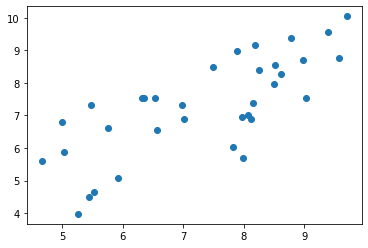

In [71]:
import matplotlib.pyplot as plt
plt.scatter(y_pred_mlp,y_test)

In [72]:
sk.metrics.mean_squared_error(y_pred_mlp,y_test)

1.0807633675129737

# Read in USGS data 

In [210]:
count=0
df_gw=[]

with open('/Users/marcberghouse/test.csv', newline = '') as data:                                                                                          
    data_reader = csv.reader(data, delimiter='\t')
    for row in data_reader:
        count=count+1
        if count>1953:
            df_gw.append([row[6],row[1],row[3]])
            print(row)

['USGS', '351651114440601', 'GW', '2013-03-05', '21:53', 'UTC', '27.20', '', '', '1', 'USGS', 'm', '', 'S', 'S', 'A']
['USGS', '351712114441201', 'GW', '2013-03-05', '22:09', 'UTC', '47.57', '', '', '1', 'USGS', 'm', '', 'S', 'S', 'A']
['USGS', '351741114442001', 'GW', '2013-03-05', '22:19', 'UTC', '70.44', '', '', '1', 'USGS', 'm', '', 'S', 'S', 'A']
['USGS', '354709115220001', 'GW', '2013-09-24', '17:00', 'UTC', '586.19', '', '', '1', 'USGS', 'm', '', 'S', 'O', 'A']
['USGS', '354849115225001', 'GW', '2012-05-03', '', 'UTC', '905.00', '', '', '1', '', 'D', '', '', 'O', 'A']
['USGS', '354849115225001', 'GW', '2012-09-26', '18:00', 'UTC', '871.14', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '354849115225001', 'GW', '2012-12-14', '17:42', 'UTC', '875.04', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '354849115225001', 'GW', '2013-02-22', '20:10', 'UTC', '871.64', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '354849115225001', 'GW', '2013-07-18', '15:35', 'UTC', 

['USGS', '362454115270201', 'GW', '2019-11-18', '16:27', 'UTC', '598.47', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '362454115270201', 'GW', '2020-08-05', '15:10', 'UTC', '598.48', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '362505116223001', 'GW', '2011-01-04', '22:25', 'UTC', '12.99', '', '', '1', 'NV090', 'm', '', 'A', 'S', 'A']
['USGS', '362505116223001', 'GW', '2011-01-11', '20:30', 'UTC', '12.92', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '362505116223001', 'GW', '2011-02-28', '22:20', 'UTC', '12.76', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '362505116223001', 'GW', '2011-04-06', '19:07', 'UTC', '12.67', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '362505116223001', 'GW', '2011-06-27', '19:37', 'UTC', '12.83', '', '', '1', 'NV090', 'm', '', 'A', 'V', 'A']
['USGS', '362505116223001', 'GW', '2011-08-23', '19:51', 'UTC', '13.10', '', '', '1', 'NV090', 'm', '', 'A', 'V', 'A']
['USGS', '362505116223001', 'GW', '2011-10-25', '18

['USGS', '363830116241401', 'GW', '2015-05-14', '16:35', 'UTC', '327.46', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363830116241401', 'GW', '2015-07-13', '22:55', 'UTC', '327.44', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363830116241401', 'GW', '2015-09-30', '22:15', 'UTC', '327.54', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363830116241401', 'GW', '2015-11-11', '19:46', 'UTC', '327.88', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363905116005801', 'GW', '2011-03-21', '20:18', 'UTC', '1163.50', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363905116005801', 'GW', '2011-06-14', '22:25', 'UTC', '1163.77', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363905116005801', 'GW', '2011-09-13', '14:20', 'UTC', '1163.79', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363905116005801', 'GW', '2011-11-16', '16:18', 'UTC', '1163.89', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '363905116005801', 'GW', '2012-03-1

['USGS', '364927115574802', 'GW-TH', '2014-12-29', '17:35', 'UTC', '650.17', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2015-03-16', '19:11', 'UTC', '650.10', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2015-06-08', '20:42', 'UTC', '650.00', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2015-08-10', '19:48', 'UTC', '649.94', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2015-10-20', '16:10', 'UTC', '649.89', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2016-03-07', '18:32', 'UTC', '649.78', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2016-06-06', '18:12', 'UTC', '649.84', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-TH', '2016-08-15', '17:37', 'UTC', '649.99', '', '', '', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '364927115574802', 'GW-

['USGS', '370254116064201', 'GW-TH', '2014-06-12', '18:46', 'UTC', '644.37', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2014-09-15', '20:03', 'UTC', '644.50', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2014-12-10', '20:48', 'UTC', '644.51', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2015-02-10', '17:57', 'UTC', '644.57', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2015-06-11', '15:34', 'UTC', '644.39', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2015-08-20', '20:57', 'UTC', '644.34', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2015-10-13', '15:46', 'UTC', '644.62', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '370254116064201', 'GW-TH', '2016-01-13', '19:00', 'UTC', '644.56', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '37025411606420

['USGS', '371135116282604', 'GW', '2018-04-23', '22:58', 'UTC', '1667.23', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2018-07-12', '16:27', 'UTC', '1667.33', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2018-10-10', '18:50', 'UTC', '1667.17', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2019-02-27', '20:50', 'UTC', '1667.23', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2019-05-08', '18:23', 'UTC', '1667.28', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2019-07-25', '18:02', 'UTC', '1667.35', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2019-10-07', '18:40', 'UTC', '1667.38', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2020-01-27', '22:36', 'UTC', '1667.49', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '371135116282604', 'GW', '2020-

['USGS', '380758115204601', 'GW', '2012-04-19', '21:15', 'UTC', '795.10', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2012-05-11', '00:00', 'UTC', '794.89', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2012-07-19', '16:45', 'UTC', '795.18', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2012-09-21', '17:30', 'UTC', '795.14', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2012-10-25', '17:45', 'UTC', '795.26', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2012-12-12', '17:45', 'UTC', '799.61', '', '', 'P', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2013-02-13', '17:45', 'UTC', '795.31', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2013-05-02', '17:45', 'UTC', '795.48', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '380758115204601', 'GW', '2013-07-16', 

['USGS', '385637119503701', 'GW', '2014-02-25', '18:27', 'UTC', '28.13', '', '', '1', '', 'm', '', '', 'T', 'A']
['USGS', '385637119503701', 'GW', '2014-06-10', '20:14', 'UTC', '30.28', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2014-09-24', '20:09', 'UTC', '34.62', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2014-12-24', '16:56', 'UTC', '31.64', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2015-03-18', '17:32', 'UTC', '29.51', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2015-06-10', '19:57', 'UTC', '31.27', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2015-09-22', '17:23', 'UTC', '35.62', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2015-12-18', '20:52', 'UTC', '32.47', '', '', '1', '', 'm', '', '', 'V', 'A']
['USGS', '385637119503701', 'GW', '2016-03-23', '19:01', 'UTC', '30.42', '', '', '1', '', 'm', '

['USGS', '391023119422101', 'GW', '2015-02-24', '18:40', 'UTC', '8.98', '', '', '1', 'USGS', 'm', '', 'S', 'T', 'A']
['USGS', '391023119422101', 'GW', '2015-03-19', '17:30', 'UTC', '8.92', '', '', '1', 'USGS', 'm', '', 'S', 'T', 'A']
['USGS', '391023119422101', 'GW', '2015-04-02', '16:44', 'UTC', '9.65', '', '', '1', 'USGS', 'm', '', 'S', 'T', 'A']
['USGS', '391023119422101', 'GW', '2015-06-19', '20:54', 'UTC', '10.16', '', '', '1', 'USGS', 'm', '', 'S', 'T', 'A']
['USGS', '391023119422101', 'GW', '2015-07-13', '20:34', 'UTC', '10.31', '', '', '1', 'USGS', 'm', '', 'S', 'T', 'A']
['USGS', '391023119422101', 'GW', '2015-08-24', '19:24', 'UTC', '10.94', '', '', '1', 'USGS', 'm', '', 'S', 'T', 'A']
['USGS', '391023119422101', 'GW', '2015-09-30', '20:30', 'UTC', '11.33', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391023119422101', 'GW', '2015-10-30', '22:52', 'UTC', '10.67', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391023119422101', 'GW', '2015-11-30', '20:34', 'U

['USGS', '391824119331001', 'GW', '2019-06-14', '20:40', 'UTC', '152.44', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2019-07-16', '19:29', 'UTC', '152.33', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2019-09-24', '21:26', 'UTC', '152.95', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2019-10-15', '20:18', 'UTC', '153.31', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2019-12-03', '22:55', 'UTC', '153.42', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2019-12-31', '17:22', 'UTC', '153.45', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2020-01-29', '18:01', 'UTC', '153.11', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2020-01-31', '19:00', 'UTC', '153.10', '', '', '1', 'USGS', 'm', '', 'S', 'V', 'A']
['USGS', '391824119331001', 'GW', '2020-03-09', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [211]:
count=0
df_site=[]

with open('/Users/marcberghouse/test_site.csv', newline = '') as data:                                                                                          
    data_reader = csv.reader(data, delimiter='\t')
    for row in data_reader:
        count=count+1
        if count>31:
            df_site.append([row[1],row[4],row[5]])
            print(row)

['USGS', '350959114425001', '213  S32 E65 15ABAD1    FIAPOS', 'GW', '35.1664872', '-114.7145862', 'H', 'NAD83', ' 2402.0', '0.1', 'NGVD29', '15030101']
['USGS', '351651114440601', '213  S31 E65 04ABCC1', 'GW', '35.2807878', '-114.7358211', 'H', 'NAD83', ' 3271.3', '0.1', 'NGVD29', '15030101']
['USGS', '351712114441201', '213  S30 E65 33CDAD1    JE-2', 'GW', '35.28651548', '-114.7373518', 'H', 'NAD83', ' 3124.5', '0.1', 'NGVD29', '15030101']
['USGS', '351741114442001', '213  S30 E65 33BDAB1    JE-1', 'GW', '35.29481389', '-114.7388083', '5', 'NAD83', ' 2902.', ' 20', 'NGVD29', '15030101']
['USGS', '354708115212501', '164A S25 E59 10CBAD1    J4', 'GW', '35.78566667', '-115.3569333', '5', 'NAD83', ' 3023.', ' 20', 'NGVD29', '16060015']
['USGS', '354709115220001', '164A S25 E59 09DBDA1    JGOLD', 'GW', '35.78479167', '-115.366511', '5', 'NAD83', ' 3073.', '20.', 'NGVD29', '16060015']
['USGS', '354849115225001', '164A S24 E59 32DACD1    IVPH-01', 'GW', '35.81379167', '-115.3803972', 'S', 'N

In [174]:
df_site

[['350959114425001', '35.1664872', '-114.7145862'],
 ['351651114440601', '35.2807878', '-114.7358211'],
 ['351712114441201', '35.28651548', '-114.7373518'],
 ['351741114442001', '35.29481389', '-114.7388083'],
 ['354708115212501', '35.78566667', '-115.3569333'],
 ['354709115220001', '35.78479167', '-115.366511'],
 ['354849115225001', '35.81379167', '-115.3803972'],
 ['355036114572501', '35.8363706', '-114.9691527'],
 ['355941115490901', '35.994625', '-115.8198972'],
 ['360002115103801', '36.00052976', '-115.1780509'],
 ['360016115361501', '36.00429167', '-115.6040694'],
 ['360017115460401', '36.0047972', '-115.7680278'],
 ['360053115512601', '36.0148', '-115.857736'],
 ['360112115104301', '36.01997368', '-115.1794405'],
 ['360222115024301', '36.03956716', '-115.0460301'],
 ['360318115251001', '36.0549361', '-115.419361'],
 ['360332115254501', '36.0589361', '-115.4294417'],
 ['360349115100001', '36.06608374', '-115.171942'],
 ['360354115261601', '36.0648972', '-115.4378667'],
 ['3603591

In [212]:
arr_site=np.array(df_site)
arr_gw=np.array(df_gw)

new_col = np.empty((len(arr_gw),1))
new_col.fill(np.nan)
new_col

arr2=np.concatenate((arr_gw,new_col),axis=1)
arr_final=np.concatenate((arr2,new_col),axis=1)
arr_final

count=0
for i in np.unique(arr_site[:,0]):
    try:
        idx=np.where(arr_gw[:,1]==i)
    except:
        print ('error')
    arr_final[idx,3]=arr_site[count,1]
    arr_final[idx,4]=arr_site[count,2]
    print (idx)
    count=count+1

In [213]:
# new_col = np.empty((len(arr_gw),1))
# new_col.fill(np.nan)
# new_col

array([[nan],
       [nan],
       [nan],
       ...,
       [nan],
       [nan],
       [nan]])

In [315]:
# arr2=np.concatenate((arr_gw,new_col),axis=1)
# arr_final=np.concatenate((arr2,new_col),axis=1)
# arr_final

array([['27.20', '351651114440601', '2013-03-05', 'nan', 'nan'],
       ['47.57', '351712114441201', '2013-03-05', 'nan', 'nan'],
       ['70.44', '351741114442001', '2013-03-05', 'nan', 'nan'],
       ...,
       ['21.57', '413444114261701', '2016-04-13', 'nan', 'nan'],
       ['6.27', '413444114261701', '2017-05-03', 'nan', 'nan'],
       ['11.99', '413444114261701', '2018-03-14', 'nan', 'nan']],
      dtype='<U32')

In [316]:
# count=0
# for i in np.unique(arr_site[:,0]):
#     try:
#         idx=np.where(arr_gw[:,1]==i)
#     except:
#         print ('error')
#     arr_final[idx,3]=arr_site[count,1]
#     arr_final[idx,4]=arr_site[count,2]
#     print (idx)
#     count=count+1

(array([], dtype=int64),)
(array([0]),)
(array([1]),)
(array([2]),)
(array([], dtype=int64),)
(array([3]),)
(array([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),)
(array([14]),)
(array([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
       32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48,
       49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),)
(array([61]),)
(array([ 62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,
        75,  76,  77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,
        88,  89,  90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100]),)
(array([101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126,
       127, 128, 129]),)
(array([130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157]),)
(array([158]),)
(array([159, 160, 161, 162]),)


(array([14749, 14750, 14751, 14752, 14753, 14754, 14755, 14756, 14757,
       14758, 14759, 14760, 14761, 14762, 14763, 14764, 14765, 14766]),)
(array([14767]),)
(array([14768]),)
(array([14769]),)
(array([14770]),)
(array([14771]),)
(array([14772]),)
(array([14773, 14774, 14775, 14776, 14777, 14778, 14779, 14780, 14781,
       14782, 14783, 14784, 14785, 14786, 14787, 14788, 14789, 14790,
       14791, 14792, 14793, 14794, 14795, 14796, 14797, 14798, 14799,
       14800, 14801, 14802, 14803, 14804, 14805, 14806, 14807, 14808,
       14809, 14810, 14811, 14812, 14813, 14814, 14815, 14816, 14817,
       14818, 14819, 14820, 14821, 14822, 14823, 14824, 14825, 14826,
       14827, 14828, 14829, 14830, 14831, 14832, 14833, 14834, 14835,
       14836, 14837, 14838, 14839, 14840, 14841, 14842, 14843, 14844,
       14845, 14846, 14847, 14848, 14849, 14850, 14851, 14852, 14853]),)
(array([14854]),)
(array([14855]),)
(array([14856]),)
(array([14857, 14858, 14859, 14860, 14861, 14862, 14863, 148

(array([23100, 23101, 23102, 23103, 23104, 23105, 23106, 23107, 23108,
       23109, 23110, 23111, 23112]),)
(array([23113, 23114, 23115, 23116, 23117]),)
(array([23118, 23119, 23120]),)
(array([23121, 23122, 23123, 23124, 23125, 23126, 23127, 23128, 23129]),)
(array([23130, 23131, 23132, 23133, 23134, 23135, 23136, 23137, 23138,
       23139, 23140, 23141, 23142, 23143]),)
(array([23144]),)
(array([23145, 23146, 23147, 23148]),)
(array([23149, 23150, 23151, 23152, 23153, 23154, 23155, 23156, 23157,
       23158, 23159, 23160, 23161, 23162, 23163, 23164, 23165, 23166,
       23167, 23168, 23169, 23170, 23171, 23172, 23173, 23174, 23175,
       23176, 23177, 23178, 23179, 23180, 23181, 23182, 23183, 23184,
       23185, 23186, 23187, 23188, 23189, 23190, 23191, 23192, 23193,
       23194, 23195, 23196, 23197, 23198, 23199, 23200, 23201, 23202,
       23203, 23204, 23205, 23206, 23207, 23208, 23209, 23210, 23211]),)
(array([23212, 23213]),)
(array([23214]),)
(array([23215, 23216, 23217, 

In [317]:
arr_final

array([['27.20', '351651114440601', '2013-03-05', '35.2807878',
        '-114.7358211'],
       ['47.57', '351712114441201', '2013-03-05', '35.28651548',
        '-114.7373518'],
       ['70.44', '351741114442001', '2013-03-05', '35.29481389',
        '-114.7388083'],
       ...,
       ['21.57', '413444114261701', '2016-04-13', '41.57891667',
        '-114.4389444'],
       ['6.27', '413444114261701', '2017-05-03', '41.57891667',
        '-114.4389444'],
       ['11.99', '413444114261701', '2018-03-14', '41.57891667',
        '-114.4389444']], dtype='<U32')

In [318]:
#dt=[]
for i in range(len(arr_final)):
    date=arr_final[i,2]
    year=float(date[0:4])
    month=float(date[5:7])
    day=float(date[8:10])
    arr_final[i,2]=(year-2010)*365+month*30+day
    for j in range(5):
        try:
            arr_final[i][j]=float(arr_final[i][j])
        except:
            arr_final[i][j]=0
    #dt.append((year-2010)*365+month*30+day)
    #print (dt)
    

In [319]:
arr_final.astype(float)


array([[ 2.72000000e+01,  3.51651114e+14,  1.19000000e+03,
         3.52807878e+01, -1.14735821e+02],
       [ 4.75700000e+01,  3.51712114e+14,  1.19000000e+03,
         3.52865155e+01, -1.14737352e+02],
       [ 7.04400000e+01,  3.51741114e+14,  1.19000000e+03,
         3.52948139e+01, -1.14738808e+02],
       ...,
       [ 2.15700000e+01,  4.13444114e+14,  2.32300000e+03,
         4.15789167e+01, -1.14438944e+02],
       [ 6.27000000e+00,  4.13444114e+14,  2.70800000e+03,
         4.15789167e+01, -1.14438944e+02],
       [ 1.19900000e+01,  4.13444114e+14,  3.02400000e+03,
         4.15789167e+01, -1.14438944e+02]])

In [273]:
np.count_nonzero(pd.isnull(arr_final))

0

In [274]:
pd.DataFrame(arr_final).to_csv('Desktop/NWIS_dataset_gw_level.csv')

In [320]:
x=arr_final[:,1:].astype(float)

y=arr_final[:,0].astype(float)


In [321]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [367]:
from sklearn.ensemble import RandomForestRegressor
regr_forest = make_pipeline(StandardScaler(),RandomForestRegressor(max_depth=12, random_state=0))
regr_forest.fit(X_train, y_train)
y_pred_forest=regr_forest.predict(X_test)
plt.scatter(y_pred_forest,y_test)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestregressor',
                 RandomForestRegressor(max_depth=12, random_state=0))])

In [368]:
y_pred_forest=regr_forest.predict(X_test)

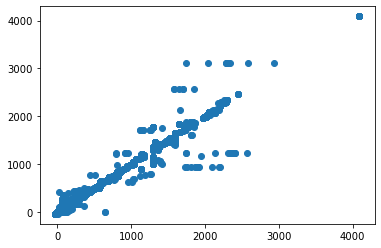

In [369]:
import matplotlib.pyplot as plt
plt.scatter(y_pred_forest,y_test)

In [370]:
np.sqrt(sk.metrics.mean_squared_error(y_pred_forest,y_test))

89.51891435972156

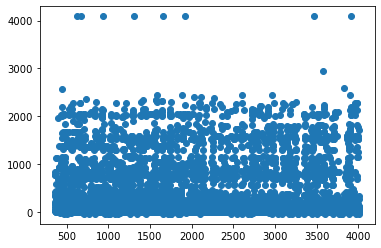

In [383]:
plt.scatter(X_test[:,1],y_pred_forest)
#plt.scatter(X_test[:,1],y_test)

In [374]:
X_test

array([[ 3.65212116e+14,  9.98000000e+02,  3.68700517e+01,
        -1.15931152e+02],
       [ 3.92927119e+14,  2.90500000e+03,  3.94904694e+01,
        -1.18841769e+02],
       [ 3.93316119e+14,  6.36000000e+02,  3.95545056e+01,
        -1.19477531e+02],
       ...,
       [ 3.60349115e+14,  3.18100000e+03,  3.60660837e+01,
        -1.15171942e+02],
       [ 3.64915116e+14,  3.98900000e+03,  3.68206737e+01,
        -1.15962311e+02],
       [ 3.92810118e+14,  2.37600000e+03,  3.94693417e+01,
        -1.18754956e+02]])

In [371]:
sk.metrics.r2_score(y_pred_forest,y_test)

0.9768704332304203

In [330]:
from sklearn.neural_network import MLPRegressor
regr_mlp = make_pipeline(StandardScaler(), MLPRegressor(learning_rate_init=3e-4,random_state=0, max_iter=100000,verbose=True,tol=1e-8))
regr_mlp.fit(X_train, y_train)

Iteration 1, loss = 238381.80491616
Iteration 2, loss = 237789.02315488
Iteration 3, loss = 236891.23676415
Iteration 4, loss = 235611.80075342
Iteration 5, loss = 233946.13688207
Iteration 6, loss = 231908.71784428
Iteration 7, loss = 229508.19392822
Iteration 8, loss = 226699.54571925
Iteration 9, loss = 223531.07286244
Iteration 10, loss = 220031.79836617
Iteration 11, loss = 216232.97070880
Iteration 12, loss = 212204.10113375
Iteration 13, loss = 207987.72693733
Iteration 14, loss = 203625.59369892
Iteration 15, loss = 199137.68971918
Iteration 16, loss = 194583.69272726
Iteration 17, loss = 190020.88049931
Iteration 18, loss = 185518.91107377
Iteration 19, loss = 181113.59059516
Iteration 20, loss = 176825.77854831
Iteration 21, loss = 172673.54676233
Iteration 22, loss = 168718.25384955
Iteration 23, loss = 164968.08948470
Iteration 24, loss = 161424.08239711
Iteration 25, loss = 158133.21850496
Iteration 26, loss = 155093.39860828
Iteration 27, loss = 152324.82388394
Iteration 

Iteration 225, loss = 78517.93482393
Iteration 226, loss = 78327.62299143
Iteration 227, loss = 78135.96521866
Iteration 228, loss = 77950.60609445
Iteration 229, loss = 77771.09516381
Iteration 230, loss = 77587.78462403
Iteration 231, loss = 77410.00620597
Iteration 232, loss = 77228.86499594
Iteration 233, loss = 77053.33631675
Iteration 234, loss = 76882.32870443
Iteration 235, loss = 76705.68124891
Iteration 236, loss = 76533.94532367
Iteration 237, loss = 76369.42017740
Iteration 238, loss = 76204.06061447
Iteration 239, loss = 76043.80708225
Iteration 240, loss = 75881.34345778
Iteration 241, loss = 75725.79781206
Iteration 242, loss = 75570.38181301
Iteration 243, loss = 75414.82745000
Iteration 244, loss = 75260.01210393
Iteration 245, loss = 75108.82204890
Iteration 246, loss = 74962.84955968
Iteration 247, loss = 74813.31085696
Iteration 248, loss = 74671.42523173
Iteration 249, loss = 74527.44596571
Iteration 250, loss = 74385.86418170
Iteration 251, loss = 74245.89647095
I

Iteration 450, loss = 62999.81915595
Iteration 451, loss = 62988.12476988
Iteration 452, loss = 62979.23749673
Iteration 453, loss = 62961.39809386
Iteration 454, loss = 62949.70247795
Iteration 455, loss = 62939.40819081
Iteration 456, loss = 62927.12642967
Iteration 457, loss = 62916.25337075
Iteration 458, loss = 62902.70773120
Iteration 459, loss = 62892.10056200
Iteration 460, loss = 62880.58086124
Iteration 461, loss = 62871.11562384
Iteration 462, loss = 62859.27463206
Iteration 463, loss = 62848.14805004
Iteration 464, loss = 62836.57448816
Iteration 465, loss = 62827.28932590
Iteration 466, loss = 62816.04509917
Iteration 467, loss = 62805.89196481
Iteration 468, loss = 62795.23702852
Iteration 469, loss = 62789.63730974
Iteration 470, loss = 62775.08448818
Iteration 471, loss = 62769.67583804
Iteration 472, loss = 62756.35180741
Iteration 473, loss = 62746.80822708
Iteration 474, loss = 62738.41485268
Iteration 475, loss = 62728.71844923
Iteration 476, loss = 62719.29516847
I

Iteration 674, loss = 61657.77277070
Iteration 675, loss = 61657.58619793
Iteration 676, loss = 61653.18418319
Iteration 677, loss = 61649.26057848
Iteration 678, loss = 61648.22092404
Iteration 679, loss = 61644.80054323
Iteration 680, loss = 61641.62302035
Iteration 681, loss = 61636.92181627
Iteration 682, loss = 61636.04657062
Iteration 683, loss = 61628.75565742
Iteration 684, loss = 61627.46327592
Iteration 685, loss = 61627.06417173
Iteration 686, loss = 61622.63772321
Iteration 687, loss = 61621.14806881
Iteration 688, loss = 61618.40147748
Iteration 689, loss = 61612.64237240
Iteration 690, loss = 61611.25520792
Iteration 691, loss = 61609.37125760
Iteration 692, loss = 61604.37394338
Iteration 693, loss = 61603.72286737
Iteration 694, loss = 61599.68193365
Iteration 695, loss = 61596.98487460
Iteration 696, loss = 61593.90204118
Iteration 697, loss = 61591.70460574
Iteration 698, loss = 61593.28168394
Iteration 699, loss = 61586.94251243
Iteration 700, loss = 61583.73682802
I

Iteration 900, loss = 60758.85236742
Iteration 901, loss = 60749.18665032
Iteration 902, loss = 60742.69049199
Iteration 903, loss = 60744.19837558
Iteration 904, loss = 60737.81896819
Iteration 905, loss = 60731.05546776
Iteration 906, loss = 60729.47543217
Iteration 907, loss = 60727.19940915
Iteration 908, loss = 60722.16080906
Iteration 909, loss = 60714.48051901
Iteration 910, loss = 60719.04555329
Iteration 911, loss = 60707.38449142
Iteration 912, loss = 60703.88350922
Iteration 913, loss = 60698.32150394
Iteration 914, loss = 60697.34731387
Iteration 915, loss = 60694.18195123
Iteration 916, loss = 60688.46925250
Iteration 917, loss = 60685.94574808
Iteration 918, loss = 60685.81965311
Iteration 919, loss = 60678.73619167
Iteration 920, loss = 60676.19168670
Iteration 921, loss = 60669.96036409
Iteration 922, loss = 60667.62245223
Iteration 923, loss = 60658.39890866
Iteration 924, loss = 60658.12923576
Iteration 925, loss = 60653.07424084
Iteration 926, loss = 60651.46562087
I

Iteration 1119, loss = 59963.31962036
Iteration 1120, loss = 59959.18613529
Iteration 1121, loss = 59950.83938912
Iteration 1122, loss = 59951.04830617
Iteration 1123, loss = 59947.17488331
Iteration 1124, loss = 59944.35082822
Iteration 1125, loss = 59940.07035026
Iteration 1126, loss = 59936.62193220
Iteration 1127, loss = 59933.01551650
Iteration 1128, loss = 59929.36748572
Iteration 1129, loss = 59927.38803250
Iteration 1130, loss = 59926.11520512
Iteration 1131, loss = 59925.21518782
Iteration 1132, loss = 59920.19212498
Iteration 1133, loss = 59919.23773599
Iteration 1134, loss = 59914.46050242
Iteration 1135, loss = 59912.29885871
Iteration 1136, loss = 59909.50673596
Iteration 1137, loss = 59910.47582269
Iteration 1138, loss = 59906.22303013
Iteration 1139, loss = 59900.33864053
Iteration 1140, loss = 59900.77344810
Iteration 1141, loss = 59896.37191385
Iteration 1142, loss = 59892.17780822
Iteration 1143, loss = 59892.26918909
Iteration 1144, loss = 59887.42766037
Iteration 11

Iteration 1339, loss = 59497.18686380
Iteration 1340, loss = 59493.49871661
Iteration 1341, loss = 59496.02474196
Iteration 1342, loss = 59491.55612539
Iteration 1343, loss = 59489.62481146
Iteration 1344, loss = 59487.63234478
Iteration 1345, loss = 59489.98847784
Iteration 1346, loss = 59486.15269996
Iteration 1347, loss = 59480.65495319
Iteration 1348, loss = 59479.26318012
Iteration 1349, loss = 59478.16558209
Iteration 1350, loss = 59475.40678881
Iteration 1351, loss = 59474.75288357
Iteration 1352, loss = 59471.87352039
Iteration 1353, loss = 59466.01341203
Iteration 1354, loss = 59469.71169730
Iteration 1355, loss = 59465.18778944
Iteration 1356, loss = 59467.60641197
Iteration 1357, loss = 59464.71119811
Iteration 1358, loss = 59462.33196243
Iteration 1359, loss = 59461.15002738
Iteration 1360, loss = 59458.99672287
Iteration 1361, loss = 59455.52578574
Iteration 1362, loss = 59457.00058165
Iteration 1363, loss = 59453.38616723
Iteration 1364, loss = 59452.32095557
Iteration 13

Iteration 1559, loss = 59130.37993715
Iteration 1560, loss = 59127.37210952
Iteration 1561, loss = 59124.56442175
Iteration 1562, loss = 59123.75756006
Iteration 1563, loss = 59125.10288021
Iteration 1564, loss = 59122.07421643
Iteration 1565, loss = 59120.70937793
Iteration 1566, loss = 59119.41504841
Iteration 1567, loss = 59119.35415763
Iteration 1568, loss = 59112.85648229
Iteration 1569, loss = 59113.69227587
Iteration 1570, loss = 59109.68273153
Iteration 1571, loss = 59111.82842276
Iteration 1572, loss = 59109.28545851
Iteration 1573, loss = 59106.89126868
Iteration 1574, loss = 59110.25794416
Iteration 1575, loss = 59104.87364630
Iteration 1576, loss = 59105.62979580
Iteration 1577, loss = 59101.44789092
Iteration 1578, loss = 59102.21355411
Iteration 1579, loss = 59098.22592344
Iteration 1580, loss = 59097.88444108
Iteration 1581, loss = 59096.21637418
Iteration 1582, loss = 59094.49058871
Iteration 1583, loss = 59092.50710368
Iteration 1584, loss = 59091.98248104
Iteration 15

Iteration 1778, loss = 58798.91451898
Iteration 1779, loss = 58794.16390052
Iteration 1780, loss = 58793.54480792
Iteration 1781, loss = 58792.51219549
Iteration 1782, loss = 58794.08205402
Iteration 1783, loss = 58793.66767311
Iteration 1784, loss = 58790.47257323
Iteration 1785, loss = 58788.65156038
Iteration 1786, loss = 58785.41412463
Iteration 1787, loss = 58784.18155950
Iteration 1788, loss = 58783.66341525
Iteration 1789, loss = 58786.06609465
Iteration 1790, loss = 58779.85049303
Iteration 1791, loss = 58777.73151169
Iteration 1792, loss = 58778.94439320
Iteration 1793, loss = 58779.38138648
Iteration 1794, loss = 58777.34418257
Iteration 1795, loss = 58776.69167625
Iteration 1796, loss = 58774.95745749
Iteration 1797, loss = 58770.09117909
Iteration 1798, loss = 58768.82316488
Iteration 1799, loss = 58767.30698244
Iteration 1800, loss = 58771.84954263
Iteration 1801, loss = 58767.45343422
Iteration 1802, loss = 58766.12975702
Iteration 1803, loss = 58764.33257200
Iteration 18

Iteration 1997, loss = 58529.58254506
Iteration 1998, loss = 58525.78430249
Iteration 1999, loss = 58523.37245641
Iteration 2000, loss = 58524.44064727
Iteration 2001, loss = 58521.65458596
Iteration 2002, loss = 58519.62911543
Iteration 2003, loss = 58517.72605174
Iteration 2004, loss = 58516.81134242
Iteration 2005, loss = 58515.55725545
Iteration 2006, loss = 58519.93162376
Iteration 2007, loss = 58513.54872987
Iteration 2008, loss = 58519.54838156
Iteration 2009, loss = 58512.50675677
Iteration 2010, loss = 58509.53288232
Iteration 2011, loss = 58512.60319650
Iteration 2012, loss = 58509.29022016
Iteration 2013, loss = 58507.17198386
Iteration 2014, loss = 58506.07029404
Iteration 2015, loss = 58506.22798494
Iteration 2016, loss = 58507.22006174
Iteration 2017, loss = 58502.69168041
Iteration 2018, loss = 58502.35084462
Iteration 2019, loss = 58501.36186560
Iteration 2020, loss = 58499.59268149
Iteration 2021, loss = 58496.91029526
Iteration 2022, loss = 58497.26933190
Iteration 20

Iteration 2215, loss = 58276.15769135
Iteration 2216, loss = 58275.86356345
Iteration 2217, loss = 58273.70395007
Iteration 2218, loss = 58277.87169805
Iteration 2219, loss = 58273.93652852
Iteration 2220, loss = 58270.13912968
Iteration 2221, loss = 58272.31214713
Iteration 2222, loss = 58271.19638975
Iteration 2223, loss = 58269.04401491
Iteration 2224, loss = 58267.78707098
Iteration 2225, loss = 58266.83504469
Iteration 2226, loss = 58264.58173356
Iteration 2227, loss = 58265.19530841
Iteration 2228, loss = 58260.86527773
Iteration 2229, loss = 58261.52561352
Iteration 2230, loss = 58264.02848525
Iteration 2231, loss = 58261.08043179
Iteration 2232, loss = 58260.46488522
Iteration 2233, loss = 58255.56137771
Iteration 2234, loss = 58255.15278642
Iteration 2235, loss = 58255.85716302
Iteration 2236, loss = 58251.96844310
Iteration 2237, loss = 58253.84708342
Iteration 2238, loss = 58254.48782141
Iteration 2239, loss = 58250.49813755
Iteration 2240, loss = 58251.40294864
Iteration 22

Iteration 2435, loss = 58042.14790601
Iteration 2436, loss = 58040.60580210
Iteration 2437, loss = 58037.22998986
Iteration 2438, loss = 58038.14444520
Iteration 2439, loss = 58036.09090348
Iteration 2440, loss = 58036.07738763
Iteration 2441, loss = 58035.90554694
Iteration 2442, loss = 58036.07429130
Iteration 2443, loss = 58033.59422566
Iteration 2444, loss = 58032.69974884
Iteration 2445, loss = 58032.73682314
Iteration 2446, loss = 58029.98546851
Iteration 2447, loss = 58028.96840731
Iteration 2448, loss = 58027.22779251
Iteration 2449, loss = 58027.23606238
Iteration 2450, loss = 58027.55845585
Iteration 2451, loss = 58022.45647088
Iteration 2452, loss = 58023.77595103
Iteration 2453, loss = 58021.16682833
Iteration 2454, loss = 58020.62069578
Iteration 2455, loss = 58017.88493718
Iteration 2456, loss = 58020.47167386
Iteration 2457, loss = 58017.00157890
Iteration 2458, loss = 58016.21816070
Iteration 2459, loss = 58022.62450707
Iteration 2460, loss = 58013.31250155
Iteration 24

Iteration 2654, loss = 57814.50040655
Iteration 2655, loss = 57814.43309080
Iteration 2656, loss = 57816.45953663
Iteration 2657, loss = 57811.97547012
Iteration 2658, loss = 57815.46150161
Iteration 2659, loss = 57811.72089545
Iteration 2660, loss = 57810.26751027
Iteration 2661, loss = 57815.29382048
Iteration 2662, loss = 57808.53247914
Iteration 2663, loss = 57806.89189204
Iteration 2664, loss = 57804.96086958
Iteration 2665, loss = 57803.19379316
Iteration 2666, loss = 57803.17370033
Iteration 2667, loss = 57801.42283160
Iteration 2668, loss = 57803.83886477
Iteration 2669, loss = 57801.86450785
Iteration 2670, loss = 57800.57874314
Iteration 2671, loss = 57802.54885360
Iteration 2672, loss = 57798.00304124
Iteration 2673, loss = 57796.76563929
Iteration 2674, loss = 57798.42767761
Iteration 2675, loss = 57795.51688806
Iteration 2676, loss = 57793.12150646
Iteration 2677, loss = 57794.56856224
Iteration 2678, loss = 57795.14432642
Iteration 2679, loss = 57790.70585740
Iteration 26

Iteration 2871, loss = 57595.82862549
Iteration 2872, loss = 57600.33290276
Iteration 2873, loss = 57594.11861972
Iteration 2874, loss = 57590.41671513
Iteration 2875, loss = 57591.67046270
Iteration 2876, loss = 57592.35300357
Iteration 2877, loss = 57589.44601872
Iteration 2878, loss = 57588.53174472
Iteration 2879, loss = 57588.40230545
Iteration 2880, loss = 57586.28644678
Iteration 2881, loss = 57587.12289979
Iteration 2882, loss = 57589.30187242
Iteration 2883, loss = 57581.99356131
Iteration 2884, loss = 57579.86386397
Iteration 2885, loss = 57579.03751312
Iteration 2886, loss = 57587.06746412
Iteration 2887, loss = 57578.50988391
Iteration 2888, loss = 57579.24476489
Iteration 2889, loss = 57577.55197265
Iteration 2890, loss = 57577.88545133
Iteration 2891, loss = 57575.10683473
Iteration 2892, loss = 57577.30881361
Iteration 2893, loss = 57573.60417901
Iteration 2894, loss = 57573.91402680
Iteration 2895, loss = 57570.32676064
Iteration 2896, loss = 57568.65083216
Iteration 28

Iteration 3089, loss = 57373.87958992
Iteration 3090, loss = 57372.89337420
Iteration 3091, loss = 57375.35388579
Iteration 3092, loss = 57371.32611359
Iteration 3093, loss = 57366.64825172
Iteration 3094, loss = 57366.86266737
Iteration 3095, loss = 57367.45449336
Iteration 3096, loss = 57370.09626561
Iteration 3097, loss = 57363.68682171
Iteration 3098, loss = 57365.28245506
Iteration 3099, loss = 57364.04809426
Iteration 3100, loss = 57361.46254150
Iteration 3101, loss = 57362.01707802
Iteration 3102, loss = 57360.04962974
Iteration 3103, loss = 57359.40489379
Iteration 3104, loss = 57356.93657796
Iteration 3105, loss = 57360.09966322
Iteration 3106, loss = 57358.29769295
Iteration 3107, loss = 57354.33692880
Iteration 3108, loss = 57357.48775110
Iteration 3109, loss = 57354.72812360
Iteration 3110, loss = 57354.26995575
Iteration 3111, loss = 57355.44076032
Iteration 3112, loss = 57350.74147898
Iteration 3113, loss = 57348.05072659
Iteration 3114, loss = 57348.23547236
Iteration 31

Iteration 3308, loss = 57151.94137081
Iteration 3309, loss = 57150.50487030
Iteration 3310, loss = 57154.05476253
Iteration 3311, loss = 57148.70133426
Iteration 3312, loss = 57147.65935632
Iteration 3313, loss = 57145.88919621
Iteration 3314, loss = 57147.08527730
Iteration 3315, loss = 57147.71888124
Iteration 3316, loss = 57145.49322807
Iteration 3317, loss = 57146.05332862
Iteration 3318, loss = 57139.66608964
Iteration 3319, loss = 57140.45366472
Iteration 3320, loss = 57142.49802374
Iteration 3321, loss = 57141.82048815
Iteration 3322, loss = 57137.79174756
Iteration 3323, loss = 57140.18598445
Iteration 3324, loss = 57139.67690710
Iteration 3325, loss = 57134.92108929
Iteration 3326, loss = 57135.90800386
Iteration 3327, loss = 57134.52171113
Iteration 3328, loss = 57136.18007008
Iteration 3329, loss = 57136.48108901
Iteration 3330, loss = 57127.78167305
Iteration 3331, loss = 57128.19462472
Iteration 3332, loss = 57127.48416947
Iteration 3333, loss = 57125.07532652
Iteration 33

Iteration 3528, loss = 56928.73180358
Iteration 3529, loss = 56925.53491072
Iteration 3530, loss = 56924.43515733
Iteration 3531, loss = 56923.59771582
Iteration 3532, loss = 56924.24718688
Iteration 3533, loss = 56922.50465261
Iteration 3534, loss = 56920.67945246
Iteration 3535, loss = 56919.44928160
Iteration 3536, loss = 56920.38726880
Iteration 3537, loss = 56923.34547545
Iteration 3538, loss = 56915.99001343
Iteration 3539, loss = 56915.97052210
Iteration 3540, loss = 56912.71208767
Iteration 3541, loss = 56914.59580543
Iteration 3542, loss = 56913.19752775
Iteration 3543, loss = 56911.95444903
Iteration 3544, loss = 56909.39554129
Iteration 3545, loss = 56911.19074968
Iteration 3546, loss = 56907.25740238
Iteration 3547, loss = 56908.55620388
Iteration 3548, loss = 56909.68583731
Iteration 3549, loss = 56906.86121660
Iteration 3550, loss = 56905.09076654
Iteration 3551, loss = 56905.22965178
Iteration 3552, loss = 56906.40705868
Iteration 3553, loss = 56902.82615517
Iteration 35

Iteration 3744, loss = 56712.71878959
Iteration 3745, loss = 56706.15646489
Iteration 3746, loss = 56705.99566141
Iteration 3747, loss = 56702.71898512
Iteration 3748, loss = 56701.91267890
Iteration 3749, loss = 56702.08568777
Iteration 3750, loss = 56700.51504187
Iteration 3751, loss = 56699.72507541
Iteration 3752, loss = 56698.81660763
Iteration 3753, loss = 56697.61858590
Iteration 3754, loss = 56696.25408866
Iteration 3755, loss = 56697.01046105
Iteration 3756, loss = 56696.20020638
Iteration 3757, loss = 56694.07861485
Iteration 3758, loss = 56691.86341265
Iteration 3759, loss = 56690.65597452
Iteration 3760, loss = 56692.90478161
Iteration 3761, loss = 56690.17010844
Iteration 3762, loss = 56689.19177217
Iteration 3763, loss = 56694.25504066
Iteration 3764, loss = 56688.42692715
Iteration 3765, loss = 56687.36719264
Iteration 3766, loss = 56687.55435228
Iteration 3767, loss = 56688.80122638
Iteration 3768, loss = 56680.68143307
Iteration 3769, loss = 56683.52591022
Iteration 37

Iteration 3960, loss = 56484.75496566
Iteration 3961, loss = 56484.29335683
Iteration 3962, loss = 56483.60359117
Iteration 3963, loss = 56485.01692028
Iteration 3964, loss = 56480.86250305
Iteration 3965, loss = 56479.59243780
Iteration 3966, loss = 56480.60241447
Iteration 3967, loss = 56478.95067910
Iteration 3968, loss = 56477.13523300
Iteration 3969, loss = 56482.04053948
Iteration 3970, loss = 56475.50043719
Iteration 3971, loss = 56477.19791724
Iteration 3972, loss = 56475.04737873
Iteration 3973, loss = 56474.25532819
Iteration 3974, loss = 56472.98432822
Iteration 3975, loss = 56481.38517062
Iteration 3976, loss = 56468.47147408
Iteration 3977, loss = 56468.86136508
Iteration 3978, loss = 56467.45281692
Iteration 3979, loss = 56468.20589920
Iteration 3980, loss = 56467.29352463
Iteration 3981, loss = 56463.05544492
Iteration 3982, loss = 56465.76652326
Iteration 3983, loss = 56461.38873253
Iteration 3984, loss = 56461.59957000
Iteration 3985, loss = 56461.55253141
Iteration 39

Iteration 4180, loss = 56260.91641177
Iteration 4181, loss = 56261.26504303
Iteration 4182, loss = 56257.84839192
Iteration 4183, loss = 56257.72362997
Iteration 4184, loss = 56255.86808812
Iteration 4185, loss = 56254.11592796
Iteration 4186, loss = 56255.35763874
Iteration 4187, loss = 56254.55085426
Iteration 4188, loss = 56254.38831296
Iteration 4189, loss = 56254.21997241
Iteration 4190, loss = 56251.57265606
Iteration 4191, loss = 56253.33230442
Iteration 4192, loss = 56248.32357321
Iteration 4193, loss = 56250.83345952
Iteration 4194, loss = 56248.08890505
Iteration 4195, loss = 56244.92705483
Iteration 4196, loss = 56247.10940179
Iteration 4197, loss = 56242.50584382
Iteration 4198, loss = 56244.04842268
Iteration 4199, loss = 56242.67629253
Iteration 4200, loss = 56243.91197954
Iteration 4201, loss = 56239.68908696
Iteration 4202, loss = 56240.46170608
Iteration 4203, loss = 56237.01112233
Iteration 4204, loss = 56236.58480826
Iteration 4205, loss = 56234.01766784
Iteration 42

Iteration 4397, loss = 56036.10934004
Iteration 4398, loss = 56037.63721437
Iteration 4399, loss = 56034.70343369
Iteration 4400, loss = 56035.56803805
Iteration 4401, loss = 56035.18031926
Iteration 4402, loss = 56031.76031250
Iteration 4403, loss = 56032.95745907
Iteration 4404, loss = 56028.64483084
Iteration 4405, loss = 56028.19090120
Iteration 4406, loss = 56038.15460695
Iteration 4407, loss = 56030.18970543
Iteration 4408, loss = 56026.54206596
Iteration 4409, loss = 56025.88435537
Iteration 4410, loss = 56023.56463623
Iteration 4411, loss = 56022.46121461
Iteration 4412, loss = 56023.04080657
Iteration 4413, loss = 56018.86900646
Iteration 4414, loss = 56019.47303151
Iteration 4415, loss = 56017.10435524
Iteration 4416, loss = 56018.45953890
Iteration 4417, loss = 56016.24694376
Iteration 4418, loss = 56018.52476930
Iteration 4419, loss = 56014.92275860
Iteration 4420, loss = 56013.46233245
Iteration 4421, loss = 56010.65004446
Iteration 4422, loss = 56012.09682256
Iteration 44

Iteration 4613, loss = 55815.36916721
Iteration 4614, loss = 55811.46947015
Iteration 4615, loss = 55814.19483246
Iteration 4616, loss = 55810.59399951
Iteration 4617, loss = 55809.93456801
Iteration 4618, loss = 55809.56867883
Iteration 4619, loss = 55808.54426809
Iteration 4620, loss = 55812.23038700
Iteration 4621, loss = 55804.45238951
Iteration 4622, loss = 55805.02434818
Iteration 4623, loss = 55802.38706482
Iteration 4624, loss = 55802.17936758
Iteration 4625, loss = 55801.24420400
Iteration 4626, loss = 55798.48721558
Iteration 4627, loss = 55802.01079717
Iteration 4628, loss = 55796.98725268
Iteration 4629, loss = 55796.79152228
Iteration 4630, loss = 55796.52105347
Iteration 4631, loss = 55799.91395885
Iteration 4632, loss = 55795.32546079
Iteration 4633, loss = 55792.39256313
Iteration 4634, loss = 55793.76024282
Iteration 4635, loss = 55791.97060128
Iteration 4636, loss = 55790.35099243
Iteration 4637, loss = 55794.00739818
Iteration 4638, loss = 55796.78098481
Iteration 46

Iteration 4829, loss = 55590.17429679
Iteration 4830, loss = 55592.00276795
Iteration 4831, loss = 55586.90683338
Iteration 4832, loss = 55585.37723476
Iteration 4833, loss = 55585.31898019
Iteration 4834, loss = 55583.93515696
Iteration 4835, loss = 55585.49012929
Iteration 4836, loss = 55582.97915831
Iteration 4837, loss = 55583.28851793
Iteration 4838, loss = 55583.65684507
Iteration 4839, loss = 55578.65170390
Iteration 4840, loss = 55580.20163741
Iteration 4841, loss = 55579.20721766
Iteration 4842, loss = 55576.36418884
Iteration 4843, loss = 55575.37565677
Iteration 4844, loss = 55574.17384015
Iteration 4845, loss = 55574.62238301
Iteration 4846, loss = 55572.09078957
Iteration 4847, loss = 55571.25927847
Iteration 4848, loss = 55573.59143293
Iteration 4849, loss = 55569.51725351
Iteration 4850, loss = 55564.73796399
Iteration 4851, loss = 55570.44466416
Iteration 4852, loss = 55568.79623381
Iteration 4853, loss = 55562.75354075
Iteration 4854, loss = 55564.12494657
Iteration 48

Iteration 5049, loss = 55361.82919262
Iteration 5050, loss = 55361.88811236
Iteration 5051, loss = 55358.97802145
Iteration 5052, loss = 55354.62210012
Iteration 5053, loss = 55355.50950377
Iteration 5054, loss = 55356.57426545
Iteration 5055, loss = 55353.02697411
Iteration 5056, loss = 55352.96871039
Iteration 5057, loss = 55352.45317486
Iteration 5058, loss = 55349.88219010
Iteration 5059, loss = 55348.10652905
Iteration 5060, loss = 55347.21714158
Iteration 5061, loss = 55347.11886846
Iteration 5062, loss = 55345.51183468
Iteration 5063, loss = 55348.45111659
Iteration 5064, loss = 55346.44642918
Iteration 5065, loss = 55347.61318618
Iteration 5066, loss = 55340.97524163
Iteration 5067, loss = 55340.86060645
Iteration 5068, loss = 55339.93317341
Iteration 5069, loss = 55337.78248249
Iteration 5070, loss = 55336.87629127
Iteration 5071, loss = 55335.26752722
Iteration 5072, loss = 55333.78423586
Iteration 5073, loss = 55335.27401035
Iteration 5074, loss = 55334.20055538
Iteration 50

Iteration 5268, loss = 55129.65260974
Iteration 5269, loss = 55126.30280138
Iteration 5270, loss = 55124.53439515
Iteration 5271, loss = 55129.73730305
Iteration 5272, loss = 55126.56045007
Iteration 5273, loss = 55123.04431771
Iteration 5274, loss = 55122.16502149
Iteration 5275, loss = 55124.70140212
Iteration 5276, loss = 55118.29630326
Iteration 5277, loss = 55116.88448214
Iteration 5278, loss = 55120.24495388
Iteration 5279, loss = 55117.37118614
Iteration 5280, loss = 55115.98404695
Iteration 5281, loss = 55118.06580618
Iteration 5282, loss = 55111.07356905
Iteration 5283, loss = 55112.30325534
Iteration 5284, loss = 55112.90285513
Iteration 5285, loss = 55112.36941833
Iteration 5286, loss = 55109.71764764
Iteration 5287, loss = 55114.52468891
Iteration 5288, loss = 55105.89723219
Iteration 5289, loss = 55104.52611941
Iteration 5290, loss = 55106.13429727
Iteration 5291, loss = 55103.28091225
Iteration 5292, loss = 55101.77263602
Iteration 5293, loss = 55099.25507967
Iteration 52

Iteration 5485, loss = 54901.45931764
Iteration 5486, loss = 54898.71373733
Iteration 5487, loss = 54898.84384460
Iteration 5488, loss = 54900.46943303
Iteration 5489, loss = 54898.94940535
Iteration 5490, loss = 54896.09602320
Iteration 5491, loss = 54897.69546462
Iteration 5492, loss = 54897.31480372
Iteration 5493, loss = 54895.87647064
Iteration 5494, loss = 54892.29953716
Iteration 5495, loss = 54890.80355326
Iteration 5496, loss = 54889.83921423
Iteration 5497, loss = 54889.22064474
Iteration 5498, loss = 54890.30701760
Iteration 5499, loss = 54891.63688654
Iteration 5500, loss = 54886.61982693
Iteration 5501, loss = 54887.08926219
Iteration 5502, loss = 54883.84859024
Iteration 5503, loss = 54880.63215226
Iteration 5504, loss = 54884.29856455
Iteration 5505, loss = 54881.32689573
Iteration 5506, loss = 54877.95716968
Iteration 5507, loss = 54879.23104165
Iteration 5508, loss = 54877.21835696
Iteration 5509, loss = 54882.31989988
Iteration 5510, loss = 54876.25719782
Iteration 55

Iteration 5704, loss = 54672.96486462
Iteration 5705, loss = 54674.11552856
Iteration 5706, loss = 54677.54948979
Iteration 5707, loss = 54673.00539692
Iteration 5708, loss = 54671.07318690
Iteration 5709, loss = 54668.12848747
Iteration 5710, loss = 54670.34270852
Iteration 5711, loss = 54669.29344029
Iteration 5712, loss = 54666.87902262
Iteration 5713, loss = 54664.13282233
Iteration 5714, loss = 54663.59281314
Iteration 5715, loss = 54665.04875258
Iteration 5716, loss = 54663.67898189
Iteration 5717, loss = 54661.61176851
Iteration 5718, loss = 54660.68536078
Iteration 5719, loss = 54660.41901773
Iteration 5720, loss = 54658.84474828
Iteration 5721, loss = 54658.88894940
Iteration 5722, loss = 54654.30869125
Iteration 5723, loss = 54653.83578868
Iteration 5724, loss = 54656.75234239
Iteration 5725, loss = 54652.16367805
Iteration 5726, loss = 54653.79696428
Iteration 5727, loss = 54650.53828351
Iteration 5728, loss = 54655.06529729
Iteration 5729, loss = 54647.86118689
Iteration 57

Iteration 5924, loss = 54448.19264473
Iteration 5925, loss = 54445.38901199
Iteration 5926, loss = 54446.59540530
Iteration 5927, loss = 54447.19346876
Iteration 5928, loss = 54445.93409242
Iteration 5929, loss = 54442.62461477
Iteration 5930, loss = 54442.71429489
Iteration 5931, loss = 54442.10330350
Iteration 5932, loss = 54437.99092684
Iteration 5933, loss = 54436.55242446
Iteration 5934, loss = 54442.46936246
Iteration 5935, loss = 54438.48882277
Iteration 5936, loss = 54437.52071586
Iteration 5937, loss = 54437.37839432
Iteration 5938, loss = 54433.72557541
Iteration 5939, loss = 54432.29729159
Iteration 5940, loss = 54432.53967670
Iteration 5941, loss = 54428.99436780
Iteration 5942, loss = 54430.44695632
Iteration 5943, loss = 54428.67477118
Iteration 5944, loss = 54428.64811253
Iteration 5945, loss = 54427.25388970
Iteration 5946, loss = 54426.36969262
Iteration 5947, loss = 54422.48075108
Iteration 5948, loss = 54425.39679958
Iteration 5949, loss = 54422.13155141
Iteration 59

Iteration 6141, loss = 54227.96991235
Iteration 6142, loss = 54225.86184135
Iteration 6143, loss = 54223.02236339
Iteration 6144, loss = 54222.89893635
Iteration 6145, loss = 54223.01166684
Iteration 6146, loss = 54220.00321053
Iteration 6147, loss = 54219.72233421
Iteration 6148, loss = 54218.66124810
Iteration 6149, loss = 54219.57781597
Iteration 6150, loss = 54217.77370081
Iteration 6151, loss = 54214.94236547
Iteration 6152, loss = 54216.15741261
Iteration 6153, loss = 54212.14158000
Iteration 6154, loss = 54211.16597966
Iteration 6155, loss = 54213.28427922
Iteration 6156, loss = 54212.45474344
Iteration 6157, loss = 54212.76452904
Iteration 6158, loss = 54212.09507684
Iteration 6159, loss = 54213.94713197
Iteration 6160, loss = 54207.43493835
Iteration 6161, loss = 54210.11102857
Iteration 6162, loss = 54204.42917422
Iteration 6163, loss = 54203.83814856
Iteration 6164, loss = 54202.57327286
Iteration 6165, loss = 54200.48333350
Iteration 6166, loss = 54200.62003818
Iteration 61

Iteration 6358, loss = 54006.29576478
Iteration 6359, loss = 54007.17857368
Iteration 6360, loss = 54009.48170393
Iteration 6361, loss = 54002.68486156
Iteration 6362, loss = 54004.92862358
Iteration 6363, loss = 54001.50251651
Iteration 6364, loss = 54000.74827663
Iteration 6365, loss = 54001.43292350
Iteration 6366, loss = 53998.72775004
Iteration 6367, loss = 53997.47897611
Iteration 6368, loss = 53998.35215748
Iteration 6369, loss = 53993.97737182
Iteration 6370, loss = 53996.19906061
Iteration 6371, loss = 53996.74643014
Iteration 6372, loss = 53997.97339113
Iteration 6373, loss = 53991.86286949
Iteration 6374, loss = 53995.62394975
Iteration 6375, loss = 53992.09316520
Iteration 6376, loss = 53990.03842492
Iteration 6377, loss = 53991.10944226
Iteration 6378, loss = 53986.67446980
Iteration 6379, loss = 53988.56144442
Iteration 6380, loss = 53986.75468548
Iteration 6381, loss = 53985.61923452
Iteration 6382, loss = 53987.68151366
Iteration 6383, loss = 53985.73461889
Iteration 63

Iteration 6578, loss = 53788.06163483
Iteration 6579, loss = 53783.26644393
Iteration 6580, loss = 53785.23326165
Iteration 6581, loss = 53784.80165124
Iteration 6582, loss = 53780.78697998
Iteration 6583, loss = 53781.97661553
Iteration 6584, loss = 53780.98225092
Iteration 6585, loss = 53780.38290657
Iteration 6586, loss = 53776.41094733
Iteration 6587, loss = 53775.49144136
Iteration 6588, loss = 53776.44378360
Iteration 6589, loss = 53775.62828772
Iteration 6590, loss = 53773.16678873
Iteration 6591, loss = 53774.09019317
Iteration 6592, loss = 53772.27628156
Iteration 6593, loss = 53769.12649981
Iteration 6594, loss = 53772.14780697
Iteration 6595, loss = 53767.86147353
Iteration 6596, loss = 53766.08024616
Iteration 6597, loss = 53767.77698095
Iteration 6598, loss = 53769.71831324
Iteration 6599, loss = 53765.68033152
Iteration 6600, loss = 53764.10051828
Iteration 6601, loss = 53765.53938083
Iteration 6602, loss = 53761.24464067
Iteration 6603, loss = 53761.68612297
Iteration 66

Iteration 6794, loss = 53573.60746806
Iteration 6795, loss = 53567.23953088
Iteration 6796, loss = 53572.99380911
Iteration 6797, loss = 53567.75884055
Iteration 6798, loss = 53569.16367650
Iteration 6799, loss = 53564.95742591
Iteration 6800, loss = 53561.27780094
Iteration 6801, loss = 53564.19871443
Iteration 6802, loss = 53563.69522109
Iteration 6803, loss = 53561.28806182
Iteration 6804, loss = 53560.07845836
Iteration 6805, loss = 53565.13207765
Iteration 6806, loss = 53560.06858870
Iteration 6807, loss = 53559.06521559
Iteration 6808, loss = 53558.01340059
Iteration 6809, loss = 53555.88040903
Iteration 6810, loss = 53555.69632106
Iteration 6811, loss = 53551.64586547
Iteration 6812, loss = 53556.80228205
Iteration 6813, loss = 53551.95395923
Iteration 6814, loss = 53547.96929966
Iteration 6815, loss = 53546.34397821
Iteration 6816, loss = 53550.50143683
Iteration 6817, loss = 53546.01172344
Iteration 6818, loss = 53547.42368472
Iteration 6819, loss = 53548.81514725
Iteration 68

Iteration 7013, loss = 53354.19336698
Iteration 7014, loss = 53351.79175463
Iteration 7015, loss = 53350.86399457
Iteration 7016, loss = 53349.70024217
Iteration 7017, loss = 53351.24694494
Iteration 7018, loss = 53346.71390588
Iteration 7019, loss = 53349.61705395
Iteration 7020, loss = 53349.03186346
Iteration 7021, loss = 53343.87646657
Iteration 7022, loss = 53342.25468365
Iteration 7023, loss = 53343.41717098
Iteration 7024, loss = 53342.62345261
Iteration 7025, loss = 53340.68584978
Iteration 7026, loss = 53340.62598561
Iteration 7027, loss = 53342.27994730
Iteration 7028, loss = 53339.62466434
Iteration 7029, loss = 53342.62554471
Iteration 7030, loss = 53336.51049053
Iteration 7031, loss = 53336.69005959
Iteration 7032, loss = 53335.10849681
Iteration 7033, loss = 53332.94955311
Iteration 7034, loss = 53331.64637067
Iteration 7035, loss = 53330.96790947
Iteration 7036, loss = 53332.52389267
Iteration 7037, loss = 53331.32743887
Iteration 7038, loss = 53330.10946648
Iteration 70

Iteration 7231, loss = 53138.66771571
Iteration 7232, loss = 53137.26197693
Iteration 7233, loss = 53136.13388215
Iteration 7234, loss = 53134.76375790
Iteration 7235, loss = 53133.98739454
Iteration 7236, loss = 53134.00730270
Iteration 7237, loss = 53134.33717183
Iteration 7238, loss = 53131.87120921
Iteration 7239, loss = 53129.33168056
Iteration 7240, loss = 53131.08136925
Iteration 7241, loss = 53126.45326131
Iteration 7242, loss = 53127.13401707
Iteration 7243, loss = 53129.39021310
Iteration 7244, loss = 53124.87080397
Iteration 7245, loss = 53133.47245036
Iteration 7246, loss = 53122.16462846
Iteration 7247, loss = 53121.92797594
Iteration 7248, loss = 53122.66003657
Iteration 7249, loss = 53119.30393212
Iteration 7250, loss = 53121.74372793
Iteration 7251, loss = 53116.44511664
Iteration 7252, loss = 53116.76525774
Iteration 7253, loss = 53117.01649989
Iteration 7254, loss = 53112.44197482
Iteration 7255, loss = 53117.53497511
Iteration 7256, loss = 53111.87151001
Iteration 72

Iteration 7447, loss = 52910.88618333
Iteration 7448, loss = 52914.78195903
Iteration 7449, loss = 52908.29009637
Iteration 7450, loss = 52904.82352310
Iteration 7451, loss = 52906.47478353
Iteration 7452, loss = 52903.03037279
Iteration 7453, loss = 52906.31485798
Iteration 7454, loss = 52901.57937427
Iteration 7455, loss = 52900.41105709
Iteration 7456, loss = 52902.66344794
Iteration 7457, loss = 52898.55680112
Iteration 7458, loss = 52896.69414687
Iteration 7459, loss = 52898.29047299
Iteration 7460, loss = 52895.46672740
Iteration 7461, loss = 52896.93852794
Iteration 7462, loss = 52894.29797457
Iteration 7463, loss = 52890.12695280
Iteration 7464, loss = 52889.82497597
Iteration 7465, loss = 52891.08969996
Iteration 7466, loss = 52889.20284730
Iteration 7467, loss = 52888.11868129
Iteration 7468, loss = 52887.10485795
Iteration 7469, loss = 52888.45606656
Iteration 7470, loss = 52884.43028634
Iteration 7471, loss = 52885.74694199
Iteration 7472, loss = 52882.18962423
Iteration 74

Iteration 7664, loss = 52617.60768357
Iteration 7665, loss = 52618.69890700
Iteration 7666, loss = 52615.03888655
Iteration 7667, loss = 52614.37142819
Iteration 7668, loss = 52607.39115787
Iteration 7669, loss = 52605.20852450
Iteration 7670, loss = 52601.61271549
Iteration 7671, loss = 52599.54724682
Iteration 7672, loss = 52596.83757241
Iteration 7673, loss = 52592.19468174
Iteration 7674, loss = 52584.62099930
Iteration 7675, loss = 52574.88044188
Iteration 7676, loss = 52567.77462865
Iteration 7677, loss = 52560.90624931
Iteration 7678, loss = 52556.54502207
Iteration 7679, loss = 52547.64625492
Iteration 7680, loss = 52541.32280475
Iteration 7681, loss = 52534.98227782
Iteration 7682, loss = 52528.14397061
Iteration 7683, loss = 52524.16632857
Iteration 7684, loss = 52520.84909618
Iteration 7685, loss = 52515.08244158
Iteration 7686, loss = 52507.87006445
Iteration 7687, loss = 52503.31268334
Iteration 7688, loss = 52501.42350325
Iteration 7689, loss = 52499.52092503
Iteration 76

Iteration 7881, loss = 51427.38604162
Iteration 7882, loss = 51423.90133788
Iteration 7883, loss = 51415.40991436
Iteration 7884, loss = 51410.84072789
Iteration 7885, loss = 51414.38563176
Iteration 7886, loss = 51400.81387341
Iteration 7887, loss = 51395.06501771
Iteration 7888, loss = 51391.03027044
Iteration 7889, loss = 51387.27975744
Iteration 7890, loss = 51376.01877396
Iteration 7891, loss = 51373.23296670
Iteration 7892, loss = 51368.20865735
Iteration 7893, loss = 51360.40727514
Iteration 7894, loss = 51356.12013943
Iteration 7895, loss = 51353.22093726
Iteration 7896, loss = 51350.69317382
Iteration 7897, loss = 51342.35006794
Iteration 7898, loss = 51336.04111555
Iteration 7899, loss = 51333.58583526
Iteration 7900, loss = 51323.00916340
Iteration 7901, loss = 51316.91461078
Iteration 7902, loss = 51313.37965394
Iteration 7903, loss = 51307.01732280
Iteration 7904, loss = 51303.85204534
Iteration 7905, loss = 51298.45668657
Iteration 7906, loss = 51290.97588530
Iteration 79

Iteration 8101, loss = 50353.68304992
Iteration 8102, loss = 50352.91432207
Iteration 8103, loss = 50348.15309509
Iteration 8104, loss = 50343.33605395
Iteration 8105, loss = 50340.81939202
Iteration 8106, loss = 50335.26141037
Iteration 8107, loss = 50333.87101174
Iteration 8108, loss = 50332.27294228
Iteration 8109, loss = 50327.57129719
Iteration 8110, loss = 50324.77184020
Iteration 8111, loss = 50319.03684088
Iteration 8112, loss = 50316.20135170
Iteration 8113, loss = 50314.49860798
Iteration 8114, loss = 50308.50784201
Iteration 8115, loss = 50303.83977108
Iteration 8116, loss = 50308.07606140
Iteration 8117, loss = 50301.74386741
Iteration 8118, loss = 50298.62052793
Iteration 8119, loss = 50294.35142538
Iteration 8120, loss = 50292.00086147
Iteration 8121, loss = 50286.16649171
Iteration 8122, loss = 50283.87172576
Iteration 8123, loss = 50280.00717758
Iteration 8124, loss = 50275.79564192
Iteration 8125, loss = 50274.97947097
Iteration 8126, loss = 50271.39674487
Iteration 81

Iteration 8318, loss = 49788.04572431
Iteration 8319, loss = 49783.55070152
Iteration 8320, loss = 49781.64116825
Iteration 8321, loss = 49779.20455746
Iteration 8322, loss = 49778.38967965
Iteration 8323, loss = 49774.87164573
Iteration 8324, loss = 49773.65797496
Iteration 8325, loss = 49773.83232390
Iteration 8326, loss = 49772.56228240
Iteration 8327, loss = 49766.34646540
Iteration 8328, loss = 49761.97275332
Iteration 8329, loss = 49759.39135967
Iteration 8330, loss = 49760.32408043
Iteration 8331, loss = 49755.79773861
Iteration 8332, loss = 49754.87887072
Iteration 8333, loss = 49752.01929158
Iteration 8334, loss = 49748.67763272
Iteration 8335, loss = 49746.94891448
Iteration 8336, loss = 49744.62914707
Iteration 8337, loss = 49743.43845101
Iteration 8338, loss = 49743.82895415
Iteration 8339, loss = 49736.58668003
Iteration 8340, loss = 49735.66334892
Iteration 8341, loss = 49736.13888738
Iteration 8342, loss = 49730.82351861
Iteration 8343, loss = 49729.10778322
Iteration 83

Iteration 8538, loss = 49284.46423923
Iteration 8539, loss = 49281.60413464
Iteration 8540, loss = 49277.27303634
Iteration 8541, loss = 49276.13443450
Iteration 8542, loss = 49273.37832682
Iteration 8543, loss = 49273.70048426
Iteration 8544, loss = 49274.47427438
Iteration 8545, loss = 49266.56567269
Iteration 8546, loss = 49263.91096619
Iteration 8547, loss = 49262.55625772
Iteration 8548, loss = 49259.70061725
Iteration 8549, loss = 49258.42274723
Iteration 8550, loss = 49261.23698961
Iteration 8551, loss = 49252.94441381
Iteration 8552, loss = 49250.21886144
Iteration 8553, loss = 49252.31222375
Iteration 8554, loss = 49244.40268309
Iteration 8555, loss = 49246.10076435
Iteration 8556, loss = 49241.27978046
Iteration 8557, loss = 49241.11475162
Iteration 8558, loss = 49239.59599307
Iteration 8559, loss = 49235.76758344
Iteration 8560, loss = 49231.63565383
Iteration 8561, loss = 49230.07297700
Iteration 8562, loss = 49230.30449065
Iteration 8563, loss = 49229.60755593
Iteration 85

Iteration 8756, loss = 48799.21577577
Iteration 8757, loss = 48798.21053212
Iteration 8758, loss = 48790.67378090
Iteration 8759, loss = 48791.33158317
Iteration 8760, loss = 48788.20441302
Iteration 8761, loss = 48788.77084298
Iteration 8762, loss = 48784.83068752
Iteration 8763, loss = 48783.00748722
Iteration 8764, loss = 48781.69757867
Iteration 8765, loss = 48780.35831030
Iteration 8766, loss = 48774.80120495
Iteration 8767, loss = 48774.01712968
Iteration 8768, loss = 48772.44630664
Iteration 8769, loss = 48776.06697789
Iteration 8770, loss = 48768.90011721
Iteration 8771, loss = 48764.59668392
Iteration 8772, loss = 48762.60917144
Iteration 8773, loss = 48760.77290913
Iteration 8774, loss = 48757.00064659
Iteration 8775, loss = 48764.88540619
Iteration 8776, loss = 48758.59012926
Iteration 8777, loss = 48750.54238539
Iteration 8778, loss = 48752.24792644
Iteration 8779, loss = 48749.71402786
Iteration 8780, loss = 48745.31631711
Iteration 8781, loss = 48743.66551679
Iteration 87

Iteration 8974, loss = 48317.17713979
Iteration 8975, loss = 48320.52561146
Iteration 8976, loss = 48311.73055258
Iteration 8977, loss = 48312.23971639
Iteration 8978, loss = 48306.36347603
Iteration 8979, loss = 48310.39242685
Iteration 8980, loss = 48306.46455526
Iteration 8981, loss = 48304.27090838
Iteration 8982, loss = 48298.20919799
Iteration 8983, loss = 48299.84599291
Iteration 8984, loss = 48296.99414908
Iteration 8985, loss = 48295.16861048
Iteration 8986, loss = 48291.77003772
Iteration 8987, loss = 48291.08599254
Iteration 8988, loss = 48287.30834388
Iteration 8989, loss = 48283.99871941
Iteration 8990, loss = 48283.50609633
Iteration 8991, loss = 48284.27835297
Iteration 8992, loss = 48276.93055435
Iteration 8993, loss = 48276.83921599
Iteration 8994, loss = 48275.80279469
Iteration 8995, loss = 48269.58995726
Iteration 8996, loss = 48271.93784343
Iteration 8997, loss = 48267.24697713
Iteration 8998, loss = 48263.60666392
Iteration 8999, loss = 48266.45411773
Iteration 90

Iteration 9191, loss = 47850.83302818
Iteration 9192, loss = 47846.01263074
Iteration 9193, loss = 47849.53082304
Iteration 9194, loss = 47846.40482869
Iteration 9195, loss = 47843.32598385
Iteration 9196, loss = 47839.85511957
Iteration 9197, loss = 47838.47510692
Iteration 9198, loss = 47838.17584742
Iteration 9199, loss = 47837.35698212
Iteration 9200, loss = 47838.95238574
Iteration 9201, loss = 47831.59558460
Iteration 9202, loss = 47826.97592363
Iteration 9203, loss = 47824.86271956
Iteration 9204, loss = 47824.95379520
Iteration 9205, loss = 47823.46501886
Iteration 9206, loss = 47823.72525538
Iteration 9207, loss = 47814.45622441
Iteration 9208, loss = 47816.74214640
Iteration 9209, loss = 47812.51529158
Iteration 9210, loss = 47810.95419934
Iteration 9211, loss = 47808.81060562
Iteration 9212, loss = 47810.13692550
Iteration 9213, loss = 47805.54501764
Iteration 9214, loss = 47803.87157528
Iteration 9215, loss = 47801.17618430
Iteration 9216, loss = 47802.41472989
Iteration 92

Iteration 9408, loss = 47399.81406905
Iteration 9409, loss = 47396.41196694
Iteration 9410, loss = 47394.85107040
Iteration 9411, loss = 47391.29167037
Iteration 9412, loss = 47389.52543901
Iteration 9413, loss = 47386.38727176
Iteration 9414, loss = 47384.98906411
Iteration 9415, loss = 47384.88647728
Iteration 9416, loss = 47385.11098811
Iteration 9417, loss = 47381.90366489
Iteration 9418, loss = 47378.50000151
Iteration 9419, loss = 47376.34903298
Iteration 9420, loss = 47372.45943695
Iteration 9421, loss = 47370.54075647
Iteration 9422, loss = 47370.42774484
Iteration 9423, loss = 47370.15772338
Iteration 9424, loss = 47366.06659872
Iteration 9425, loss = 47365.09122879
Iteration 9426, loss = 47362.57480599
Iteration 9427, loss = 47358.63213381
Iteration 9428, loss = 47358.55706352
Iteration 9429, loss = 47353.49943933
Iteration 9430, loss = 47353.92253424
Iteration 9431, loss = 47348.58160947
Iteration 9432, loss = 47351.54108851
Iteration 9433, loss = 47348.73195049
Iteration 94

Iteration 9624, loss = 46962.49030910
Iteration 9625, loss = 46959.84003902
Iteration 9626, loss = 46958.09781795
Iteration 9627, loss = 46953.19538039
Iteration 9628, loss = 46955.31323002
Iteration 9629, loss = 46951.15206190
Iteration 9630, loss = 46947.74007885
Iteration 9631, loss = 46945.37267025
Iteration 9632, loss = 46943.60785241
Iteration 9633, loss = 46943.93089440
Iteration 9634, loss = 46944.09763221
Iteration 9635, loss = 46936.71795288
Iteration 9636, loss = 46938.17863431
Iteration 9637, loss = 46935.41746128
Iteration 9638, loss = 46935.73278888
Iteration 9639, loss = 46930.92183785
Iteration 9640, loss = 46930.32173472
Iteration 9641, loss = 46929.30130655
Iteration 9642, loss = 46925.86884354
Iteration 9643, loss = 46922.34849874
Iteration 9644, loss = 46919.26678056
Iteration 9645, loss = 46919.05943768
Iteration 9646, loss = 46916.09465318
Iteration 9647, loss = 46915.35376581
Iteration 9648, loss = 46913.73417794
Iteration 9649, loss = 46911.16452918
Iteration 96

Iteration 9841, loss = 46539.32397931
Iteration 9842, loss = 46537.86985620
Iteration 9843, loss = 46536.18652007
Iteration 9844, loss = 46536.90239429
Iteration 9845, loss = 46536.19279791
Iteration 9846, loss = 46528.57785385
Iteration 9847, loss = 46529.31881690
Iteration 9848, loss = 46530.10368474
Iteration 9849, loss = 46522.12772424
Iteration 9850, loss = 46536.02484576
Iteration 9851, loss = 46522.15713095
Iteration 9852, loss = 46522.24970539
Iteration 9853, loss = 46518.21061513
Iteration 9854, loss = 46517.83156653
Iteration 9855, loss = 46513.28666419
Iteration 9856, loss = 46513.05261758
Iteration 9857, loss = 46512.53091475
Iteration 9858, loss = 46508.79733832
Iteration 9859, loss = 46505.05958303
Iteration 9860, loss = 46509.86192265
Iteration 9861, loss = 46503.25262126
Iteration 9862, loss = 46502.56389758
Iteration 9863, loss = 46499.27964898
Iteration 9864, loss = 46497.52835812
Iteration 9865, loss = 46494.85483631
Iteration 9866, loss = 46493.65665746
Iteration 98

Iteration 10060, loss = 46141.60831231
Iteration 10061, loss = 46143.06691954
Iteration 10062, loss = 46143.17429986
Iteration 10063, loss = 46134.25466533
Iteration 10064, loss = 46135.56225371
Iteration 10065, loss = 46134.45863946
Iteration 10066, loss = 46129.74893812
Iteration 10067, loss = 46128.68312196
Iteration 10068, loss = 46130.24248637
Iteration 10069, loss = 46128.88342045
Iteration 10070, loss = 46124.85811199
Iteration 10071, loss = 46121.11063128
Iteration 10072, loss = 46122.86973946
Iteration 10073, loss = 46119.01180524
Iteration 10074, loss = 46123.32890840
Iteration 10075, loss = 46117.80591583
Iteration 10076, loss = 46112.92540101
Iteration 10077, loss = 46111.33349379
Iteration 10078, loss = 46107.46257944
Iteration 10079, loss = 46106.81709942
Iteration 10080, loss = 46107.27459097
Iteration 10081, loss = 46102.69264842
Iteration 10082, loss = 46105.03623068
Iteration 10083, loss = 46102.89131400
Iteration 10084, loss = 46100.49401259
Iteration 10085, loss = 4

Iteration 10273, loss = 45643.47280116
Iteration 10274, loss = 45639.51398665
Iteration 10275, loss = 45640.53749502
Iteration 10276, loss = 45633.23504950
Iteration 10277, loss = 45633.85152937
Iteration 10278, loss = 45630.31428931
Iteration 10279, loss = 45627.43337159
Iteration 10280, loss = 45625.97841398
Iteration 10281, loss = 45620.48988655
Iteration 10282, loss = 45618.78293728
Iteration 10283, loss = 45625.10333873
Iteration 10284, loss = 45616.98501854
Iteration 10285, loss = 45611.95000749
Iteration 10286, loss = 45609.71336782
Iteration 10287, loss = 45607.08939990
Iteration 10288, loss = 45603.72788364
Iteration 10289, loss = 45598.95613093
Iteration 10290, loss = 45601.05138780
Iteration 10291, loss = 45596.86783440
Iteration 10292, loss = 45596.04809280
Iteration 10293, loss = 45590.39258286
Iteration 10294, loss = 45596.68489268
Iteration 10295, loss = 45586.72269443
Iteration 10296, loss = 45588.40998283
Iteration 10297, loss = 45580.66396825
Iteration 10298, loss = 4

Iteration 10487, loss = 45118.17244997
Iteration 10488, loss = 45113.93650088
Iteration 10489, loss = 45112.79366550
Iteration 10490, loss = 45110.18958049
Iteration 10491, loss = 45107.85908297
Iteration 10492, loss = 45106.88353827
Iteration 10493, loss = 45104.66874518
Iteration 10494, loss = 45103.55368978
Iteration 10495, loss = 45101.14164881
Iteration 10496, loss = 45100.42321553
Iteration 10497, loss = 45096.80881470
Iteration 10498, loss = 45094.29381430
Iteration 10499, loss = 45100.02521197
Iteration 10500, loss = 45089.50222543
Iteration 10501, loss = 45086.52864122
Iteration 10502, loss = 45087.44190797
Iteration 10503, loss = 45083.81991915
Iteration 10504, loss = 45082.53377642
Iteration 10505, loss = 45079.71586492
Iteration 10506, loss = 45075.46532096
Iteration 10507, loss = 45074.13816669
Iteration 10508, loss = 45074.38311547
Iteration 10509, loss = 45071.85880420
Iteration 10510, loss = 45069.56875432
Iteration 10511, loss = 45065.62733173
Iteration 10512, loss = 4

Iteration 10702, loss = 44708.69174031
Iteration 10703, loss = 44705.76077627
Iteration 10704, loss = 44703.51389401
Iteration 10705, loss = 44699.11268231
Iteration 10706, loss = 44700.05389783
Iteration 10707, loss = 44702.15023671
Iteration 10708, loss = 44694.92987736
Iteration 10709, loss = 44698.23204306
Iteration 10710, loss = 44691.17414455
Iteration 10711, loss = 44692.18852511
Iteration 10712, loss = 44691.27167801
Iteration 10713, loss = 44687.60900146
Iteration 10714, loss = 44686.50941093
Iteration 10715, loss = 44684.19981720
Iteration 10716, loss = 44683.10487411
Iteration 10717, loss = 44681.59354835
Iteration 10718, loss = 44678.01561817
Iteration 10719, loss = 44678.99327359
Iteration 10720, loss = 44675.85254511
Iteration 10721, loss = 44672.59009486
Iteration 10722, loss = 44670.81753327
Iteration 10723, loss = 44669.15310401
Iteration 10724, loss = 44663.42498482
Iteration 10725, loss = 44664.78972405
Iteration 10726, loss = 44662.13780733
Iteration 10727, loss = 4

Iteration 10917, loss = 44268.17026730
Iteration 10918, loss = 44272.10373728
Iteration 10919, loss = 44265.63113914
Iteration 10920, loss = 44262.66628695
Iteration 10921, loss = 44260.10761627
Iteration 10922, loss = 44262.21722567
Iteration 10923, loss = 44258.97967122
Iteration 10924, loss = 44256.06349758
Iteration 10925, loss = 44249.48676011
Iteration 10926, loss = 44250.21827303
Iteration 10927, loss = 44249.40630334
Iteration 10928, loss = 44244.89002748
Iteration 10929, loss = 44243.19502986
Iteration 10930, loss = 44240.92148026
Iteration 10931, loss = 44238.97914045
Iteration 10932, loss = 44236.75940772
Iteration 10933, loss = 44235.71448415
Iteration 10934, loss = 44237.89131718
Iteration 10935, loss = 44229.66340658
Iteration 10936, loss = 44230.79908358
Iteration 10937, loss = 44228.58766787
Iteration 10938, loss = 44225.16280358
Iteration 10939, loss = 44226.68148871
Iteration 10940, loss = 44220.26950818
Iteration 10941, loss = 44221.39706418
Iteration 10942, loss = 4

Iteration 11132, loss = 43850.61857463
Iteration 11133, loss = 43848.78694243
Iteration 11134, loss = 43850.02528497
Iteration 11135, loss = 43848.10744258
Iteration 11136, loss = 43841.68240052
Iteration 11137, loss = 43839.30560437
Iteration 11138, loss = 43838.21289748
Iteration 11139, loss = 43834.59720529
Iteration 11140, loss = 43835.70362834
Iteration 11141, loss = 43835.62102035
Iteration 11142, loss = 43830.17956727
Iteration 11143, loss = 43832.08081068
Iteration 11144, loss = 43829.76713264
Iteration 11145, loss = 43826.48932961
Iteration 11146, loss = 43824.62090661
Iteration 11147, loss = 43821.92210135
Iteration 11148, loss = 43820.84042085
Iteration 11149, loss = 43816.47480139
Iteration 11150, loss = 43815.71282879
Iteration 11151, loss = 43813.38179272
Iteration 11152, loss = 43818.00744936
Iteration 11153, loss = 43814.46499597
Iteration 11154, loss = 43810.75079892
Iteration 11155, loss = 43809.63014962
Iteration 11156, loss = 43808.99882243
Iteration 11157, loss = 4

Iteration 11346, loss = 43520.65104229
Iteration 11347, loss = 43517.94909775
Iteration 11348, loss = 43516.05794084
Iteration 11349, loss = 43514.41873549
Iteration 11350, loss = 43512.26827257
Iteration 11351, loss = 43513.82471299
Iteration 11352, loss = 43511.14696520
Iteration 11353, loss = 43505.85342789
Iteration 11354, loss = 43505.90888539
Iteration 11355, loss = 43506.45871735
Iteration 11356, loss = 43504.93630170
Iteration 11357, loss = 43499.26156994
Iteration 11358, loss = 43498.11137747
Iteration 11359, loss = 43498.13713044
Iteration 11360, loss = 43494.93277459
Iteration 11361, loss = 43496.80073317
Iteration 11362, loss = 43494.90602609
Iteration 11363, loss = 43487.86621541
Iteration 11364, loss = 43490.34309149
Iteration 11365, loss = 43490.00977447
Iteration 11366, loss = 43487.48620481
Iteration 11367, loss = 43484.06484738
Iteration 11368, loss = 43484.51371438
Iteration 11369, loss = 43483.63678787
Iteration 11370, loss = 43480.92946719
Iteration 11371, loss = 4

Iteration 11557, loss = 43209.05041345
Iteration 11558, loss = 43211.26951736
Iteration 11559, loss = 43210.56067153
Iteration 11560, loss = 43207.57785676
Iteration 11561, loss = 43204.79780516
Iteration 11562, loss = 43207.40268677
Iteration 11563, loss = 43200.55748764
Iteration 11564, loss = 43200.20483899
Iteration 11565, loss = 43201.85420252
Iteration 11566, loss = 43200.56480991
Iteration 11567, loss = 43197.43601084
Iteration 11568, loss = 43198.14050090
Iteration 11569, loss = 43195.04431546
Iteration 11570, loss = 43195.23627232
Iteration 11571, loss = 43191.10429915
Iteration 11572, loss = 43189.86517780
Iteration 11573, loss = 43189.25270999
Iteration 11574, loss = 43190.48996679
Iteration 11575, loss = 43185.14451598
Iteration 11576, loss = 43186.15740141
Iteration 11577, loss = 43192.54927917
Iteration 11578, loss = 43184.09695499
Iteration 11579, loss = 43180.35002973
Iteration 11580, loss = 43176.91668195
Iteration 11581, loss = 43182.28324247
Iteration 11582, loss = 4

Iteration 11771, loss = 42924.42996317
Iteration 11772, loss = 42925.58067933
Iteration 11773, loss = 42921.30156515
Iteration 11774, loss = 42919.46652540
Iteration 11775, loss = 42922.41874227
Iteration 11776, loss = 42918.51581319
Iteration 11777, loss = 42916.33931858
Iteration 11778, loss = 42915.81021120
Iteration 11779, loss = 42916.14593336
Iteration 11780, loss = 42913.63644704
Iteration 11781, loss = 42914.63205659
Iteration 11782, loss = 42911.64376656
Iteration 11783, loss = 42912.58558629
Iteration 11784, loss = 42910.11921577
Iteration 11785, loss = 42906.22246877
Iteration 11786, loss = 42905.09027741
Iteration 11787, loss = 42904.73409105
Iteration 11788, loss = 42904.05197392
Iteration 11789, loss = 42898.84824010
Iteration 11790, loss = 42902.02927554
Iteration 11791, loss = 42898.85400371
Iteration 11792, loss = 42896.50825296
Iteration 11793, loss = 42893.94703047
Iteration 11794, loss = 42894.76551133
Iteration 11795, loss = 42891.60037745
Iteration 11796, loss = 4

Iteration 11985, loss = 42651.84013710
Iteration 11986, loss = 42649.35825873
Iteration 11987, loss = 42649.32727846
Iteration 11988, loss = 42650.24060081
Iteration 11989, loss = 42646.45740142
Iteration 11990, loss = 42645.13354409
Iteration 11991, loss = 42643.84300881
Iteration 11992, loss = 42641.59798875
Iteration 11993, loss = 42640.71588115
Iteration 11994, loss = 42639.23055409
Iteration 11995, loss = 42641.64336950
Iteration 11996, loss = 42637.02169651
Iteration 11997, loss = 42639.75989230
Iteration 11998, loss = 42633.00325772
Iteration 11999, loss = 42635.71665561
Iteration 12000, loss = 42631.98987496
Iteration 12001, loss = 42629.09271074
Iteration 12002, loss = 42633.06377168
Iteration 12003, loss = 42628.91512751
Iteration 12004, loss = 42628.36392993
Iteration 12005, loss = 42622.76779537
Iteration 12006, loss = 42624.72742735
Iteration 12007, loss = 42628.40917395
Iteration 12008, loss = 42622.26242116
Iteration 12009, loss = 42620.37243643
Iteration 12010, loss = 4

Iteration 12199, loss = 42380.66641186
Iteration 12200, loss = 42374.67789355
Iteration 12201, loss = 42382.84172251
Iteration 12202, loss = 42373.88821189
Iteration 12203, loss = 42378.18212106
Iteration 12204, loss = 42372.00575829
Iteration 12205, loss = 42371.57277357
Iteration 12206, loss = 42373.86447030
Iteration 12207, loss = 42365.15361577
Iteration 12208, loss = 42366.16860560
Iteration 12209, loss = 42366.04264350
Iteration 12210, loss = 42365.87337620
Iteration 12211, loss = 42365.49378587
Iteration 12212, loss = 42361.70456940
Iteration 12213, loss = 42362.98736173
Iteration 12214, loss = 42355.72554055
Iteration 12215, loss = 42359.84136765
Iteration 12216, loss = 42357.81241720
Iteration 12217, loss = 42357.15350170
Iteration 12218, loss = 42359.43832448
Iteration 12219, loss = 42356.72735521
Iteration 12220, loss = 42353.13567881
Iteration 12221, loss = 42348.56641706
Iteration 12222, loss = 42348.96828181
Iteration 12223, loss = 42350.58362621
Iteration 12224, loss = 4

Iteration 12412, loss = 42110.03170032
Iteration 12413, loss = 42115.06705391
Iteration 12414, loss = 42110.96344572
Iteration 12415, loss = 42111.88781398
Iteration 12416, loss = 42104.62472575
Iteration 12417, loss = 42111.45738565
Iteration 12418, loss = 42100.89504592
Iteration 12419, loss = 42104.86774185
Iteration 12420, loss = 42104.34696391
Iteration 12421, loss = 42102.24677499
Iteration 12422, loss = 42101.45245710
Iteration 12423, loss = 42095.90980587
Iteration 12424, loss = 42099.21394100
Iteration 12425, loss = 42099.54943359
Iteration 12426, loss = 42100.68212602
Iteration 12427, loss = 42091.22448951
Iteration 12428, loss = 42092.55248477
Iteration 12429, loss = 42089.55448055
Iteration 12430, loss = 42089.62374411
Iteration 12431, loss = 42092.33156199
Iteration 12432, loss = 42086.62328332
Iteration 12433, loss = 42086.22591624
Iteration 12434, loss = 42086.26406100
Iteration 12435, loss = 42085.05702480
Iteration 12436, loss = 42083.22206412
Iteration 12437, loss = 4

Iteration 12623, loss = 41868.89925752
Iteration 12624, loss = 41860.07381243
Iteration 12625, loss = 41860.99535262
Iteration 12626, loss = 41859.19680145
Iteration 12627, loss = 41865.56831743
Iteration 12628, loss = 41865.14406798
Iteration 12629, loss = 41860.23916523
Iteration 12630, loss = 41855.82032505
Iteration 12631, loss = 41855.19949093
Iteration 12632, loss = 41857.14369634
Iteration 12633, loss = 41856.21730306
Iteration 12634, loss = 41853.61032884
Iteration 12635, loss = 41850.96397935
Iteration 12636, loss = 41856.22981624
Iteration 12637, loss = 41849.51126974
Iteration 12638, loss = 41849.94708592
Iteration 12639, loss = 41845.95296483
Iteration 12640, loss = 41849.84519190
Iteration 12641, loss = 41841.81136083
Iteration 12642, loss = 41841.75636731
Iteration 12643, loss = 41841.85697948
Iteration 12644, loss = 41843.06607858
Iteration 12645, loss = 41841.98119693
Iteration 12646, loss = 41841.47790822
Iteration 12647, loss = 41844.53983716
Iteration 12648, loss = 4

Iteration 12838, loss = 41629.01924568
Iteration 12839, loss = 41624.97877909
Iteration 12840, loss = 41624.34169545
Iteration 12841, loss = 41624.22574949
Iteration 12842, loss = 41625.34014173
Iteration 12843, loss = 41621.74830050
Iteration 12844, loss = 41620.10390901
Iteration 12845, loss = 41620.36034336
Iteration 12846, loss = 41617.54748463
Iteration 12847, loss = 41613.87691872
Iteration 12848, loss = 41619.96322108
Iteration 12849, loss = 41619.94477767
Iteration 12850, loss = 41618.98701209
Iteration 12851, loss = 41611.88998617
Iteration 12852, loss = 41612.76460856
Iteration 12853, loss = 41608.46286786
Iteration 12854, loss = 41612.47248229
Iteration 12855, loss = 41609.19182568
Iteration 12856, loss = 41607.49272458
Iteration 12857, loss = 41609.86866514
Iteration 12858, loss = 41606.25068756
Iteration 12859, loss = 41604.76305030
Iteration 12860, loss = 41606.63373423
Iteration 12861, loss = 41604.53250885
Iteration 12862, loss = 41599.98760644
Iteration 12863, loss = 4

Iteration 13051, loss = 41407.18797804
Iteration 13052, loss = 41406.79335073
Iteration 13053, loss = 41403.69350625
Iteration 13054, loss = 41399.08972184
Iteration 13055, loss = 41403.30241409
Iteration 13056, loss = 41402.86813555
Iteration 13057, loss = 41402.40605622
Iteration 13058, loss = 41403.10875871
Iteration 13059, loss = 41396.62804124
Iteration 13060, loss = 41395.95530693
Iteration 13061, loss = 41396.26171370
Iteration 13062, loss = 41396.45696225
Iteration 13063, loss = 41393.47909596
Iteration 13064, loss = 41393.25026360
Iteration 13065, loss = 41395.29821029
Iteration 13066, loss = 41389.97629855
Iteration 13067, loss = 41390.06900310
Iteration 13068, loss = 41391.41036367
Iteration 13069, loss = 41394.24806417
Iteration 13070, loss = 41385.64988402
Iteration 13071, loss = 41383.35567677
Iteration 13072, loss = 41389.43694350
Iteration 13073, loss = 41383.61241610
Iteration 13074, loss = 41383.77675979
Iteration 13075, loss = 41383.63258854
Iteration 13076, loss = 4

Iteration 13264, loss = 41204.23528701
Iteration 13265, loss = 41208.61409391
Iteration 13266, loss = 41201.86045456
Iteration 13267, loss = 41206.92423193
Iteration 13268, loss = 41203.47408538
Iteration 13269, loss = 41201.10180489
Iteration 13270, loss = 41197.07739770
Iteration 13271, loss = 41202.65677943
Iteration 13272, loss = 41201.61830802
Iteration 13273, loss = 41203.80388732
Iteration 13274, loss = 41196.94696670
Iteration 13275, loss = 41194.36127754
Iteration 13276, loss = 41196.74860562
Iteration 13277, loss = 41195.87704095
Iteration 13278, loss = 41193.46351364
Iteration 13279, loss = 41196.54515713
Iteration 13280, loss = 41191.16927328
Iteration 13281, loss = 41192.54785892
Iteration 13282, loss = 41190.15149070
Iteration 13283, loss = 41188.55979697
Iteration 13284, loss = 41188.37337830
Iteration 13285, loss = 41187.67551750
Iteration 13286, loss = 41188.10251053
Iteration 13287, loss = 41187.14353483
Iteration 13288, loss = 41185.38960069
Iteration 13289, loss = 4

Iteration 13475, loss = 41032.87135556
Iteration 13476, loss = 41029.56791569
Iteration 13477, loss = 41028.02558289
Iteration 13478, loss = 41027.64889395
Iteration 13479, loss = 41033.86990394
Iteration 13480, loss = 41026.34979329
Iteration 13481, loss = 41027.80883473
Iteration 13482, loss = 41023.34248948
Iteration 13483, loss = 41028.65174603
Iteration 13484, loss = 41024.47430212
Iteration 13485, loss = 41022.59661529
Iteration 13486, loss = 41026.67747940
Iteration 13487, loss = 41022.81316517
Iteration 13488, loss = 41026.56955902
Iteration 13489, loss = 41024.35021704
Iteration 13490, loss = 41016.68694680
Iteration 13491, loss = 41024.65557499
Iteration 13492, loss = 41017.76650860
Iteration 13493, loss = 41016.63402669
Iteration 13494, loss = 41012.27553761
Iteration 13495, loss = 41018.69633197
Iteration 13496, loss = 41015.75058135
Iteration 13497, loss = 41017.01734575
Iteration 13498, loss = 41014.05398855
Iteration 13499, loss = 41011.40387675
Iteration 13500, loss = 4

Iteration 13688, loss = 40874.75258280
Iteration 13689, loss = 40871.90941234
Iteration 13690, loss = 40871.39949702
Iteration 13691, loss = 40868.89914779
Iteration 13692, loss = 40867.95516926
Iteration 13693, loss = 40870.63098431
Iteration 13694, loss = 40866.09175955
Iteration 13695, loss = 40864.46489395
Iteration 13696, loss = 40869.39536801
Iteration 13697, loss = 40865.09602354
Iteration 13698, loss = 40864.88795983
Iteration 13699, loss = 40863.97498324
Iteration 13700, loss = 40864.25816114
Iteration 13701, loss = 40862.46042134
Iteration 13702, loss = 40859.76936937
Iteration 13703, loss = 40860.36676042
Iteration 13704, loss = 40861.35313475
Iteration 13705, loss = 40861.37976883
Iteration 13706, loss = 40856.73156143
Iteration 13707, loss = 40858.95294988
Iteration 13708, loss = 40855.91897180
Iteration 13709, loss = 40857.90442906
Iteration 13710, loss = 40854.86452125
Iteration 13711, loss = 40855.80940408
Iteration 13712, loss = 40856.58321084
Iteration 13713, loss = 4

Iteration 13901, loss = 40723.78776271
Iteration 13902, loss = 40726.88826982
Iteration 13903, loss = 40728.58726461
Iteration 13904, loss = 40725.58531237
Iteration 13905, loss = 40722.90676935
Iteration 13906, loss = 40722.88884633
Iteration 13907, loss = 40722.74835810
Iteration 13908, loss = 40723.58745779
Iteration 13909, loss = 40721.48377033
Iteration 13910, loss = 40719.65687079
Iteration 13911, loss = 40722.65373193
Iteration 13912, loss = 40715.99775400
Iteration 13913, loss = 40723.17186416
Iteration 13914, loss = 40724.00007033
Iteration 13915, loss = 40721.42640977
Iteration 13916, loss = 40718.55135608
Iteration 13917, loss = 40716.96099779
Iteration 13918, loss = 40716.23091354
Iteration 13919, loss = 40714.92670672
Iteration 13920, loss = 40713.28583486
Iteration 13921, loss = 40714.84116914
Iteration 13922, loss = 40714.56396612
Iteration 13923, loss = 40715.93941107
Iteration 13924, loss = 40714.79619022
Iteration 13925, loss = 40711.02605185
Iteration 13926, loss = 4

Iteration 14113, loss = 40569.91013566
Iteration 14114, loss = 40568.62133493
Iteration 14115, loss = 40569.38128424
Iteration 14116, loss = 40565.24036113
Iteration 14117, loss = 40570.03892410
Iteration 14118, loss = 40565.68239600
Iteration 14119, loss = 40568.41178462
Iteration 14120, loss = 40564.06694503
Iteration 14121, loss = 40563.24806648
Iteration 14122, loss = 40567.40896480
Iteration 14123, loss = 40566.75456187
Iteration 14124, loss = 40557.04022684
Iteration 14125, loss = 40562.93529491
Iteration 14126, loss = 40558.87393917
Iteration 14127, loss = 40560.00549024
Iteration 14128, loss = 40558.30506383
Iteration 14129, loss = 40561.82027831
Iteration 14130, loss = 40555.15251366
Iteration 14131, loss = 40556.80087619
Iteration 14132, loss = 40555.03895922
Iteration 14133, loss = 40556.59272875
Iteration 14134, loss = 40551.04429039
Iteration 14135, loss = 40552.72708256
Iteration 14136, loss = 40549.96521124
Iteration 14137, loss = 40548.93823434
Iteration 14138, loss = 4

Iteration 14327, loss = 40408.21492842
Iteration 14328, loss = 40409.91960171
Iteration 14329, loss = 40408.14762071
Iteration 14330, loss = 40412.27044143
Iteration 14331, loss = 40412.94763382
Iteration 14332, loss = 40406.37928739
Iteration 14333, loss = 40411.39589711
Iteration 14334, loss = 40408.15215644
Iteration 14335, loss = 40408.46394785
Iteration 14336, loss = 40405.36955507
Iteration 14337, loss = 40404.96019303
Iteration 14338, loss = 40405.90051550
Iteration 14339, loss = 40403.91635035
Iteration 14340, loss = 40399.70732475
Iteration 14341, loss = 40402.60922257
Iteration 14342, loss = 40403.71525217
Iteration 14343, loss = 40399.75681295
Iteration 14344, loss = 40406.56391069
Iteration 14345, loss = 40398.82940813
Iteration 14346, loss = 40397.47675128
Iteration 14347, loss = 40399.27389062
Iteration 14348, loss = 40401.25327383
Iteration 14349, loss = 40397.58740568
Iteration 14350, loss = 40398.74280496
Iteration 14351, loss = 40398.89715819
Iteration 14352, loss = 4

Iteration 14538, loss = 40284.45484970
Iteration 14539, loss = 40280.84731404
Iteration 14540, loss = 40281.08021782
Iteration 14541, loss = 40278.88392044
Iteration 14542, loss = 40285.83396817
Iteration 14543, loss = 40280.41268044
Iteration 14544, loss = 40277.11234821
Iteration 14545, loss = 40280.57942018
Iteration 14546, loss = 40278.38581200
Iteration 14547, loss = 40276.41020645
Iteration 14548, loss = 40277.37076582
Iteration 14549, loss = 40280.18110291
Iteration 14550, loss = 40275.94520806
Iteration 14551, loss = 40275.41473473
Iteration 14552, loss = 40277.84299036
Iteration 14553, loss = 40277.70756935
Iteration 14554, loss = 40273.84807999
Iteration 14555, loss = 40271.43387036
Iteration 14556, loss = 40272.66549648
Iteration 14557, loss = 40270.22225954
Iteration 14558, loss = 40273.46599634
Iteration 14559, loss = 40275.74304515
Iteration 14560, loss = 40268.94130499
Iteration 14561, loss = 40273.69785356
Iteration 14562, loss = 40269.73088657
Iteration 14563, loss = 4

Iteration 14751, loss = 40161.18508413
Iteration 14752, loss = 40162.41943373
Iteration 14753, loss = 40166.50347114
Iteration 14754, loss = 40157.34278272
Iteration 14755, loss = 40157.99953753
Iteration 14756, loss = 40161.26602103
Iteration 14757, loss = 40159.20045171
Iteration 14758, loss = 40158.81316978
Iteration 14759, loss = 40158.37381886
Iteration 14760, loss = 40159.46728808
Iteration 14761, loss = 40155.24897144
Iteration 14762, loss = 40155.08355606
Iteration 14763, loss = 40159.57092552
Iteration 14764, loss = 40159.37445398
Iteration 14765, loss = 40156.56991629
Iteration 14766, loss = 40157.60950709
Iteration 14767, loss = 40155.40004165
Iteration 14768, loss = 40149.58018878
Iteration 14769, loss = 40155.89577235
Iteration 14770, loss = 40150.09066881
Iteration 14771, loss = 40153.39855543
Iteration 14772, loss = 40152.51187471
Iteration 14773, loss = 40154.43180895
Iteration 14774, loss = 40148.43144033
Iteration 14775, loss = 40146.41992026
Iteration 14776, loss = 4

Iteration 14964, loss = 40039.05847910
Iteration 14965, loss = 40044.37076598
Iteration 14966, loss = 40041.42422601
Iteration 14967, loss = 40042.04159284
Iteration 14968, loss = 40044.35516401
Iteration 14969, loss = 40036.38902501
Iteration 14970, loss = 40041.78063313
Iteration 14971, loss = 40039.62163430
Iteration 14972, loss = 40040.01059503
Iteration 14973, loss = 40038.90150517
Iteration 14974, loss = 40037.48025186
Iteration 14975, loss = 40037.91143013
Iteration 14976, loss = 40036.57647447
Iteration 14977, loss = 40041.15918068
Iteration 14978, loss = 40033.72496544
Iteration 14979, loss = 40035.37809201
Iteration 14980, loss = 40032.12823729
Iteration 14981, loss = 40036.42110856
Iteration 14982, loss = 40031.49228987
Iteration 14983, loss = 40032.37376644
Iteration 14984, loss = 40032.94497758
Iteration 14985, loss = 40031.41264313
Iteration 14986, loss = 40029.00797880
Iteration 14987, loss = 40038.76299467
Iteration 14988, loss = 40029.19694707
Iteration 14989, loss = 4

Iteration 15175, loss = 39935.27967329
Iteration 15176, loss = 39933.89569011
Iteration 15177, loss = 39937.61576870
Iteration 15178, loss = 39934.47211015
Iteration 15179, loss = 39935.22473912
Iteration 15180, loss = 39936.25745273
Iteration 15181, loss = 39930.97768204
Iteration 15182, loss = 39933.64326143
Iteration 15183, loss = 39933.68194757
Iteration 15184, loss = 39933.79017972
Iteration 15185, loss = 39930.18406601
Iteration 15186, loss = 39929.87017065
Iteration 15187, loss = 39928.60208559
Iteration 15188, loss = 39934.01522732
Iteration 15189, loss = 39929.09159359
Iteration 15190, loss = 39929.51936269
Iteration 15191, loss = 39927.13548138
Iteration 15192, loss = 39929.94870522
Iteration 15193, loss = 39929.44945279
Iteration 15194, loss = 39928.36861701
Iteration 15195, loss = 39925.58746822
Iteration 15196, loss = 39926.36435199
Iteration 15197, loss = 39925.77575442
Iteration 15198, loss = 39924.72739270
Iteration 15199, loss = 39924.91921845
Iteration 15200, loss = 3

Iteration 15387, loss = 39842.75142814
Iteration 15388, loss = 39848.90822832
Iteration 15389, loss = 39845.59275114
Iteration 15390, loss = 39840.20517602
Iteration 15391, loss = 39841.49013604
Iteration 15392, loss = 39838.50350829
Iteration 15393, loss = 39839.14811127
Iteration 15394, loss = 39839.60522033
Iteration 15395, loss = 39833.10753839
Iteration 15396, loss = 39838.46580136
Iteration 15397, loss = 39837.46829897
Iteration 15398, loss = 39838.60102587
Iteration 15399, loss = 39836.46471416
Iteration 15400, loss = 39837.17767244
Iteration 15401, loss = 39835.89645699
Iteration 15402, loss = 39835.72493023
Iteration 15403, loss = 39837.05282142
Iteration 15404, loss = 39834.50636224
Iteration 15405, loss = 39832.09927921
Iteration 15406, loss = 39835.71382146
Iteration 15407, loss = 39831.64389428
Iteration 15408, loss = 39831.85482738
Iteration 15409, loss = 39832.70027089
Iteration 15410, loss = 39834.04580156
Iteration 15411, loss = 39833.77865042
Iteration 15412, loss = 3

Iteration 15600, loss = 39757.48244241
Iteration 15601, loss = 39759.48153887
Iteration 15602, loss = 39753.80658016
Iteration 15603, loss = 39767.39443393
Iteration 15604, loss = 39755.67372878
Iteration 15605, loss = 39760.95238689
Iteration 15606, loss = 39755.75930574
Iteration 15607, loss = 39756.72191025
Iteration 15608, loss = 39752.76584325
Iteration 15609, loss = 39760.18218940
Iteration 15610, loss = 39757.18679526
Iteration 15611, loss = 39752.07277397
Iteration 15612, loss = 39755.18418694
Iteration 15613, loss = 39757.55774440
Iteration 15614, loss = 39750.72551354
Iteration 15615, loss = 39754.95052542
Iteration 15616, loss = 39754.54372528
Iteration 15617, loss = 39755.29875660
Iteration 15618, loss = 39747.76142905
Iteration 15619, loss = 39754.97154623
Iteration 15620, loss = 39751.28845271
Iteration 15621, loss = 39750.19041755
Iteration 15622, loss = 39749.34204070
Iteration 15623, loss = 39748.36786867
Iteration 15624, loss = 39750.43637677
Iteration 15625, loss = 3

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(learning_rate_init=0.0003, max_iter=100000,
                              random_state=0, tol=1e-08, verbose=True))])

In [331]:
y_pred_mlp=regr_mlp.predict(X_test)

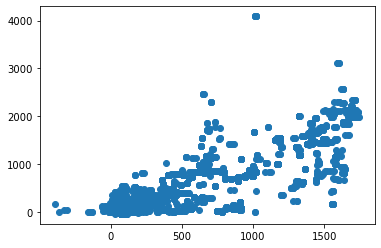

In [332]:
plt.scatter(y_pred_mlp,y_test)

In [334]:
sk.metrics.r2_score(y_pred_mlp,y_test)

0.690042642676044

In [335]:
regr_neigh =sk.neighbors.KNeighborsRegressor(n_neighbors=20)
regr_neigh.fit(X_train,y_train)

KNeighborsRegressor(n_neighbors=20)

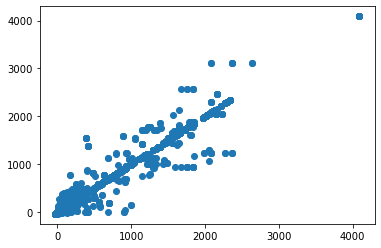

In [336]:
y_pred_neigh=regr_neigh.predict(X_test)
plt.scatter(y_pred_neigh,y_test)

In [337]:
sk.metrics.r2_score(y_pred_neigh,y_test)

0.9662813483408024

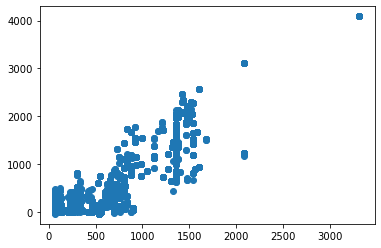

In [392]:
from sklearn.ensemble import AdaBoostRegressor

regr_ada = make_pipeline(StandardScaler(),AdaBoostRegressor(random_state=0, n_estimators=100))
regr_ada.fit(X_train,y_train)
y_pred_ada=regr_ada.predict(X_test)
plt.scatter(y_pred_ada,y_test)

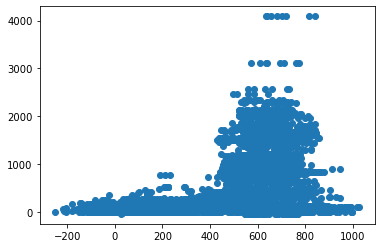

In [393]:
from sklearn import linear_model
reg = linear_model.LinearRegression()
reg.fit(X_train,y_train)
y_pred_reg=reg.predict(X_test)
plt.scatter(y_pred_reg,y_test)

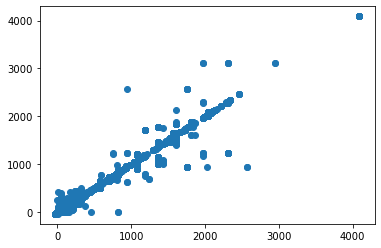

In [451]:
from sklearn.tree import DecisionTreeRegressor

regr_dec = DecisionTreeRegressor(random_state=0,max_depth=12)
regr_dec.fit(X_train,y_train)
y_pred_dec=regr_dec.predict(X_test)
plt.scatter(y_pred_dec,y_test)

In [452]:
sk.metrics.r2_score(y_pred_dec,y_test)

0.9755073781115138

In [453]:
np.sqrt(sk.metrics.mean_squared_error(y_pred_dec,y_test))

92.21550983738145

In [477]:
count=0
df_stream=[]

with open('/Users/marcberghouse/test_stream.csv', newline = '') as data:                                                                                          
    data_reader = csv.reader(data, delimiter='\t')
    for row in data_reader:
        count=count+1
        if count>208:
            if row[0]=='USGS':
                try:
                    df_stream.append([row[1],row[2],row[3]])
                except:
                    print('error in ', row)
                print(row)

['USGS', '09415250', '2010-12-01', '177', 'A']
['USGS', '09415250', '2010-12-02', '167', 'A']
['USGS', '09415250', '2010-12-03', '159', 'A']
['USGS', '09415250', '2010-12-04', '142', 'A']
['USGS', '09415250', '2010-12-05', '154', 'A']
['USGS', '09415250', '2010-12-06', '161', 'A']
['USGS', '09415250', '2010-12-07', '171', 'A']
['USGS', '09415250', '2010-12-08', '198', 'A']
['USGS', '09415250', '2010-12-09', '177', 'A']
['USGS', '09415250', '2010-12-10', '163', 'A']
['USGS', '09415250', '2010-12-11', '145', 'A']
['USGS', '09415250', '2010-12-12', '155', 'A']
['USGS', '09415250', '2010-12-13', '160', 'A']
['USGS', '09415250', '2010-12-14', '160', 'A']
['USGS', '09415250', '2010-12-15', '149', 'A']
['USGS', '09415250', '2010-12-16', '155', 'A']
['USGS', '09415250', '2010-12-17', '158', 'A']
['USGS', '09415250', '2010-12-18', '165', 'A']
['USGS', '09415250', '2010-12-19', '227', 'A']
['USGS', '09415250', '2010-12-20', '1140', 'A']
['USGS', '09415250', '2010-12-21', '6770', 'A']
['USGS', '0

['USGS', '09415460', '2012-11-01', '1.58', 'A']
['USGS', '09415460', '2012-11-02', '1.58', 'A']
['USGS', '09415460', '2012-11-03', '1.58', 'A']
['USGS', '09415460', '2012-11-04', '1.58', 'A']
['USGS', '09415460', '2012-11-05', '1.58', 'A']
['USGS', '09415460', '2012-11-06', '1.57', 'A']
['USGS', '09415460', '2012-11-07', '1.56', 'A']
['USGS', '09415460', '2012-11-08', '1.54', 'A']
['USGS', '09415460', '2012-11-09', '1.58', 'A']
['USGS', '09415460', '2012-11-10', '1.33', 'A']
['USGS', '09415460', '2012-11-11', '1.19', 'A']
['USGS', '09415460', '2012-11-12', '1.27', 'A']
['USGS', '09415460', '2012-11-13', '1.37', 'A']
['USGS', '09415460', '2012-11-14', '1.49', 'A']
['USGS', '09415460', '2012-11-15', '1.56', 'A']
['USGS', '09415460', '2012-11-16', '1.58', 'A']
['USGS', '09415460', '2012-11-17', '1.58', 'A']
['USGS', '09415460', '2012-11-18', '1.54', 'A']
['USGS', '09415460', '2012-11-19', '1.50', 'A']
['USGS', '09415460', '2012-11-20', '1.52', 'A']
['USGS', '09415460', '2012-11-21', '1.52

['USGS', '09415510', '2014-09-05', '9.40', 'A']
['USGS', '09415510', '2014-09-06', '9.40', 'A']
['USGS', '09415510', '2014-09-07', '9.40', 'A']
['USGS', '09415510', '2014-09-08', '9.46', 'A']
['USGS', '09415510', '2014-09-09', '9.56', 'A']
['USGS', '09415510', '2014-09-10', '9.53', 'A']
['USGS', '09415510', '2014-09-11', '9.51', 'A']
['USGS', '09415510', '2014-09-12', '9.48', 'A']
['USGS', '09415510', '2014-09-13', '9.48', 'A']
['USGS', '09415510', '2014-09-14', '9.48', 'A']
['USGS', '09415510', '2014-09-15', '9.49', 'A']
['USGS', '09415510', '2014-09-16', '9.47', 'A']
['USGS', '09415510', '2014-09-17', '9.43', 'A']
['USGS', '09415510', '2014-09-18', '9.45', 'A']
['USGS', '09415510', '2014-09-19', '9.43', 'A']
['USGS', '09415510', '2014-09-20', '9.45', 'A']
['USGS', '09415510', '2014-09-21', '9.53', 'A']
['USGS', '09415510', '2014-09-22', '9.47', 'A']
['USGS', '09415510', '2014-09-23', '9.47', 'A']
['USGS', '09415510', '2014-09-24', '9.46', 'A']
['USGS', '09415510', '2014-09-25', '9.47

['USGS', '09415558', '2015-02-24', '13.7', 'A']
['USGS', '09415558', '2015-02-25', '13.5', 'A']
['USGS', '09415558', '2015-02-26', '13.4', 'A']
['USGS', '09415558', '2015-02-27', '13.4', 'A']
['USGS', '09415558', '2015-02-28', '13.5', 'A']
['USGS', '09415558', '2015-03-01', '13.3', 'A']
['USGS', '09415558', '2015-03-02', '13.5', 'A']
['USGS', '09415558', '2015-03-03', '13.3', 'A']
['USGS', '09415558', '2015-03-04', '13.3', 'A']
['USGS', '09415558', '2015-03-05', '13.2', 'A']
['USGS', '09415558', '2015-03-06', '13.2', 'A']
['USGS', '09415558', '2015-03-07', '13.2', 'A']
['USGS', '09415558', '2015-03-08', '13.2', 'A']
['USGS', '09415558', '2015-03-09', '13.1', 'A']
['USGS', '09415558', '2015-03-10', '13.1', 'A']
['USGS', '09415558', '2015-03-11', '13.1', 'A']
['USGS', '09415558', '2015-03-12', '13.0', 'A']
['USGS', '09415558', '2015-03-13', '13.0', 'A']
['USGS', '09415558', '2015-03-14', '13.0', 'A']
['USGS', '09415558', '2015-03-15', '13.0', 'A']
['USGS', '09415558', '2015-03-16', '13.1

['USGS', '09415590', '2011-12-28', '12.4', 'A']
['USGS', '09415590', '2011-12-29', '12.5', 'A']
['USGS', '09415590', '2011-12-30', '12.5', 'A']
['USGS', '09415590', '2011-12-31', '12.4', 'A']
['USGS', '09415590', '2012-01-01', '12.3', 'A']
['USGS', '09415590', '2012-01-02', '12.3', 'A']
['USGS', '09415590', '2012-01-03', '12.4', 'A']
['USGS', '09415590', '2012-01-04', '12.5', 'A']
['USGS', '09415590', '2012-01-05', '12.5', 'A']
['USGS', '09415590', '2012-01-06', '12.6', 'A']
['USGS', '09415590', '2012-01-07', '12.5', 'A']
['USGS', '09415590', '2012-01-08', '12.5', 'A']
['USGS', '09415590', '2012-01-09', '12.5', 'A']
['USGS', '09415590', '2012-01-10', '12.5', 'A']
['USGS', '09415590', '2012-01-11', '12.5', 'A']
['USGS', '09415590', '2012-01-12', '12.5', 'A']
['USGS', '09415590', '2012-01-13', '12.5', 'A']
['USGS', '09415590', '2012-01-14', '12.5', 'A']
['USGS', '09415590', '2012-01-15', '12.6', 'A']
['USGS', '09415590', '2012-01-16', '12.6', 'A']
['USGS', '09415590', '2012-01-17', '12.5

['USGS', '094156395', '2013-10-30', '0.00', 'A']
['USGS', '094156395', '2013-10-31', '0.00', 'A']
['USGS', '094156395', '2013-11-01', '0.00', 'A']
['USGS', '094156395', '2013-11-02', '0.00', 'A']
['USGS', '094156395', '2013-11-03', '0.00', 'A']
['USGS', '094156395', '2013-11-04', '0.00', 'A']
['USGS', '094156395', '2013-11-05', '0.00', 'A']
['USGS', '094156395', '2013-11-06', '0.00', 'A']
['USGS', '094156395', '2013-11-07', '0.00', 'A']
['USGS', '094156395', '2013-11-08', '0.00', 'A']
['USGS', '094156395', '2013-11-09', '0.00', 'A']
['USGS', '094156395', '2013-11-10', '0.00', 'A']
['USGS', '094156395', '2013-11-11', '0.00', 'A']
['USGS', '094156395', '2013-11-12', '0.00', 'A']
['USGS', '094156395', '2013-11-13', '0.00', 'A']
['USGS', '094156395', '2013-11-14', '0.00', 'A']
['USGS', '094156395', '2013-11-15', '0.00', 'A']
['USGS', '094156395', '2013-11-16', '0.00', 'A']
['USGS', '094156395', '2013-11-17', '0.00', 'A']
['USGS', '094156395', '2013-11-18', '0.00', 'A']
['USGS', '094156395'

['USGS', '09415645', '2015-09-03', '18.1', 'A']
['USGS', '09415645', '2015-09-04', '18.3', 'A']
['USGS', '09415645', '2015-09-05', '18.1', 'A']
['USGS', '09415645', '2015-09-06', '17.9', 'A']
['USGS', '09415645', '2015-09-07', '17.8', 'A']
['USGS', '09415645', '2015-09-08', '18.2', 'A']
['USGS', '09415645', '2015-09-09', '16.4', 'A']
['USGS', '09415645', '2015-09-10', '17.6', 'A']
['USGS', '09415645', '2015-09-11', '18.2', 'A']
['USGS', '09415645', '2015-09-12', '17.9', 'A']
['USGS', '09415645', '2015-09-13', '17.9', 'A']
['USGS', '09415645', '2015-09-14', '18.0', 'A']
['USGS', '09415645', '2015-09-15', '17.9', 'A']
['USGS', '09415645', '2015-09-16', '17.9', 'A']
['USGS', '09415645', '2015-09-17', '17.6', 'A']
['USGS', '09415645', '2015-09-18', '17.5', 'A']
['USGS', '09415645', '2015-09-19', '17.4', 'A']
['USGS', '09415645', '2015-09-20', '17.4', 'A']
['USGS', '09415645', '2015-09-21', '17.7', 'A']
['USGS', '09415645', '2015-09-22', '17.7', 'A']
['USGS', '09415645', '2015-09-23', '17.7

['USGS', '09415908', '2012-07-05', '0.13', 'A']
['USGS', '09415908', '2012-07-06', '0.13', 'A']
['USGS', '09415908', '2012-07-07', '0.13', 'A']
['USGS', '09415908', '2012-07-08', '0.13', 'A']
['USGS', '09415908', '2012-07-09', '0.13', 'A']
['USGS', '09415908', '2012-07-10', '0.13', 'A']
['USGS', '09415908', '2012-07-11', '0.13', 'A']
['USGS', '09415908', '2012-07-12', '0.13', 'A']
['USGS', '09415908', '2012-07-13', '0.13', 'A']
['USGS', '09415908', '2012-07-14', '0.13', 'A']
['USGS', '09415908', '2012-07-15', '0.13', 'A']
['USGS', '09415908', '2012-07-16', '0.13', 'A']
['USGS', '09415908', '2012-07-17', '0.13', 'A']
['USGS', '09415908', '2012-07-18', '0.13', 'A']
['USGS', '09415908', '2012-07-19', '0.13', 'A']
['USGS', '09415908', '2012-07-20', '0.13', 'A']
['USGS', '09415908', '2012-07-21', '0.13', 'A']
['USGS', '09415908', '2012-07-22', '0.13', 'A']
['USGS', '09415908', '2012-07-23', '0.13', 'A']
['USGS', '09415908', '2012-07-24', '0.13', 'A']
['USGS', '09415908', '2012-07-25', '0.13

['USGS', '09415910', '2014-05-09', '0.14', 'A']
['USGS', '09415910', '2014-05-10', '0.14', 'A']
['USGS', '09415910', '2014-05-11', '0.14', 'A']
['USGS', '09415910', '2014-05-12', '0.13', 'A']
['USGS', '09415910', '2014-05-13', '0.13', 'A']
['USGS', '09415910', '2014-05-14', '0.13', 'A']
['USGS', '09415910', '2014-05-15', '0.14', 'A']
['USGS', '09415910', '2014-05-16', '0.14', 'A']
['USGS', '09415910', '2014-05-17', '0.15', 'A']
['USGS', '09415910', '2014-05-18', '0.15', 'A']
['USGS', '09415910', '2014-05-19', '0.14', 'A']
['USGS', '09415910', '2014-05-20', '0.14', 'A']
['USGS', '09415910', '2014-05-21', '0.13', 'A']
['USGS', '09415910', '2014-05-22', '0.14', 'A']
['USGS', '09415910', '2014-05-23', '0.13', 'A']
['USGS', '09415910', '2014-05-24', '0.13', 'A']
['USGS', '09415910', '2014-05-25', '0.14', 'A']
['USGS', '09415910', '2014-05-26', '0.14', 'A']
['USGS', '09415910', '2014-05-27', '0.14', 'A']
['USGS', '09415910', '2014-05-28', '0.14', 'A']
['USGS', '09415910', '2014-05-29', '0.14

['USGS', '09415927', '2011-03-11', '4.72', 'A']
['USGS', '09415927', '2011-03-12', '4.72', 'A']
['USGS', '09415927', '2011-03-13', '4.68', 'A']
['USGS', '09415927', '2011-03-14', '4.64', 'A']
['USGS', '09415927', '2011-03-15', '4.64', 'A']
['USGS', '09415927', '2011-03-16', '4.64', 'A']
['USGS', '09415927', '2011-03-17', '4.64', 'A']
['USGS', '09415927', '2011-03-18', '4.64', 'A']
['USGS', '09415927', '2011-03-19', '4.61', 'A']
['USGS', '09415927', '2011-03-20', '4.63', 'A']
['USGS', '09415927', '2011-03-21', '4.61', 'A']
['USGS', '09415927', '2011-03-22', '4.64', 'A']
['USGS', '09415927', '2011-03-23', '4.63', 'A']
['USGS', '09415927', '2011-03-24', '4.61', 'A']
['USGS', '09415927', '2011-03-25', '4.62', 'A']
['USGS', '09415927', '2011-03-26', '4.64', 'A']
['USGS', '09415927', '2011-03-27', '4.63', 'A']
['USGS', '09415927', '2011-03-28', '4.63', 'A']
['USGS', '09415927', '2011-03-29', '4.63', 'A']
['USGS', '09415927', '2011-03-30', '4.64', 'A']
['USGS', '09415927', '2011-03-31', '4.64

['USGS', '09416000', '2013-03-21', '0.00', 'A', '43.7', 'A']
['USGS', '09416000', '2013-03-22', '0.00', 'A', '43.6', 'A']
['USGS', '09416000', '2013-03-23', '0.00', 'A', '43.4', 'A']
['USGS', '09416000', '2013-03-24', '0.00', 'A', '43.5', 'A']
['USGS', '09416000', '2013-03-25', '0.00', 'A', '43.6', 'A']
['USGS', '09416000', '2013-03-26', '0.00', 'A', '43.7', 'A']
['USGS', '09416000', '2013-03-27', '0.00', 'A', '43.5', 'A']
['USGS', '09416000', '2013-03-28', '0.00', 'A', '43.4', 'A']
['USGS', '09416000', '2013-03-29', '0.00', 'A', '43.6', 'A']
['USGS', '09416000', '2013-03-30', '0.00', 'A', '43.6', 'A']
['USGS', '09416000', '2013-03-31', '0.00', 'A', '43.7', 'A']
['USGS', '09416000', '2013-04-01', '0.00', 'A', '43.4', 'A']
['USGS', '09416000', '2013-04-02', '0.00', 'A', '43.0', 'A']
['USGS', '09416000', '2013-04-03', '0.00', 'A', '43.3', 'A']
['USGS', '09416000', '2013-04-04', '0.00', 'A', '43.6', 'A']
['USGS', '09416000', '2013-04-05', '0.00', 'A', '43.6', 'A']
['USGS', '09416000', '20

['USGS', '09418500', '2013-10-18', '2.37', 'A']
['USGS', '09418500', '2013-10-19', '2.32', 'A']
['USGS', '09418500', '2013-10-20', '2.38', 'A']
['USGS', '09418500', '2013-10-21', '2.29', 'A']
['USGS', '09418500', '2013-10-22', '2.20', 'A']
['USGS', '09418500', '2013-10-23', '2.37', 'A']
['USGS', '09418500', '2013-10-24', '2.36', 'A']
['USGS', '09418500', '2013-10-25', '2.54', 'A']
['USGS', '09418500', '2013-10-26', '2.63', 'A']
['USGS', '09418500', '2013-10-27', '2.12', 'A']
['USGS', '09418500', '2013-10-28', '2.54', 'A']
['USGS', '09418500', '2013-10-29', '3.01', 'A']
['USGS', '09418500', '2013-10-30', '2.89', 'A']
['USGS', '09418500', '2013-10-31', '2.72', 'A']
['USGS', '09418500', '2013-11-01', '2.62', 'A']
['USGS', '09418500', '2013-11-02', '2.63', 'A']
['USGS', '09418500', '2013-11-03', '2.65', 'A']
['USGS', '09418500', '2013-11-04', '3.02', 'A']
['USGS', '09418500', '2013-11-05', '3.21', 'A']
['USGS', '09418500', '2013-11-06', '3.08', 'A']
['USGS', '09418500', '2013-11-07', '3.08

['USGS', '09419000', '2015-07-06', '39.2', 'A']
['USGS', '09419000', '2015-07-07', '38.5', 'A']
['USGS', '09419000', '2015-07-08', '38.1', 'A']
['USGS', '09419000', '2015-07-09', '37.7', 'A']
['USGS', '09419000', '2015-07-10', '36.7', 'A']
['USGS', '09419000', '2015-07-11', '36.6', 'A']
['USGS', '09419000', '2015-07-12', '36.6', 'A']
['USGS', '09419000', '2015-07-13', '36.5', 'A']
['USGS', '09419000', '2015-07-14', '35.8', 'A']
['USGS', '09419000', '2015-07-15', '35.1', 'A']
['USGS', '09419000', '2015-07-16', '34.4', 'A']
['USGS', '09419000', '2015-07-17', '34.5', 'A']
['USGS', '09419000', '2015-07-18', '34.0', 'A']
['USGS', '09419000', '2015-07-19', '46.6', 'A']
['USGS', '09419000', '2015-07-20', '68.2', 'A']
['USGS', '09419000', '2015-07-21', '58.8', 'A']
['USGS', '09419000', '2015-07-22', '36.2', 'A']
['USGS', '09419000', '2015-07-23', '34.6', 'A']
['USGS', '09419000', '2015-07-24', '34.7', 'A']
['USGS', '09419000', '2015-07-25', '34.7', 'A']
['USGS', '09419000', '2015-07-26', '35.0

['USGS', '09419625', '2011-02-18', '0.34', 'A']
['USGS', '09419625', '2011-02-19', '0.35', 'A']
['USGS', '09419625', '2011-02-20', '0.35', 'A']
['USGS', '09419625', '2011-02-21', '0.35', 'A']
['USGS', '09419625', '2011-02-22', '0.35', 'A']
['USGS', '09419625', '2011-02-23', '0.35', 'A']
['USGS', '09419625', '2011-02-24', '0.34', 'A']
['USGS', '09419625', '2011-02-25', '0.34', 'A']
['USGS', '09419625', '2011-02-26', '0.34', 'A']
['USGS', '09419625', '2011-02-27', '0.34', 'A']
['USGS', '09419625', '2011-02-28', '0.34', 'A']
['USGS', '09419625', '2011-03-01', '0.34', 'A']
['USGS', '09419625', '2011-03-02', '0.34', 'A']
['USGS', '09419625', '2011-03-03', '0.34', 'A']
['USGS', '09419625', '2011-03-04', '0.34', 'A']
['USGS', '09419625', '2011-03-05', '0.34', 'A']
['USGS', '09419625', '2011-03-06', '0.34', 'A']
['USGS', '09419625', '2011-03-07', '0.32', 'A']
['USGS', '09419625', '2011-03-08', '0.28', 'A']
['USGS', '09419625', '2011-03-09', '0.36', 'A']
['USGS', '09419625', '2011-03-10', '0.37

['USGS', '09419658', '2012-08-12', '0.00', 'A', '49.8', 'A:e']
['USGS', '09419658', '2012-08-13', '0.00', 'A', '7.14', 'A:e']
['USGS', '09419658', '2012-08-14', '0.00', 'A', '2.12', 'A:e']
['USGS', '09419658', '2012-08-15', '0.00', 'A', '2.12', 'A:e']
['USGS', '09419658', '2012-08-16', '0.00', 'A', '2.12', 'A:e']
['USGS', '09419658', '2012-08-17', '0.00', 'A', '6.09', 'A:e']
['USGS', '09419658', '2012-08-18', '0.00', 'A', '146', 'A:e']
['USGS', '09419658', '2012-08-19', '0.00', 'A', '4.00', 'A:e']
['USGS', '09419658', '2012-08-20', '0.00', 'A', '2.00', 'A:e']
['USGS', '09419658', '2012-08-21', '0.01', 'A', '7.97', 'A']
['USGS', '09419658', '2012-08-22', '1.44', 'A', '775', 'A']
['USGS', '09419658', '2012-08-23', '0.00', 'A', '60.3', 'A']
['USGS', '09419658', '2012-08-24', '0.00', 'A', '21.6', 'A:e']
['USGS', '09419658', '2012-08-25', '0.00', 'A', '9.85', 'A:e']
['USGS', '09419658', '2012-08-26', '0.00', 'A', '3.56', 'A:e']
['USGS', '09419658', '2012-08-27', '0.00', 'A', '2.11', 'A:e']


['USGS', '09419659', '2015-10-12', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-13', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-14', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-15', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-16', '0.08', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-17', '0.16', 'A', '7.85', 'A']
['USGS', '09419659', '2015-10-18', '0.48', 'A', '10.9', 'A']
['USGS', '09419659', '2015-10-19', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-20', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-21', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-22', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-23', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-24', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-25', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-26', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '2015-10-27', '0.00', 'A', '0.00', 'A']
['USGS', '09419659', '20

['USGS', '094196781', '2012-10-01', '0.00', 'A', '6.85', 'A']
['USGS', '094196781', '2012-10-02', '0.00', 'A', '6.77', 'A']
['USGS', '094196781', '2012-10-03', '0.00', 'A', '6.95', 'A']
['USGS', '094196781', '2012-10-04', '0.00', 'A', '6.79', 'A']
['USGS', '094196781', '2012-10-05', '0.00', 'A', '6.62', 'A']
['USGS', '094196781', '2012-10-06', '0.00', 'A', '6.96', 'A']
['USGS', '094196781', '2012-10-07', '0.00', 'A', '7.28', 'A']
['USGS', '094196781', '2012-10-08', '0.00', 'A', '7.98', 'A']
['USGS', '094196781', '2012-10-09', '0.00', 'A', '8.45', 'A']
['USGS', '094196781', '2012-10-10', '', '', '11.7', 'A']
['USGS', '094196781', '2012-10-11', '', '', '740', 'A:e']
['USGS', '094196781', '2012-10-12', '0.00', 'A', '333', 'A']
['USGS', '094196781', '2012-10-13', '0.00', 'A', '25.0', 'A:e']
['USGS', '094196781', '2012-10-14', '0.00', 'A', '6.70', 'A:e']
['USGS', '094196781', '2012-10-15', '0.00', 'A', '6.20', 'A:e']
['USGS', '094196781', '2012-10-16', '0.00', 'A', '5.63', 'A:e']
['USGS', '

['USGS', '094196784', '2012-01-18', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-19', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-20', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-21', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-22', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-23', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-24', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-25', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-26', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-27', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-28', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-29', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-30', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-01-31', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-02-01', '0.00', 'A', '50.0', 'A:<']
['USGS', '094196784', '2012-02-02', '0.0

['USGS', '09419679', '2014-03-12', '251', 'A']
['USGS', '09419679', '2014-03-13', '253', 'A']
['USGS', '09419679', '2014-03-14', '255', 'A']
['USGS', '09419679', '2014-03-15', '260', 'A']
['USGS', '09419679', '2014-03-16', '261', 'A']
['USGS', '09419679', '2014-03-17', '260', 'A']
['USGS', '09419679', '2014-03-18', '250', 'A']
['USGS', '09419679', '2014-03-19', '251', 'A']
['USGS', '09419679', '2014-03-20', '253', 'A']
['USGS', '09419679', '2014-03-21', '260', 'A']
['USGS', '09419679', '2014-03-22', '266', 'A']
['USGS', '09419679', '2014-03-23', '266', 'A']
['USGS', '09419679', '2014-03-24', '262', 'A']
['USGS', '09419679', '2014-03-25', '257', 'A']
['USGS', '09419679', '2014-03-26', '254', 'A']
['USGS', '09419679', '2014-03-27', '257', 'A']
['USGS', '09419679', '2014-03-28', '259', 'A']
['USGS', '09419679', '2014-03-29', '264', 'A']
['USGS', '09419679', '2014-03-30', '261', 'A']
['USGS', '09419679', '2014-03-31', '260', 'A']
['USGS', '09419679', '2014-04-01', '261', 'A']
['USGS', '094

['USGS', '09419700', '2011-02-10', '326', 'A:e']
['USGS', '09419700', '2011-02-11', '329', 'A:e']
['USGS', '09419700', '2011-02-12', '334', 'A:e']
['USGS', '09419700', '2011-02-13', '334', 'A:e']
['USGS', '09419700', '2011-02-14', '334', 'A:e']
['USGS', '09419700', '2011-02-15', '330', 'A:e']
['USGS', '09419700', '2011-02-16', '325', 'A:e']
['USGS', '09419700', '2011-02-17', '312', 'A:e']
['USGS', '09419700', '2011-02-18', '320', 'A:e']
['USGS', '09419700', '2011-02-19', '368', 'A:e']
['USGS', '09419700', '2011-02-20', '324', 'A:e']
['USGS', '09419700', '2011-02-21', '319', 'A:e']
['USGS', '09419700', '2011-02-22', '305', 'A:e']
['USGS', '09419700', '2011-02-23', '320', 'A:e']
['USGS', '09419700', '2011-02-24', '308', 'A:e']
['USGS', '09419700', '2011-02-25', '309', 'A:e']
['USGS', '09419700', '2011-02-26', '314', 'A:e']
['USGS', '09419700', '2011-02-27', '318', 'A:e']
['USGS', '09419700', '2011-02-28', '300', 'A:e']
['USGS', '09419700', '2011-03-01', '302', 'A:e']
['USGS', '09419700',

['USGS', '09419740', '2013-07-04', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-05', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-06', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-07', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-08', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-09', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-10', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-11', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-12', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-13', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-14', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-15', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-16', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-17', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-18', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '2013-07-19', '0.00', 'A', '0.00', 'A']
['USGS', '09419740', '20

['USGS', '09419753', '2011-01-09', '323', 'A']
['USGS', '09419753', '2011-01-10', '314', 'A']
['USGS', '09419753', '2011-01-11', '298', 'A']
['USGS', '09419753', '2011-01-12', '307', 'A']
['USGS', '09419753', '2011-01-13', '299', 'A']
['USGS', '09419753', '2011-01-14', '308', 'A']
['USGS', '09419753', '2011-01-15', '315', 'A']
['USGS', '09419753', '2011-01-16', '319', 'A']
['USGS', '09419753', '2011-01-17', '321', 'A']
['USGS', '09419753', '2011-01-18', '317', 'A']
['USGS', '09419753', '2011-01-19', '318', 'A']
['USGS', '09419753', '2011-01-20', '319', 'A']
['USGS', '09419753', '2011-01-21', '319', 'A']
['USGS', '09419753', '2011-01-22', '333', 'A']
['USGS', '09419753', '2011-01-23', '335', 'A']
['USGS', '09419753', '2011-01-24', '328', 'A']
['USGS', '09419753', '2011-01-25', '316', 'A']
['USGS', '09419753', '2011-01-26', '325', 'A']
['USGS', '09419753', '2011-01-27', '321', 'A']
['USGS', '09419753', '2011-01-28', '329', 'A']
['USGS', '09419753', '2011-01-29', '335', 'A']
['USGS', '094

['USGS', '09419756', '2012-02-10', '0.00', 'A']
['USGS', '09419756', '2012-02-11', '0.00', 'A']
['USGS', '09419756', '2012-02-12', '0.00', 'A']
['USGS', '09419756', '2012-02-13', '0.00', 'A']
['USGS', '09419756', '2012-02-14', '0.00', 'A']
['USGS', '09419756', '2012-02-15', '0.00', 'A']
['USGS', '09419756', '2012-02-16', '0.00', 'A']
['USGS', '09419756', '2012-02-17', '0.00', 'A']
['USGS', '09419756', '2012-02-18', '0.00', 'A']
['USGS', '09419756', '2012-02-19', '0.00', 'A']
['USGS', '09419756', '2012-02-20', '0.00', 'A']
['USGS', '09419756', '2012-02-21', '0.00', 'A']
['USGS', '09419756', '2012-02-22', '0.00', 'A']
['USGS', '09419756', '2012-02-23', '0.00', 'A']
['USGS', '09419756', '2012-02-24', '0.00', 'A']
['USGS', '09419756', '2012-02-25', '0.00', 'A']
['USGS', '09419756', '2012-02-26', '0.00', 'A']
['USGS', '09419756', '2012-02-27', '0.00', 'A']
['USGS', '09419756', '2012-02-28', '0.00', 'A']
['USGS', '09419756', '2012-02-29', '0.00', 'A']
['USGS', '09419756', '2012-03-01', '0.00

['USGS', '09419800', '2014-11-04', '309', 'A']
['USGS', '09419800', '2014-11-05', '309', 'A']
['USGS', '09419800', '2014-11-06', '305', 'A']
['USGS', '09419800', '2014-11-07', '304', 'A']
['USGS', '09419800', '2014-11-08', '314', 'A']
['USGS', '09419800', '2014-11-09', '309', 'A']
['USGS', '09419800', '2014-11-10', '311', 'A']
['USGS', '09419800', '2014-11-11', '309', 'A']
['USGS', '09419800', '2014-11-12', '294', 'A']
['USGS', '09419800', '2014-11-13', '295', 'A']
['USGS', '09419800', '2014-11-14', '295', 'A']
['USGS', '09419800', '2014-11-15', '300', 'A']
['USGS', '09419800', '2014-11-16', '304', 'A']
['USGS', '09419800', '2014-11-17', '303', 'A']
['USGS', '09419800', '2014-11-18', '294', 'A']
['USGS', '09419800', '2014-11-19', '295', 'A']
['USGS', '09419800', '2014-11-20', '302', 'A']
['USGS', '09419800', '2014-11-21', '309', 'A']
['USGS', '09419800', '2014-11-22', '316', 'A']
['USGS', '09419800', '2014-11-23', '314', 'A']
['USGS', '09419800', '2014-11-24', '308', 'A']
['USGS', '094

['USGS', '09423000', '2011-09-07', '14000', 'A', '4870', 'A', '10800', 'A']
['USGS', '09423000', '2011-09-08', '18700', 'A', '4870', 'A', '11500', 'A']
['USGS', '09423000', '2011-09-09', '18500', 'A', '4830', 'A', '11400', 'A']
['USGS', '09423000', '2011-09-10', '18700', 'A', '4850', 'A', '11800', 'A']
['USGS', '09423000', '2011-09-11', '18700', 'A', '4880', 'A', '11500', 'A']
['USGS', '09423000', '2011-09-12', '18700', 'A', '4870', 'A', '11500', 'A']
['USGS', '09423000', '2011-09-13', '18400', 'A', '4870', 'A', '10100', 'A']
['USGS', '09423000', '2011-09-14', '18600', 'A', '4880', 'A', '11700', 'A']
['USGS', '09423000', '2011-09-15', '18600', 'A', '4900', 'A', '11300', 'A']
['USGS', '09423000', '2011-09-16', '18800', 'A', '4880', 'A', '12800', 'A']
['USGS', '09423000', '2011-09-17', '18800', 'A', '4910', 'A', '12600', 'A']
['USGS', '09423000', '2011-09-18', '19000', 'A', '4830', 'A', '12500', 'A']
['USGS', '09423000', '2011-09-19', '14300', 'A', '4900', 'A', '10700', 'A']
['USGS', '09

['USGS', '10243224', '2013-07-10', '5.98', 'A']
['USGS', '10243224', '2013-07-11', '5.87', 'A']
['USGS', '10243224', '2013-07-12', '5.76', 'A']
['USGS', '10243224', '2013-07-13', '5.81', 'A']
['USGS', '10243224', '2013-07-14', '5.88', 'A']
['USGS', '10243224', '2013-07-15', '5.92', 'A']
['USGS', '10243224', '2013-07-16', '5.98', 'A']
['USGS', '10243224', '2013-07-17', '5.98', 'A']
['USGS', '10243224', '2013-07-18', '5.98', 'A']
['USGS', '10243224', '2013-07-19', '5.98', 'A']
['USGS', '10243224', '2013-07-20', '5.96', 'A']
['USGS', '10243224', '2013-07-21', '5.97', 'A']
['USGS', '10243224', '2013-07-22', '5.97', 'A']
['USGS', '10243224', '2013-07-23', '5.98', 'A']
['USGS', '10243224', '2013-07-24', '5.98', 'A']
['USGS', '10243224', '2013-07-25', '5.84', 'A']
['USGS', '10243224', '2013-07-26', '5.76', 'A']
['USGS', '10243224', '2013-07-27', '5.76', 'A']
['USGS', '10243224', '2013-07-28', '5.76', 'A']
['USGS', '10243224', '2013-07-29', '5.76', 'A']
['USGS', '10243224', '2013-07-30', '5.76

['USGS', '102432241', '2015-08-12', '3.56', 'A']
['USGS', '102432241', '2015-08-13', '3.53', 'A']
['USGS', '102432241', '2015-08-14', '3.50', 'A']
['USGS', '102432241', '2015-08-15', '3.53', 'A']
['USGS', '102432241', '2015-08-16', '3.55', 'A']
['USGS', '102432241', '2015-08-17', '3.56', 'A']
['USGS', '102432241', '2015-08-18', '3.53', 'A']
['USGS', '102432241', '2015-08-19', '3.47', 'A']
['USGS', '102432241', '2015-08-20', '3.52', 'A']
['USGS', '102432241', '2015-08-21', '3.39', 'A']
['USGS', '102432241', '2015-08-22', '3.37', 'A']
['USGS', '102432241', '2015-08-23', '3.39', 'A']
['USGS', '102432241', '2015-08-24', '3.36', 'A']
['USGS', '102432241', '2015-08-25', '3.34', 'A']
['USGS', '102432241', '2015-08-26', '3.33', 'A']
['USGS', '102432241', '2015-08-27', '3.32', 'A']
['USGS', '102432241', '2015-08-28', '3.32', 'A']
['USGS', '102432241', '2015-08-29', '3.32', 'A']
['USGS', '102432241', '2015-08-30', '3.32', 'A']
['USGS', '102432241', '2015-08-31', '3.32', 'A']
['USGS', '102432241'

['USGS', '10243700', '2013-02-26', '6.43', 'A:e']
['USGS', '10243700', '2013-02-27', '6.42', 'A:e']
['USGS', '10243700', '2013-02-28', '6.46', 'A:e']
['USGS', '10243700', '2013-03-01', '6.33', 'A']
['USGS', '10243700', '2013-03-02', '6.35', 'A']
['USGS', '10243700', '2013-03-03', '6.37', 'A']
['USGS', '10243700', '2013-03-04', '6.30', 'A']
['USGS', '10243700', '2013-03-05', '6.29', 'A']
['USGS', '10243700', '2013-03-06', '6.35', 'A']
['USGS', '10243700', '2013-03-07', '6.28', 'A']
['USGS', '10243700', '2013-03-08', '6.32', 'A']
['USGS', '10243700', '2013-03-09', '6.27', 'A']
['USGS', '10243700', '2013-03-10', '6.24', 'A']
['USGS', '10243700', '2013-03-11', '6.30', 'A']
['USGS', '10243700', '2013-03-12', '6.47', 'A']
['USGS', '10243700', '2013-03-13', '6.64', 'A']
['USGS', '10243700', '2013-03-14', '6.88', 'A']
['USGS', '10243700', '2013-03-15', '7.03', 'A']
['USGS', '10243700', '2013-03-16', '7.00', 'A']
['USGS', '10243700', '2013-03-17', '6.90', 'A']
['USGS', '10243700', '2013-03-18',

['USGS', '10244950', '2014-09-27', '2.99', 'A']
['USGS', '10244950', '2014-09-28', '2.94', 'A']
['USGS', '10244950', '2014-09-29', '2.93', 'A']
['USGS', '10244950', '2014-09-30', '2.91', 'A']
['USGS', '10244950', '2014-10-01', '2.84', 'A']
['USGS', '10244950', '2014-10-02', '2.81', 'A']
['USGS', '10244950', '2014-10-03', '2.82', 'A']
['USGS', '10244950', '2014-10-04', '2.80', 'A']
['USGS', '10244950', '2014-10-05', '2.79', 'A']
['USGS', '10244950', '2014-10-06', '2.84', 'A']
['USGS', '10244950', '2014-10-07', '2.88', 'A']
['USGS', '10244950', '2014-10-08', '2.90', 'A']
['USGS', '10244950', '2014-10-09', '2.82', 'A']
['USGS', '10244950', '2014-10-10', '2.80', 'A']
['USGS', '10244950', '2014-10-11', '2.78', 'A']
['USGS', '10244950', '2014-10-12', '2.76', 'A']
['USGS', '10244950', '2014-10-13', '2.72', 'A']
['USGS', '10244950', '2014-10-14', '2.74', 'A']
['USGS', '10244950', '2014-10-15', '2.72', 'A']
['USGS', '10244950', '2014-10-16', '2.74', 'A']
['USGS', '10244950', '2014-10-17', '2.73

['USGS', '10245960', '2012-05-16', '0.00', 'A']
['USGS', '10245960', '2012-05-17', '0.00', 'A']
['USGS', '10245960', '2012-05-18', '0.00', 'A']
['USGS', '10245960', '2012-05-19', '0.00', 'A']
['USGS', '10245960', '2012-05-20', '0.00', 'A']
['USGS', '10245960', '2012-05-21', '0.00', 'A']
['USGS', '10245960', '2012-05-22', '0.00', 'A']
['USGS', '10245960', '2012-05-23', '0.00', 'A']
['USGS', '10245960', '2012-05-24', '0.00', 'A']
['USGS', '10245960', '2012-05-25', '0.00', 'A']
['USGS', '10245960', '2012-05-26', '0.00', 'A']
['USGS', '10245960', '2012-05-27', '0.00', 'A']
['USGS', '10245960', '2012-05-28', '0.00', 'A']
['USGS', '10245960', '2012-05-29', '0.00', 'A']
['USGS', '10245960', '2012-05-30', '0.00', 'A']
['USGS', '10245960', '2012-05-31', '0.00', 'A']
['USGS', '10245960', '2012-06-01', '0.00', 'A']
['USGS', '10245960', '2012-06-02', '0.00', 'A']
['USGS', '10245960', '2012-06-03', '0.00', 'A']
['USGS', '10245960', '2012-06-04', '0.00', 'A']
['USGS', '10245960', '2012-06-05', '0.00

['USGS', '10245970', '2014-08-21', '0.08', 'A']
['USGS', '10245970', '2014-08-22', '0.07', 'A']
['USGS', '10245970', '2014-08-23', '0.07', 'A']
['USGS', '10245970', '2014-08-24', '0.07', 'A']
['USGS', '10245970', '2014-08-25', '0.07', 'A']
['USGS', '10245970', '2014-08-26', '0.08', 'A']
['USGS', '10245970', '2014-08-27', '0.08', 'A']
['USGS', '10245970', '2014-08-28', '0.07', 'A']
['USGS', '10245970', '2014-08-29', '0.07', 'A']
['USGS', '10245970', '2014-08-30', '0.06', 'A']
['USGS', '10245970', '2014-08-31', '0.06', 'A']
['USGS', '10245970', '2014-09-01', '0.07', 'A']
['USGS', '10245970', '2014-09-02', '0.07', 'A']
['USGS', '10245970', '2014-09-03', '0.07', 'A']
['USGS', '10245970', '2014-09-04', '0.07', 'A']
['USGS', '10245970', '2014-09-05', '0.07', 'A']
['USGS', '10245970', '2014-09-06', '0.06', 'A']
['USGS', '10245970', '2014-09-07', '0.06', 'A']
['USGS', '10245970', '2014-09-08', '0.06', 'A']
['USGS', '10245970', '2014-09-09', '0.07', 'A']
['USGS', '10245970', '2014-09-10', '0.07

['USGS', '10249280', '2011-06-23', '29.2', 'A']
['USGS', '10249280', '2011-06-24', '31.1', 'A']
['USGS', '10249280', '2011-06-25', '31.4', 'A']
['USGS', '10249280', '2011-06-26', '30.4', 'A']
['USGS', '10249280', '2011-06-27', '29.9', 'A']
['USGS', '10249280', '2011-06-28', '29.7', 'A']
['USGS', '10249280', '2011-06-29', '29.8', 'A']
['USGS', '10249280', '2011-06-30', '30.4', 'A']
['USGS', '10249280', '2011-07-01', '30.0', 'A']
['USGS', '10249280', '2011-07-02', '29.3', 'A']
['USGS', '10249280', '2011-07-03', '28.9', 'A']
['USGS', '10249280', '2011-07-04', '29.1', 'A']
['USGS', '10249280', '2011-07-05', '29.2', 'A']
['USGS', '10249280', '2011-07-06', '29.1', 'A']
['USGS', '10249280', '2011-07-07', '28.3', 'A']
['USGS', '10249280', '2011-07-08', '27.5', 'A']
['USGS', '10249280', '2011-07-09', '26.9', 'A']
['USGS', '10249280', '2011-07-10', '26.4', 'A']
['USGS', '10249280', '2011-07-11', '26.3', 'A']
['USGS', '10249280', '2011-07-12', '26.1', 'A']
['USGS', '10249280', '2011-07-13', '25.7

['USGS', '10249300', '2013-06-16', '14.5', 'A', '9.0', 'A', '11.5', 'A', '1.35', 'A']
['USGS', '10249300', '2013-06-17', '15.0', 'A', '9.5', 'A', '12.0', 'A', '1.27', 'A']
['USGS', '10249300', '2013-06-18', '15.0', 'A', '10.0', 'A', '12.0', 'A', '1.19', 'A']
['USGS', '10249300', '2013-06-19', '12.5', 'A', '8.5', 'A', '10.5', 'A', '1.15', 'A']
['USGS', '10249300', '2013-06-20', '13.0', 'A', '7.5', 'A', '10.0', 'A', '1.17', 'A']
['USGS', '10249300', '2013-06-21', '13.0', 'A', '8.0', 'A', '10.5', 'A', '1.22', 'A']
['USGS', '10249300', '2013-06-22', '13.5', 'A', '8.0', 'A', '10.5', 'A', '1.19', 'A']
['USGS', '10249300', '2013-06-23', '13.0', 'A', '9.5', 'A', '11.0', 'A', '1.10', 'A']
['USGS', '10249300', '2013-06-24', '11.5', 'A', '9.5', 'A', '10.5', 'A', '1.15', 'A']
['USGS', '10249300', '2013-06-25', '14.5', 'A', '9.5', 'A', '12.0', 'A', '1.16', 'A']
['USGS', '10249300', '2013-06-26', '16.0', 'A', '10.5', 'A', '13.0', 'A', '0.99', 'A']
['USGS', '10249300', '2013-06-27', '16.0', 'A', '11.

['USGS', '10293048', '2015-08-17', '2.11', 'A']
['USGS', '10293048', '2015-08-18', '2.06', 'A']
['USGS', '10293048', '2015-08-19', '2.02', 'A']
['USGS', '10293048', '2015-08-20', '1.97', 'A']
['USGS', '10293048', '2015-08-21', '1.93', 'A']
['USGS', '10293048', '2015-08-22', '1.91', 'A']
['USGS', '10293048', '2015-08-23', '1.78', 'A']
['USGS', '10293048', '2015-08-24', '1.71', 'A']
['USGS', '10293048', '2015-08-25', '1.68', 'A']
['USGS', '10293048', '2015-08-26', '1.68', 'A']
['USGS', '10293048', '2015-08-27', '1.66', 'A']
['USGS', '10293048', '2015-08-28', '1.66', 'A']
['USGS', '10293048', '2015-08-29', '1.60', 'A']
['USGS', '10293048', '2015-08-30', '1.51', 'A']
['USGS', '10293048', '2015-08-31', '1.47', 'A']
['USGS', '10293048', '2015-09-01', '1.43', 'A']
['USGS', '10293048', '2015-09-02', '1.42', 'A']
['USGS', '10293048', '2015-09-03', '1.38', 'A']
['USGS', '10293048', '2015-09-04', '1.36', 'A']
['USGS', '10293048', '2015-09-05', '1.37', 'A']
['USGS', '10293048', '2015-09-06', '1.36

['USGS', '10293500', '2013-09-19', '23.0', 'A']
['USGS', '10293500', '2013-09-20', '32.6', 'A']
['USGS', '10293500', '2013-09-21', '33.6', 'A']
['USGS', '10293500', '2013-09-22', '37.1', 'A']
['USGS', '10293500', '2013-09-23', '40.5', 'A']
['USGS', '10293500', '2013-09-24', '39.5', 'A']
['USGS', '10293500', '2013-09-25', '32.6', 'A']
['USGS', '10293500', '2013-09-26', '28.9', 'A']
['USGS', '10293500', '2013-09-27', '27.8', 'A']
['USGS', '10293500', '2013-09-28', '29.2', 'A']
['USGS', '10293500', '2013-09-29', '28.2', 'A']
['USGS', '10293500', '2013-09-30', '21.2', 'A']
['USGS', '10293500', '2013-10-01', '17.8', 'A']
['USGS', '10293500', '2013-10-02', '18.4', 'A']
['USGS', '10293500', '2013-10-03', '23.0', 'A']
['USGS', '10293500', '2013-10-04', '23.8', 'A']
['USGS', '10293500', '2013-10-05', '21.5', 'A']
['USGS', '10293500', '2013-10-06', '22.3', 'A']
['USGS', '10293500', '2013-10-07', '22.2', 'A']
['USGS', '10293500', '2013-10-08', '20.7', 'A']
['USGS', '10293500', '2013-10-09', '25.1

['USGS', '10295000', '2015-03-24', '17.1', 'A']
['USGS', '10295000', '2015-03-25', '16.5', 'A']
['USGS', '10295000', '2015-03-26', '15.4', 'A']
['USGS', '10295000', '2015-03-27', '13.2', 'A']
['USGS', '10295000', '2015-03-28', '13.5', 'A']
['USGS', '10295000', '2015-03-29', '13.0', 'A']
['USGS', '10295000', '2015-03-30', '12.6', 'A']
['USGS', '10295000', '2015-03-31', '12.3', 'A']
['USGS', '10295000', '2015-04-01', '12.3', 'A']
['USGS', '10295000', '2015-04-02', '12.0', 'A']
['USGS', '10295000', '2015-04-03', '12.4', 'A']
['USGS', '10295000', '2015-04-04', '12.2', 'A']
['USGS', '10295000', '2015-04-05', '12.1', 'A']
['USGS', '10295000', '2015-04-06', '11.8', 'A']
['USGS', '10295000', '2015-04-07', '11.9', 'A']
['USGS', '10295000', '2015-04-08', '12.3', 'A']
['USGS', '10295000', '2015-04-09', '13.0', 'A']
['USGS', '10295000', '2015-04-10', '12.5', 'A']
['USGS', '10295000', '2015-04-11', '12.2', 'A']
['USGS', '10295000', '2015-04-12', '10.9', 'A']
['USGS', '10295000', '2015-04-13', '11.4

['USGS', '10297500', '2012-07-04', '178', 'A']
['USGS', '10297500', '2012-07-05', '181', 'A']
['USGS', '10297500', '2012-07-06', '198', 'A']
['USGS', '10297500', '2012-07-07', '206', 'A']
['USGS', '10297500', '2012-07-08', '204', 'A']
['USGS', '10297500', '2012-07-09', '198', 'A']
['USGS', '10297500', '2012-07-10', '184', 'A']
['USGS', '10297500', '2012-07-11', '183', 'A']
['USGS', '10297500', '2012-07-12', '182', 'A']
['USGS', '10297500', '2012-07-13', '181', 'A']
['USGS', '10297500', '2012-07-14', '189', 'A']
['USGS', '10297500', '2012-07-15', '216', 'A']
['USGS', '10297500', '2012-07-16', '220', 'A']
['USGS', '10297500', '2012-07-17', '228', 'A']
['USGS', '10297500', '2012-07-18', '212', 'A']
['USGS', '10297500', '2012-07-19', '185', 'A']
['USGS', '10297500', '2012-07-20', '150', 'A']
['USGS', '10297500', '2012-07-21', '150', 'A']
['USGS', '10297500', '2012-07-22', '156', 'A']
['USGS', '10297500', '2012-07-23', '156', 'A']
['USGS', '10297500', '2012-07-24', '147', 'A']
['USGS', '102

['USGS', '10298600', '2014-07-18', '41.6', 'A']
['USGS', '10298600', '2014-07-19', '38.8', 'A']
['USGS', '10298600', '2014-07-20', '37.9', 'A']
['USGS', '10298600', '2014-07-21', '35.2', 'A']
['USGS', '10298600', '2014-07-22', '33.5', 'A']
['USGS', '10298600', '2014-07-23', '33.1', 'A']
['USGS', '10298600', '2014-07-24', '27.5', 'A']
['USGS', '10298600', '2014-07-25', '30.2', 'A']
['USGS', '10298600', '2014-07-26', '31.4', 'A']
['USGS', '10298600', '2014-07-27', '32.5', 'A']
['USGS', '10298600', '2014-07-28', '32.2', 'A']
['USGS', '10298600', '2014-07-29', '31.9', 'A']
['USGS', '10298600', '2014-07-30', '34.2', 'A']
['USGS', '10298600', '2014-07-31', '36.4', 'A']
['USGS', '10298600', '2014-08-01', '32.5', 'A']
['USGS', '10298600', '2014-08-02', '26.5', 'A']
['USGS', '10298600', '2014-08-03', '24.3', 'A']
['USGS', '10298600', '2014-08-04', '29.4', 'A']
['USGS', '10298600', '2014-08-05', '33.1', 'A']
['USGS', '10298600', '2014-08-06', '32.3', 'A']
['USGS', '10298600', '2014-08-07', '35.5

['USGS', '10299300', '2012-06-21', '0.19', 'A']
['USGS', '10299300', '2012-06-22', '0.19', 'A']
['USGS', '10299300', '2012-06-23', '0.17', 'A']
['USGS', '10299300', '2012-06-24', '0.16', 'A']
['USGS', '10299300', '2012-06-25', '0.11', 'A']
['USGS', '10299300', '2012-06-26', '0.12', 'A']
['USGS', '10299300', '2012-06-27', '0.12', 'A']
['USGS', '10299300', '2012-06-28', '0.09', 'A']
['USGS', '10299300', '2012-06-29', '0.09', 'A']
['USGS', '10299300', '2012-06-30', '0.08', 'A']
['USGS', '10299300', '2012-07-01', '0.06', 'A']
['USGS', '10299300', '2012-07-02', '0.06', 'A']
['USGS', '10299300', '2012-07-03', '0.04', 'A']
['USGS', '10299300', '2012-07-04', '0.04', 'A']
['USGS', '10299300', '2012-07-05', '0.04', 'A']
['USGS', '10299300', '2012-07-06', '0.05', 'A']
['USGS', '10299300', '2012-07-07', '0.03', 'A']
['USGS', '10299300', '2012-07-08', '0.02', 'A']
['USGS', '10299300', '2012-07-09', '0.02', 'A']
['USGS', '10299300', '2012-07-10', '0.02', 'A']
['USGS', '10299300', '2012-07-11', '0.02

['USGS', '10300200', '2011-11-24', '67.5', 'A']
['USGS', '10300200', '2011-11-25', '69.4', 'A']
['USGS', '10300200', '2011-11-26', '66.5', 'A']
['USGS', '10300200', '2011-11-27', '65.2', 'A']
['USGS', '10300200', '2011-11-28', '68.2', 'A']
['USGS', '10300200', '2011-11-29', '65.7', 'A']
['USGS', '10300200', '2011-11-30', '65.0', 'A']
['USGS', '10300200', '2011-12-01', '63.0', 'A']
['USGS', '10300200', '2011-12-02', '62.5', 'A']
['USGS', '10300200', '2011-12-03', '65.0', 'A:e']
['USGS', '10300200', '2011-12-04', '60.0', 'A:e']
['USGS', '10300200', '2011-12-05', '60.0', 'A:e']
['USGS', '10300200', '2011-12-06', '56.1', 'A:e']
['USGS', '10300200', '2011-12-07', '58.1', 'A:e']
['USGS', '10300200', '2011-12-08', '64.6', 'A']
['USGS', '10300200', '2011-12-09', '60.0', 'A:e']
['USGS', '10300200', '2011-12-10', '55.0', 'A:e']
['USGS', '10300200', '2011-12-11', '50.0', 'A:e']
['USGS', '10300200', '2011-12-12', '49.8', 'A:e']
['USGS', '10300200', '2011-12-13', '50.0', 'A:e']
['USGS', '10300200',

['USGS', '10300600', '2013-11-17', '51.5', 'A']
['USGS', '10300600', '2013-11-18', '53.1', 'A']
['USGS', '10300600', '2013-11-19', '52.7', 'A']
['USGS', '10300600', '2013-11-20', '49.8', 'A']
['USGS', '10300600', '2013-11-21', '55.9', 'A']
['USGS', '10300600', '2013-11-22', '53.3', 'A']
['USGS', '10300600', '2013-11-23', '57.7', 'A']
['USGS', '10300600', '2013-11-24', '63.6', 'A']
['USGS', '10300600', '2013-11-25', '58.6', 'A']
['USGS', '10300600', '2013-11-26', '51.8', 'A']
['USGS', '10300600', '2013-11-27', '51.5', 'A']
['USGS', '10300600', '2013-11-28', '51.4', 'A']
['USGS', '10300600', '2013-11-29', '53.4', 'A']
['USGS', '10300600', '2013-11-30', '55.5', 'A']
['USGS', '10300600', '2013-12-01', '55.8', 'A']
['USGS', '10300600', '2013-12-02', '55.0', 'A']
['USGS', '10300600', '2013-12-03', '58.8', 'A']
['USGS', '10300600', '2013-12-04', '54.3', 'A:e']
['USGS', '10300600', '2013-12-05', '50.6', 'A:e']
['USGS', '10300600', '2013-12-06', '50.6', 'A:e']
['USGS', '10300600', '2013-12-07',

['USGS', '10301120', '2015-09-20', '0.00', 'A:e']
['USGS', '10301120', '2015-09-21', '0.00', 'A:e']
['USGS', '10301120', '2015-09-22', '0.00', 'A:e']
['USGS', '10301120', '2015-09-23', '0.00', 'A:e']
['USGS', '10301120', '2015-09-24', '0.00', 'A:e']
['USGS', '10301120', '2015-09-25', '0.00', 'A:e']
['USGS', '10301120', '2015-09-26', '0.00', 'A:e']
['USGS', '10301120', '2015-09-27', '0.00', 'A:e']
['USGS', '10301120', '2015-09-28', '0.00', 'A:e']
['USGS', '10301120', '2015-09-29', '0.00', 'A:e']
['USGS', '10301120', '2015-09-30', '0.00', 'A:e']
['USGS', '10301120', '2015-10-01', '0.00', 'A:e']
['USGS', '10301120', '2015-10-02', '0.00', 'A:e']
['USGS', '10301120', '2015-10-03', '0.00', 'A:e']
['USGS', '10301120', '2015-10-04', '0.00', 'A:e']
['USGS', '10301120', '2015-10-05', '0.00', 'A:e']
['USGS', '10301120', '2015-10-06', '0.00', 'A:e']
['USGS', '10301120', '2015-10-07', '0.00', 'A:e']
['USGS', '10301120', '2015-10-08', '0.00', 'A:e']
['USGS', '10301120', '2015-10-09', '0.00', 'A:e']


['USGS', '10301500', '2014-11-07', '', '', '', '', '', '', '0.00', 'A', '', '', '', '', '', '']
['USGS', '10301500', '2014-11-08', '11.7', 'A', '5.6', 'A', '8.3', 'A', '0.24', 'A', '472', 'A', '408', 'A', '436', 'A']
['USGS', '10301500', '2014-11-09', '12.4', 'A', '4.9', 'A', '8.4', 'A', '2.27', 'A', '420', 'A', '398', 'A', '407', 'A']
['USGS', '10301500', '2014-11-10', '10.6', 'A', '5.4', 'A', '7.9', 'A', '6.71', 'A', '407', 'A', '402', 'A', '404', 'A']
['USGS', '10301500', '2014-11-11', '7.6', 'A', '3.3', 'A', '5.4', 'A', '8.18', 'A', '414', 'A', '407', 'A', '411', 'A']
['USGS', '10301500', '2014-11-12', '7.3', 'A', '2.4', 'A', '4.6', 'A', '10.3', 'A', '416', 'A', '406', 'A', '412', 'A']
['USGS', '10301500', '2014-11-13', '9.4', 'A', '3.0', 'A', '5.6', 'A', '11.6', 'A', '409', 'A', '401', 'A', '405', 'A']
['USGS', '10301500', '2014-11-14', '10.2', 'A', '4.6', 'A', '6.9', 'A', '12.4', 'A', '404', 'A', '399', 'A', '402', 'A']
['USGS', '10301500', '2014-11-15', '9.1', 'A', '3.1', 'A', '

['USGS', '10301720', '2014-05-24', '6.30', 'A']
['USGS', '10301720', '2014-05-25', '1.11', 'A']
['USGS', '10301720', '2014-05-26', '0.93', 'A']
['USGS', '10301720', '2014-05-27', '0.97', 'A']
['USGS', '10301720', '2014-05-28', '1.01', 'A']
['USGS', '10301720', '2014-05-29', '1.10', 'A']
['USGS', '10301720', '2014-05-30', '1.22', 'A']
['USGS', '10301720', '2014-05-31', '1.29', 'A']
['USGS', '10301720', '2014-06-01', '1.34', 'A']
['USGS', '10301720', '2014-06-02', '1.37', 'A']
['USGS', '10301720', '2014-06-03', '3.09', 'A']
['USGS', '10301720', '2014-06-04', '4.60', 'A']
['USGS', '10301720', '2014-06-05', '1.75', 'A']
['USGS', '10301720', '2014-06-06', '1.36', 'A']
['USGS', '10301720', '2014-06-07', '1.36', 'A']
['USGS', '10301720', '2014-06-08', '1.37', 'A']
['USGS', '10301720', '2014-06-09', '1.40', 'A']
['USGS', '10301720', '2014-06-10', '1.41', 'A']
['USGS', '10301720', '2014-06-11', '30.6', 'A']
['USGS', '10301720', '2014-06-12', '52.2', 'A']
['USGS', '10301720', '2014-06-13', '61.4

['USGS', '10301745', '2011-12-15', '106', 'A']
['USGS', '10301745', '2011-12-16', '106', 'A']
['USGS', '10301745', '2011-12-17', '107', 'A']
['USGS', '10301745', '2011-12-18', '107', 'A']
['USGS', '10301745', '2011-12-19', '108', 'A']
['USGS', '10301745', '2011-12-20', '108', 'A']
['USGS', '10301745', '2011-12-21', '109', 'A']
['USGS', '10301745', '2011-12-22', '109', 'A']
['USGS', '10301745', '2011-12-23', '109', 'A']
['USGS', '10301745', '2011-12-24', '109', 'A']
['USGS', '10301745', '2011-12-25', '108', 'A']
['USGS', '10301745', '2011-12-26', '105', 'A']
['USGS', '10301745', '2011-12-27', '108', 'A']
['USGS', '10301745', '2011-12-28', '83.6', 'A']
['USGS', '10301745', '2011-12-29', '58.0', 'A']
['USGS', '10301745', '2011-12-30', '57.3', 'A']
['USGS', '10301745', '2011-12-31', '60.0', 'A']
['USGS', '10301745', '2012-01-01', '60.4', 'A']
['USGS', '10301745', '2012-01-02', '61.2', 'A']
['USGS', '10301745', '2012-01-03', '61.6', 'A']
['USGS', '10301745', '2012-01-04', '70.7', 'A']
['USG

['USGS', '10301755', '2014-01-29', '0.00', 'A']
['USGS', '10301755', '2014-01-30', '0.00', 'A']
['USGS', '10301755', '2014-01-31', '0.00', 'A']
['USGS', '10301755', '2014-02-01', '0.00', 'A']
['USGS', '10301755', '2014-02-02', '0.00', 'A']
['USGS', '10301755', '2014-02-03', '0.00', 'A']
['USGS', '10301755', '2014-02-04', '0.00', 'A']
['USGS', '10301755', '2014-02-05', '0.00', 'A']
['USGS', '10301755', '2014-02-06', '0.00', 'A']
['USGS', '10301755', '2014-02-07', '0.00', 'A']
['USGS', '10301755', '2014-02-08', '0.00', 'A']
['USGS', '10301755', '2014-02-09', '0.00', 'A']
['USGS', '10301755', '2014-02-10', '0.00', 'A']
['USGS', '10301755', '2014-02-11', '0.00', 'A']
['USGS', '10301755', '2014-02-12', '0.00', 'A']
['USGS', '10301755', '2014-02-13', '0.00', 'A']
['USGS', '10301755', '2014-02-14', '0.00', 'A']
['USGS', '10301755', '2014-02-15', '0.00', 'A']
['USGS', '10301755', '2014-02-16', '0.00', 'A']
['USGS', '10301755', '2014-02-17', '0.00', 'A']
['USGS', '10301755', '2014-02-18', '0.00

['USGS', '10302025', '2011-03-27', '', '', '663', 'A', '', '']
['USGS', '10302025', '2011-03-28', '', '', '643', 'A', '', '']
['USGS', '10302025', '2011-03-29', '', '', '589', 'A', '', '']
['USGS', '10302025', '2011-03-30', '', '', '518', 'A', '', '']
['USGS', '10302025', '2011-03-31', '', '', '348', 'A', '', '']
['USGS', '10302025', '2011-04-01', '', '', '355', 'A', '', '']
['USGS', '10302025', '2011-04-02', '', '', '443', 'A', '', '']
['USGS', '10302025', '2011-04-03', '', '', '458', 'A', '', '']
['USGS', '10302025', '2011-04-04', '', '', '432', 'A', '', '']
['USGS', '10302025', '2011-04-05', '', '', '303', 'A', '', '']
['USGS', '10302025', '2011-04-06', '', '', '306', 'A', '', '']
['USGS', '10302025', '2011-04-07', '', '', '293', 'A', '', '']
['USGS', '10302025', '2011-04-08', '', '', '146', 'A', '', '']
['USGS', '10302025', '2011-04-09', '', '', '116', 'A', '', '']
['USGS', '10302025', '2011-04-10', '', '', '102', 'A', '', '']
['USGS', '10302025', '2011-04-11', '', '', '94.0', 'A',

['USGS', '10308800', '2013-01-27', '3.41', 'A']
['USGS', '10308800', '2013-01-28', '2.75', 'A']
['USGS', '10308800', '2013-01-29', '3.42', 'A']
['USGS', '10308800', '2013-01-30', '3.00', 'A']
['USGS', '10308800', '2013-01-31', '3.04', 'A']
['USGS', '10308800', '2013-02-01', '3.05', 'A']
['USGS', '10308800', '2013-02-02', '3.14', 'A']
['USGS', '10308800', '2013-02-03', '2.98', 'A']
['USGS', '10308800', '2013-02-04', '2.89', 'A']
['USGS', '10308800', '2013-02-05', '2.89', 'A']
['USGS', '10308800', '2013-02-06', '2.82', 'A']
['USGS', '10308800', '2013-02-07', '2.73', 'A']
['USGS', '10308800', '2013-02-08', '2.52', 'A']
['USGS', '10308800', '2013-02-09', '2.50', 'A']
['USGS', '10308800', '2013-02-10', '2.25', 'A']
['USGS', '10308800', '2013-02-11', '3.11', 'A']
['USGS', '10308800', '2013-02-12', '2.47', 'A']
['USGS', '10308800', '2013-02-13', '2.93', 'A']
['USGS', '10308800', '2013-02-14', '2.39', 'A']
['USGS', '10308800', '2013-02-15', '2.23', 'A']
['USGS', '10308800', '2013-02-16', '2.10

['USGS', '10309000', '2015-05-05', '237', 'A']
['USGS', '10309000', '2015-05-06', '234', 'A']
['USGS', '10309000', '2015-05-07', '225', 'A']
['USGS', '10309000', '2015-05-08', '237', 'A']
['USGS', '10309000', '2015-05-09', '324', 'A']
['USGS', '10309000', '2015-05-10', '403', 'A']
['USGS', '10309000', '2015-05-11', '412', 'A']
['USGS', '10309000', '2015-05-12', '389', 'A']
['USGS', '10309000', '2015-05-13', '335', 'A']
['USGS', '10309000', '2015-05-14', '296', 'A']
['USGS', '10309000', '2015-05-15', '313', 'A']
['USGS', '10309000', '2015-05-16', '290', 'A']
['USGS', '10309000', '2015-05-17', '306', 'A']
['USGS', '10309000', '2015-05-18', '295', 'A']
['USGS', '10309000', '2015-05-19', '275', 'A']
['USGS', '10309000', '2015-05-20', '269', 'A']
['USGS', '10309000', '2015-05-21', '307', 'A']
['USGS', '10309000', '2015-05-22', '352', 'A']
['USGS', '10309000', '2015-05-23', '340', 'A']
['USGS', '10309000', '2015-05-24', '383', 'A']
['USGS', '10309000', '2015-05-25', '462', 'A']
['USGS', '103

['USGS', '10310407', '2011-06-26', '2620', 'A']
['USGS', '10310407', '2011-06-27', '2460', 'A']
['USGS', '10310407', '2011-06-28', '2510', 'A']
['USGS', '10310407', '2011-06-29', '3080', 'A']
['USGS', '10310407', '2011-06-30', '2970', 'A']
['USGS', '10310407', '2011-07-01', '2410', 'A']
['USGS', '10310407', '2011-07-02', '2260', 'A']
['USGS', '10310407', '2011-07-03', '2280', 'A']
['USGS', '10310407', '2011-07-04', '2240', 'A']
['USGS', '10310407', '2011-07-05', '2160', 'A']
['USGS', '10310407', '2011-07-06', '1980', 'A']
['USGS', '10310407', '2011-07-07', '2040', 'A']
['USGS', '10310407', '2011-07-08', '2050', 'A']
['USGS', '10310407', '2011-07-09', '1820', 'A']
['USGS', '10310407', '2011-07-10', '1630', 'A']
['USGS', '10310407', '2011-07-11', '1470', 'A']
['USGS', '10310407', '2011-07-12', '1350', 'A']
['USGS', '10310407', '2011-07-13', '1240', 'A']
['USGS', '10310407', '2011-07-14', '1130', 'A']
['USGS', '10310407', '2011-07-15', '1080', 'A']
['USGS', '10310407', '2011-07-16', '1020

['USGS', '10310500', '2012-12-11', '4.29', 'A']
['USGS', '10310500', '2012-12-12', '4.34', 'A']
['USGS', '10310500', '2012-12-13', '4.26', 'A']
['USGS', '10310500', '2012-12-14', '4.16', 'A']
['USGS', '10310500', '2012-12-15', '4.07', 'A']
['USGS', '10310500', '2012-12-16', '4.15', 'A']
['USGS', '10310500', '2012-12-17', '5.00', 'A']
['USGS', '10310500', '2012-12-18', '4.48', 'A']
['USGS', '10310500', '2012-12-19', '4.15', 'A']
['USGS', '10310500', '2012-12-20', '4.12', 'A']
['USGS', '10310500', '2012-12-21', '4.05', 'A']
['USGS', '10310500', '2012-12-22', '4.25', 'A']
['USGS', '10310500', '2012-12-23', '4.44', 'A']
['USGS', '10310500', '2012-12-24', '4.33', 'A']
['USGS', '10310500', '2012-12-25', '4.34', 'A']
['USGS', '10310500', '2012-12-26', '4.44', 'A']
['USGS', '10310500', '2012-12-27', '4.29', 'A']
['USGS', '10310500', '2012-12-28', '4.26', 'A']
['USGS', '10310500', '2012-12-29', '4.29', 'A']
['USGS', '10310500', '2012-12-30', '4.29', 'A']
['USGS', '10310500', '2012-12-31', '4.14

['USGS', '10311000', '2014-07-06', '8.16', 'A']
['USGS', '10311000', '2014-07-07', '8.50', 'A']
['USGS', '10311000', '2014-07-08', '8.55', 'A']
['USGS', '10311000', '2014-07-09', '9.42', 'A']
['USGS', '10311000', '2014-07-10', '9.71', 'A']
['USGS', '10311000', '2014-07-11', '9.19', 'A']
['USGS', '10311000', '2014-07-12', '6.67', 'A']
['USGS', '10311000', '2014-07-13', '7.36', 'A']
['USGS', '10311000', '2014-07-14', '8.31', 'A']
['USGS', '10311000', '2014-07-15', '9.01', 'A']
['USGS', '10311000', '2014-07-16', '9.22', 'A']
['USGS', '10311000', '2014-07-17', '10.1', 'A']
['USGS', '10311000', '2014-07-18', '9.50', 'A']
['USGS', '10311000', '2014-07-19', '8.29', 'A']
['USGS', '10311000', '2014-07-20', '10.6', 'A']
['USGS', '10311000', '2014-07-21', '11.7', 'A']
['USGS', '10311000', '2014-07-22', '9.19', 'A']
['USGS', '10311000', '2014-07-23', '8.74', 'A']
['USGS', '10311000', '2014-07-24', '8.12', 'A']
['USGS', '10311000', '2014-07-25', '7.92', 'A']
['USGS', '10311000', '2014-07-26', '8.53

['USGS', '10311200', '2011-09-23', '5.36', 'A']
['USGS', '10311200', '2011-09-24', '5.61', 'A']
['USGS', '10311200', '2011-09-25', '6.04', 'A']
['USGS', '10311200', '2011-09-26', '5.55', 'A']
['USGS', '10311200', '2011-09-27', '5.63', 'A']
['USGS', '10311200', '2011-09-28', '5.72', 'A']
['USGS', '10311200', '2011-09-29', '5.63', 'A']
['USGS', '10311200', '2011-09-30', '5.37', 'A']
['USGS', '10311200', '2011-10-01', '5.36', 'A']
['USGS', '10311200', '2011-10-02', '5.28', 'A']
['USGS', '10311200', '2011-10-03', '5.27', 'A']
['USGS', '10311200', '2011-10-04', '5.40', 'A']
['USGS', '10311200', '2011-10-05', '5.97', 'A']
['USGS', '10311200', '2011-10-06', '6.47', 'A']
['USGS', '10311200', '2011-10-07', '5.93', 'A']
['USGS', '10311200', '2011-10-08', '5.73', 'A']
['USGS', '10311200', '2011-10-09', '5.48', 'A']
['USGS', '10311200', '2011-10-10', '6.06', 'A']
['USGS', '10311200', '2011-10-11', '6.14', 'A']
['USGS', '10311200', '2011-10-12', '5.42', 'A']
['USGS', '10311200', '2011-10-13', '5.33

['USGS', '10311300', '2013-06-13', '0.02', 'A']
['USGS', '10311300', '2013-06-14', '0.02', 'A']
['USGS', '10311300', '2013-06-15', '0.01', 'A']
['USGS', '10311300', '2013-06-16', '0.01', 'A']
['USGS', '10311300', '2013-06-17', '0.01', 'A']
['USGS', '10311300', '2013-06-18', '0.01', 'A']
['USGS', '10311300', '2013-06-19', '0.01', 'A']
['USGS', '10311300', '2013-06-20', '0.01', 'A']
['USGS', '10311300', '2013-06-21', '0.01', 'A']
['USGS', '10311300', '2013-06-22', '0.01', 'A']
['USGS', '10311300', '2013-06-23', '0.01', 'A']
['USGS', '10311300', '2013-06-24', '0.02', 'A']
['USGS', '10311300', '2013-06-25', '0.03', 'A']
['USGS', '10311300', '2013-06-26', '0.03', 'A']
['USGS', '10311300', '2013-06-27', '0.01', 'A']
['USGS', '10311300', '2013-06-28', '0.01', 'A']
['USGS', '10311300', '2013-06-29', '0.01', 'A']
['USGS', '10311300', '2013-06-30', '0.00', 'A']
['USGS', '10311300', '2013-07-01', '0.00', 'A']
['USGS', '10311300', '2013-07-02', '0.00', 'A']
['USGS', '10311300', '2013-07-03', '0.00

['USGS', '10311700', '2010-12-17', '429', 'A']
['USGS', '10311700', '2010-12-18', '452', 'A']
['USGS', '10311700', '2010-12-19', '1570', 'A']
['USGS', '10311700', '2010-12-20', '2140', 'A']
['USGS', '10311700', '2010-12-21', '965', 'A']
['USGS', '10311700', '2010-12-22', '688', 'A']
['USGS', '10311700', '2010-12-23', '588', 'A']
['USGS', '10311700', '2010-12-24', '515', 'A']
['USGS', '10311700', '2010-12-25', '475', 'A']
['USGS', '10311700', '2010-12-26', '453', 'A']
['USGS', '10311700', '2010-12-27', '426', 'A']
['USGS', '10311700', '2010-12-28', '400', 'A']
['USGS', '10311700', '2010-12-29', '533', 'A']
['USGS', '10311700', '2010-12-30', '736', 'A']
['USGS', '10311700', '2010-12-31', '459', 'A']
['USGS', '10311700', '2011-01-01', '389', 'A']
['USGS', '10311700', '2011-01-02', '416', 'A']
['USGS', '10311700', '2011-01-03', '431', 'A']
['USGS', '10311700', '2011-01-04', '425', 'A']
['USGS', '10311700', '2011-01-05', '369', 'A']
['USGS', '10311700', '2011-01-06', '333', 'A']
['USGS', '1

['USGS', '10312000', '2014-06-16', '13.1', 'A']
['USGS', '10312000', '2014-06-17', '8.05', 'A']
['USGS', '10312000', '2014-06-18', '6.09', 'A']
['USGS', '10312000', '2014-06-19', '6.12', 'A']
['USGS', '10312000', '2014-06-20', '5.45', 'A']
['USGS', '10312000', '2014-06-21', '9.57', 'A']
['USGS', '10312000', '2014-06-22', '8.72', 'A']
['USGS', '10312000', '2014-06-23', '3.36', 'A']
['USGS', '10312000', '2014-06-24', '6.48', 'A']
['USGS', '10312000', '2014-06-25', '6.92', 'A']
['USGS', '10312000', '2014-06-26', '2.05', 'A']
['USGS', '10312000', '2014-06-27', '3.35', 'A']
['USGS', '10312000', '2014-06-28', '3.03', 'A']
['USGS', '10312000', '2014-06-29', '0.96', 'A']
['USGS', '10312000', '2014-06-30', '0.94', 'A']
['USGS', '10312000', '2014-07-01', '0.93', 'A']
['USGS', '10312000', '2014-07-02', '1.03', 'A']
['USGS', '10312000', '2014-07-03', '0.83', 'A']
['USGS', '10312000', '2014-07-04', '0.71', 'A']
['USGS', '10312000', '2014-07-05', '0.77', 'A']
['USGS', '10312000', '2014-07-06', '2.37

['USGS', '10312000', '2015-08-21', '0.07', 'A']
['USGS', '10312000', '2015-08-22', '0.04', 'A']
['USGS', '10312000', '2015-08-23', '0.03', 'A']
['USGS', '10312000', '2015-08-24', '0.02', 'A']
['USGS', '10312000', '2015-08-25', '0.01', 'A']
['USGS', '10312000', '2015-08-26', '0.00', 'A']
['USGS', '10312000', '2015-08-27', '0.00', 'A']
['USGS', '10312000', '2015-08-28', '0.00', 'A']
['USGS', '10312000', '2015-08-29', '0.00', 'A']
['USGS', '10312000', '2015-08-30', '0.00', 'A']
['USGS', '10312000', '2015-08-31', '0.00', 'A']
['USGS', '10312000', '2015-09-01', '0.00', 'A']
['USGS', '10312000', '2015-09-02', '0.00', 'A']
['USGS', '10312000', '2015-09-03', '0.00', 'A']
['USGS', '10312000', '2015-09-04', '0.00', 'A']
['USGS', '10312000', '2015-09-05', '0.00', 'A']
['USGS', '10312000', '2015-09-06', '0.00', 'A']
['USGS', '10312000', '2015-09-07', '0.00', 'A']
['USGS', '10312000', '2015-09-08', '0.00', 'A']
['USGS', '10312000', '2015-09-09', '0.00', 'A']
['USGS', '10312000', '2015-09-10', '0.00

['USGS', '10312210', '2013-06-24', '20.5', 'A', '19.0', 'A', '19.5', 'A', '24.5', 'A', '566', 'A', '459', 'A', '525', 'A']
['USGS', '10312210', '2013-06-25', '23.0', 'A', '18.5', 'A', '20.5', 'A', '24.0', 'A', '621', 'A', '566', 'A', '599', 'A']
['USGS', '10312210', '2013-06-26', '25.5', 'A', '19.0', 'A', '22.5', 'A', '21.7', 'A', '619', 'A', '580', 'A', '597', 'A']
['USGS', '10312210', '2013-06-27', '27.0', 'A', '21.5', 'A', '24.5', 'A', '20.2', 'A', '590', 'A', '492', 'A', '548', 'A']
['USGS', '10312210', '2013-06-28', '28.5', 'A', '23.5', 'A', '26.5', 'A', '25.3', 'A', '685', 'A', '549', 'A', '597', 'A']
['USGS', '10312210', '2013-06-29', '29.5', 'A', '25.0', 'A', '27.5', 'A', '21.7', 'A', '704', 'A', '532', 'A', '621', 'A']
['USGS', '10312210', '2013-06-30', '30.0', 'A', '25.0', 'A', '28.0', 'A', '17.1', 'A', '532', 'A', '478', 'A', '493', 'A']
['USGS', '10312210', '2013-07-01', '31.0', 'A', '25.5', 'A', '28.0', 'A', '13.4', 'A', '536', 'A', '460', 'A', '497', 'A']
['USGS', '103122

['USGS', '10312275', '2014-10-30', '3.51', 'A']
['USGS', '10312275', '2014-10-31', '3.48', 'A']
['USGS', '10312275', '2014-11-01', '3.67', 'A']
['USGS', '10312275', '2014-11-02', '3.66', 'A']
['USGS', '10312275', '2014-11-03', '3.71', 'A']
['USGS', '10312275', '2014-11-04', '3.74', 'A']
['USGS', '10312275', '2014-11-05', '3.69', 'A']
['USGS', '10312275', '2014-11-06', '3.73', 'A']
['USGS', '10312275', '2014-11-07', '3.90', 'A']
['USGS', '10312275', '2014-11-08', '4.23', 'A']
['USGS', '10312275', '2014-11-09', '4.38', 'A']
['USGS', '10312275', '2014-11-10', '4.38', 'A']
['USGS', '10312275', '2014-11-11', '4.23', 'A']
['USGS', '10312275', '2014-11-12', '4.13', 'A']
['USGS', '10312275', '2014-11-13', '3.95', 'A']
['USGS', '10312275', '2014-11-14', '3.89', 'A']
['USGS', '10312275', '2014-11-15', '3.82', 'A']
['USGS', '10312275', '2014-11-16', '3.72', 'A']
['USGS', '10312275', '2014-11-17', '3.51', 'A:e']
['USGS', '10312275', '2014-11-18', '3.42', 'A:e']
['USGS', '10312275', '2014-11-19', '

['USGS', '10315500', '2015-03-15', '30.3', 'A']
['USGS', '10315500', '2015-03-16', '32.1', 'A']
['USGS', '10315500', '2015-03-17', '33.7', 'A']
['USGS', '10315500', '2015-03-18', '34.7', 'A']
['USGS', '10315500', '2015-03-19', '36.1', 'A']
['USGS', '10315500', '2015-03-20', '37.3', 'A']
['USGS', '10315500', '2015-03-21', '38.2', 'A']
['USGS', '10315500', '2015-03-22', '39.3', 'A']
['USGS', '10315500', '2015-03-23', '41.4', 'A']
['USGS', '10315500', '2015-03-24', '42.3', 'A']
['USGS', '10315500', '2015-03-25', '42.9', 'A']
['USGS', '10315500', '2015-03-26', '42.3', 'A']
['USGS', '10315500', '2015-03-27', '42.1', 'A']
['USGS', '10315500', '2015-03-28', '42.3', 'A']
['USGS', '10315500', '2015-03-29', '42.8', 'A']
['USGS', '10315500', '2015-03-30', '44.8', 'A']
['USGS', '10315500', '2015-03-31', '47.3', 'A']
['USGS', '10315500', '2015-04-01', '49.1', 'A']
['USGS', '10315500', '2015-04-02', '52.1', 'A']
['USGS', '10315500', '2015-04-03', '50.0', 'A']
['USGS', '10315500', '2015-04-04', '47.1

['USGS', '10317480', '2014-11-22', '0.78', 'A:e']
['USGS', '10317480', '2014-11-23', '0.79', 'A:e']
['USGS', '10317480', '2014-11-24', '0.75', 'A:e']
['USGS', '10317480', '2014-11-25', '0.80', 'A:e']
['USGS', '10317480', '2014-11-26', '0.79', 'A:e']
['USGS', '10317480', '2014-11-27', '0.79', 'A']
['USGS', '10317480', '2014-11-28', '0.83', 'A']
['USGS', '10317480', '2014-11-29', '0.80', 'A']
['USGS', '10317480', '2014-11-30', '0.78', 'A']
['USGS', '10317480', '2014-12-01', '0.87', 'A']
['USGS', '10317480', '2014-12-02', '0.88', 'A']
['USGS', '10317480', '2014-12-03', '0.91', 'A']
['USGS', '10317480', '2014-12-04', '0.94', 'A:e']
['USGS', '10317480', '2014-12-05', '0.94', 'A:e']
['USGS', '10317480', '2014-12-06', '0.93', 'A:e']
['USGS', '10317480', '2014-12-07', '0.90', 'A:e']
['USGS', '10317480', '2014-12-08', '0.88', 'A:e']
['USGS', '10317480', '2014-12-09', '0.88', 'A:e']
['USGS', '10317480', '2014-12-10', '0.90', 'A:e']
['USGS', '10317480', '2014-12-11', '0.98', 'A']
['USGS', '103174

['USGS', '10318500', '2013-01-05', '4.50', 'A:e']
['USGS', '10318500', '2013-01-06', '4.80', 'A:e']
['USGS', '10318500', '2013-01-07', '4.20', 'A:e']
['USGS', '10318500', '2013-01-08', '4.10', 'A:e']
['USGS', '10318500', '2013-01-09', '4.10', 'A:e']
['USGS', '10318500', '2013-01-10', '4.00', 'A:e']
['USGS', '10318500', '2013-01-11', '3.90', 'A:e']
['USGS', '10318500', '2013-01-12', '3.60', 'A:e']
['USGS', '10318500', '2013-01-13', '3.40', 'A:e']
['USGS', '10318500', '2013-01-14', '3.00', 'A:e']
['USGS', '10318500', '2013-01-15', '3.20', 'A:e']
['USGS', '10318500', '2013-01-16', '3.50', 'A:e']
['USGS', '10318500', '2013-01-17', '3.50', 'A:e']
['USGS', '10318500', '2013-01-18', '3.30', 'A:e']
['USGS', '10318500', '2013-01-19', '3.00', 'A:e']
['USGS', '10318500', '2013-01-20', '3.00', 'A:e']
['USGS', '10318500', '2013-01-21', '2.80', 'A:e']
['USGS', '10318500', '2013-01-22', '2.80', 'A:e']
['USGS', '10318500', '2013-01-23', '2.60', 'A:e']
['USGS', '10318500', '2013-01-24', '2.20', 'A:e']


['USGS', '10319900', '2015-07-03', '39.6', 'A']
['USGS', '10319900', '2015-07-04', '34.7', 'A']
['USGS', '10319900', '2015-07-05', '32.2', 'A']
['USGS', '10319900', '2015-07-06', '31.2', 'A']
['USGS', '10319900', '2015-07-07', '35.5', 'A']
['USGS', '10319900', '2015-07-08', '44.0', 'A']
['USGS', '10319900', '2015-07-09', '54.3', 'A']
['USGS', '10319900', '2015-07-10', '46.2', 'A']
['USGS', '10319900', '2015-07-11', '39.8', 'A']
['USGS', '10319900', '2015-07-12', '42.4', 'A']
['USGS', '10319900', '2015-07-13', '37.6', 'A']
['USGS', '10319900', '2015-07-14', '36.8', 'A']
['USGS', '10319900', '2015-07-15', '29.7', 'A']
['USGS', '10319900', '2015-07-16', '31.8', 'A']
['USGS', '10319900', '2015-07-17', '30.5', 'A']
['USGS', '10319900', '2015-07-18', '25.6', 'A']
['USGS', '10319900', '2015-07-19', '23.1', 'A']
['USGS', '10319900', '2015-07-20', '21.4', 'A']
['USGS', '10319900', '2015-07-21', '18.8', 'A']
['USGS', '10319900', '2015-07-22', '17.5', 'A']
['USGS', '10319900', '2015-07-23', '26.0

['USGS', '10321000', '2013-01-23', '11.2', 'A:e']
['USGS', '10321000', '2013-01-24', '12.0', 'A:e']
['USGS', '10321000', '2013-01-25', '15.9', 'A:e']
['USGS', '10321000', '2013-01-26', '17.7', 'A:e']
['USGS', '10321000', '2013-01-27', '19.8', 'A:e']
['USGS', '10321000', '2013-01-28', '20.9', 'A:e']
['USGS', '10321000', '2013-01-29', '22.2', 'A:e']
['USGS', '10321000', '2013-01-30', '22.7', 'A:e']
['USGS', '10321000', '2013-01-31', '23.7', 'A:e']
['USGS', '10321000', '2013-02-01', '24.9', 'A:e']
['USGS', '10321000', '2013-02-02', '24.9', 'A:e']
['USGS', '10321000', '2013-02-03', '24.9', 'A:e']
['USGS', '10321000', '2013-02-04', '26.9', 'A:e']
['USGS', '10321000', '2013-02-05', '28.7', 'A:e']
['USGS', '10321000', '2013-02-06', '29.5', 'A:e']
['USGS', '10321000', '2013-02-07', '31.6', 'A:e']
['USGS', '10321000', '2013-02-08', '32.1', 'A:e']
['USGS', '10321000', '2013-02-09', '30.3', 'A:e']
['USGS', '10321000', '2013-02-10', '28.0', 'A:e']
['USGS', '10321000', '2013-02-11', '26.8', 'A:e']


['USGS', '10321590', '2015-03-21', '0.35', 'A']
['USGS', '10321590', '2015-03-22', '0.29', 'A']
['USGS', '10321590', '2015-03-23', '1.00', 'A']
['USGS', '10321590', '2015-03-24', '1.45', 'A']
['USGS', '10321590', '2015-03-25', '1.19', 'A']
['USGS', '10321590', '2015-03-26', '1.13', 'A']
['USGS', '10321590', '2015-03-27', '0.76', 'A']
['USGS', '10321590', '2015-03-28', '0.38', 'A']
['USGS', '10321590', '2015-03-29', '0.13', 'A']
['USGS', '10321590', '2015-03-30', '0.08', 'A']
['USGS', '10321590', '2015-03-31', '0.06', 'A']
['USGS', '10321590', '2015-04-01', '0.03', 'A']
['USGS', '10321590', '2015-04-02', '0.03', 'A']
['USGS', '10321590', '2015-04-03', '0.03', 'A']
['USGS', '10321590', '2015-04-04', '0.05', 'A']
['USGS', '10321590', '2015-04-05', '0.07', 'A']
['USGS', '10321590', '2015-04-06', '0.04', 'A']
['USGS', '10321590', '2015-04-07', '0.11', 'A']
['USGS', '10321590', '2015-04-08', '0.94', 'A']
['USGS', '10321590', '2015-04-09', '1.94', 'A']
['USGS', '10321590', '2015-04-10', '1.55

['USGS', '10321950', '2013-02-10', '0.00', 'A']
['USGS', '10321950', '2013-02-11', '0.00', 'A']
['USGS', '10321950', '2013-02-12', '0.00', 'A']
['USGS', '10321950', '2013-02-13', '0.00', 'A']
['USGS', '10321950', '2013-02-14', '0.00', 'A']
['USGS', '10321950', '2013-02-15', '0.00', 'A']
['USGS', '10321950', '2013-02-16', '0.00', 'A']
['USGS', '10321950', '2013-02-17', '0.00', 'A']
['USGS', '10321950', '2013-02-18', '0.00', 'A']
['USGS', '10321950', '2013-02-19', '0.00', 'A']
['USGS', '10321950', '2013-02-20', '0.00', 'A']
['USGS', '10321950', '2013-02-21', '0.00', 'A']
['USGS', '10321950', '2013-02-22', '0.00', 'A']
['USGS', '10321950', '2013-02-23', '0.00', 'A']
['USGS', '10321950', '2013-02-24', '0.00', 'A']
['USGS', '10321950', '2013-02-25', '0.00', 'A']
['USGS', '10321950', '2013-02-26', '0.00', 'A']
['USGS', '10321950', '2013-02-27', '0.00', 'A']
['USGS', '10321950', '2013-02-28', '0.00', 'A']
['USGS', '10321950', '2013-03-01', '0.00', 'A']
['USGS', '10321950', '2013-03-02', '0.00

['USGS', '10322000', '2015-07-14', '9.03', 'A']
['USGS', '10322000', '2015-07-15', '8.74', 'A']
['USGS', '10322000', '2015-07-16', '8.59', 'A']
['USGS', '10322000', '2015-07-17', '8.05', 'A']
['USGS', '10322000', '2015-07-18', '8.04', 'A']
['USGS', '10322000', '2015-07-19', '8.59', 'A']
['USGS', '10322000', '2015-07-20', '9.23', 'A']
['USGS', '10322000', '2015-07-21', '10.0', 'A']
['USGS', '10322000', '2015-07-22', '10.6', 'A']
['USGS', '10322000', '2015-07-23', '11.0', 'A']
['USGS', '10322000', '2015-07-24', '11.4', 'A']
['USGS', '10322000', '2015-07-25', '11.7', 'A']
['USGS', '10322000', '2015-07-26', '11.7', 'A']
['USGS', '10322000', '2015-07-27', '11.3', 'A']
['USGS', '10322000', '2015-07-28', '9.58', 'A']
['USGS', '10322000', '2015-07-29', '9.41', 'A']
['USGS', '10322000', '2015-07-30', '9.64', 'A']
['USGS', '10322000', '2015-07-31', '9.61', 'A']
['USGS', '10322000', '2015-08-01', '9.50', 'A']
['USGS', '10322000', '2015-08-02', '9.50', 'A']
['USGS', '10322000', '2015-08-03', '9.39

['USGS', '10322500', '2012-09-18', '41.6', 'A']
['USGS', '10322500', '2012-09-19', '42.5', 'A']
['USGS', '10322500', '2012-09-20', '42.8', 'A']
['USGS', '10322500', '2012-09-21', '40.9', 'A']
['USGS', '10322500', '2012-09-22', '40.3', 'A']
['USGS', '10322500', '2012-09-23', '40.1', 'A']
['USGS', '10322500', '2012-09-24', '40.8', 'A']
['USGS', '10322500', '2012-09-25', '40.8', 'A']
['USGS', '10322500', '2012-09-26', '39.9', 'A']
['USGS', '10322500', '2012-09-27', '41.1', 'A']
['USGS', '10322500', '2012-09-28', '43.5', 'A']
['USGS', '10322500', '2012-09-29', '44.2', 'A']
['USGS', '10322500', '2012-09-30', '44.5', 'A']
['USGS', '10322500', '2012-10-01', '44.8', 'A']
['USGS', '10322500', '2012-10-02', '46.5', 'A']
['USGS', '10322500', '2012-10-03', '46.8', 'A']
['USGS', '10322500', '2012-10-04', '47.9', 'A']
['USGS', '10322500', '2012-10-05', '49.5', 'A']
['USGS', '10322500', '2012-10-06', '50.1', 'A']
['USGS', '10322500', '2012-10-07', '47.9', 'A']
['USGS', '10322500', '2012-10-08', '47.9

['USGS', '103225055', '2015-05-22', '0.05', 'A']
['USGS', '103225055', '2015-05-23', '0.05', 'A']
['USGS', '103225055', '2015-05-24', '0.05', 'A']
['USGS', '103225055', '2015-05-25', '0.05', 'A']
['USGS', '103225055', '2015-05-26', '0.06', 'A']
['USGS', '103225055', '2015-05-27', '0.05', 'A']
['USGS', '103225055', '2015-05-28', '0.04', 'A']
['USGS', '103225055', '2015-05-29', '0.04', 'A']
['USGS', '103225055', '2015-05-30', '0.03', 'A']
['USGS', '103225055', '2015-05-31', '0.02', 'A']
['USGS', '103225055', '2015-06-01', '0.01', 'A']
['USGS', '103225055', '2015-06-02', '0.01', 'A']
['USGS', '103225055', '2015-06-03', '0.01', 'A']
['USGS', '103225055', '2015-06-04', '0.01', 'A']
['USGS', '103225055', '2015-06-05', '0.01', 'A']
['USGS', '103225055', '2015-06-06', '0.00', 'A']
['USGS', '103225055', '2015-06-07', '0.01', 'A']
['USGS', '103225055', '2015-06-08', '0.01', 'A']
['USGS', '103225055', '2015-06-09', '0.00', 'A']
['USGS', '103225055', '2015-06-10', '0.01', 'A']
['USGS', '103225055'

['USGS', '10322535', '2012-08-09', '0.00', 'A']
['USGS', '10322535', '2012-08-10', '0.00', 'A']
['USGS', '10322535', '2012-08-11', '0.00', 'A']
['USGS', '10322535', '2012-08-12', '0.00', 'A']
['USGS', '10322535', '2012-08-13', '0.00', 'A']
['USGS', '10322535', '2012-08-14', '0.00', 'A']
['USGS', '10322535', '2012-08-15', '0.00', 'A']
['USGS', '10322535', '2012-08-16', '0.00', 'A']
['USGS', '10322535', '2012-08-17', '0.00', 'A']
['USGS', '10322535', '2012-08-18', '0.00', 'A']
['USGS', '10322535', '2012-08-19', '0.00', 'A']
['USGS', '10322535', '2012-08-20', '0.00', 'A']
['USGS', '10322535', '2012-08-21', '0.00', 'A']
['USGS', '10322535', '2012-08-22', '0.00', 'A']
['USGS', '10322535', '2012-08-23', '0.00', 'A']
['USGS', '10322535', '2012-08-24', '0.00', 'A']
['USGS', '10322535', '2012-08-25', '0.00', 'A']
['USGS', '10322535', '2012-08-26', '0.00', 'A']
['USGS', '10322535', '2012-08-27', '0.00', 'A']
['USGS', '10322535', '2012-08-28', '0.00', 'A']
['USGS', '10322535', '2012-08-29', '0.00

['USGS', '10322555', '2014-06-19', '0.47', 'A']
['USGS', '10322555', '2014-06-20', '0.37', 'A']
['USGS', '10322555', '2014-06-21', '0.32', 'A']
['USGS', '10322555', '2014-06-22', '0.27', 'A']
['USGS', '10322555', '2014-06-23', '0.24', 'A']
['USGS', '10322555', '2014-06-24', '0.20', 'A']
['USGS', '10322555', '2014-06-25', '0.18', 'A']
['USGS', '10322555', '2014-06-26', '0.19', 'A']
['USGS', '10322555', '2014-06-27', '0.22', 'A']
['USGS', '10322555', '2014-06-28', '0.18', 'A']
['USGS', '10322555', '2014-06-29', '0.12', 'A']
['USGS', '10322555', '2014-06-30', '0.09', 'A']
['USGS', '10322555', '2014-07-01', '0.07', 'A']
['USGS', '10322555', '2014-07-02', '0.04', 'A']
['USGS', '10322555', '2014-07-03', '0.04', 'A']
['USGS', '10322555', '2014-07-04', '0.03', 'A']
['USGS', '10322555', '2014-07-05', '0.03', 'A']
['USGS', '10322555', '2014-07-06', '0.02', 'A']
['USGS', '10322555', '2014-07-07', '0.02', 'A']
['USGS', '10322555', '2014-07-08', '0.02', 'A']
['USGS', '10322555', '2014-07-09', '0.09

['USGS', '10323425', '2012-01-31', '162', 'A']
['USGS', '10323425', '2012-02-01', '161', 'A']
['USGS', '10323425', '2012-02-02', '162', 'A']
['USGS', '10323425', '2012-02-03', '166', 'A']
['USGS', '10323425', '2012-02-04', '165', 'A']
['USGS', '10323425', '2012-02-05', '164', 'A']
['USGS', '10323425', '2012-02-06', '165', 'A']
['USGS', '10323425', '2012-02-07', '167', 'A']
['USGS', '10323425', '2012-02-08', '161', 'A']
['USGS', '10323425', '2012-02-09', '168', 'A']
['USGS', '10323425', '2012-02-10', '172', 'A']
['USGS', '10323425', '2012-02-11', '173', 'A']
['USGS', '10323425', '2012-02-12', '177', 'A']
['USGS', '10323425', '2012-02-13', '181', 'A']
['USGS', '10323425', '2012-02-14', '183', 'A']
['USGS', '10323425', '2012-02-15', '186', 'A']
['USGS', '10323425', '2012-02-16', '190', 'A']
['USGS', '10323425', '2012-02-17', '190', 'A']
['USGS', '10323425', '2012-02-18', '185', 'A']
['USGS', '10323425', '2012-02-19', '188', 'A']
['USGS', '10323425', '2012-02-20', '195', 'A']
['USGS', '103

['USGS', '10324500', '2013-08-19', '0.00', 'A']
['USGS', '10324500', '2013-08-20', '0.00', 'A']
['USGS', '10324500', '2013-08-21', '0.00', 'A']
['USGS', '10324500', '2013-08-22', '0.00', 'A']
['USGS', '10324500', '2013-08-23', '0.00', 'A']
['USGS', '10324500', '2013-08-24', '0.00', 'A']
['USGS', '10324500', '2013-08-25', '0.00', 'A']
['USGS', '10324500', '2013-08-26', '0.00', 'A']
['USGS', '10324500', '2013-08-27', '0.00', 'A']
['USGS', '10324500', '2013-08-28', '0.00', 'A']
['USGS', '10324500', '2013-08-29', '0.00', 'A']
['USGS', '10324500', '2013-08-30', '0.00', 'A']
['USGS', '10324500', '2013-08-31', '0.00', 'A']
['USGS', '10324500', '2013-09-01', '0.00', 'A']
['USGS', '10324500', '2013-09-02', '0.00', 'A']
['USGS', '10324500', '2013-09-03', '0.00', 'A']
['USGS', '10324500', '2013-09-04', '0.00', 'A']
['USGS', '10324500', '2013-09-05', '0.00', 'A']
['USGS', '10324500', '2013-09-06', '0.00', 'A']
['USGS', '10324500', '2013-09-07', '0.00', 'A']
['USGS', '10324500', '2013-09-08', '0.00

['USGS', '10325000', '2013-05-14', '55.4', 'A']
['USGS', '10325000', '2013-05-15', '54.4', 'A']
['USGS', '10325000', '2013-05-16', '53.6', 'A']
['USGS', '10325000', '2013-05-17', '60.1', 'A']
['USGS', '10325000', '2013-05-18', '72.3', 'A']
['USGS', '10325000', '2013-05-19', '83.6', 'A']
['USGS', '10325000', '2013-05-20', '90.2', 'A']
['USGS', '10325000', '2013-05-21', '94.2', 'A']
['USGS', '10325000', '2013-05-22', '99.4', 'A']
['USGS', '10325000', '2013-05-23', '99.7', 'A']
['USGS', '10325000', '2013-05-24', '109', 'A']
['USGS', '10325000', '2013-05-25', '113', 'A']
['USGS', '10325000', '2013-05-26', '110', 'A']
['USGS', '10325000', '2013-05-27', '103', 'A']
['USGS', '10325000', '2013-05-28', '94.9', 'A']
['USGS', '10325000', '2013-05-29', '87.8', 'A']
['USGS', '10325000', '2013-05-30', '82.8', 'A']
['USGS', '10325000', '2013-05-31', '78.4', 'A']
['USGS', '10325000', '2013-06-01', '83.2', 'A']
['USGS', '10325000', '2013-06-02', '85.0', 'A']
['USGS', '10325000', '2013-06-03', '93.0', '

['USGS', '10327500', '2015-02-28', '75.8', 'A']
['USGS', '10327500', '2015-03-01', '75.4', 'A']
['USGS', '10327500', '2015-03-02', '75.1', 'A']
['USGS', '10327500', '2015-03-03', '75.6', 'A']
['USGS', '10327500', '2015-03-04', '75.3', 'A:e']
['USGS', '10327500', '2015-03-05', '74.7', 'A:e']
['USGS', '10327500', '2015-03-06', '74.6', 'A']
['USGS', '10327500', '2015-03-07', '74.9', 'A']
['USGS', '10327500', '2015-03-08', '74.5', 'A']
['USGS', '10327500', '2015-03-09', '74.1', 'A']
['USGS', '10327500', '2015-03-10', '73.1', 'A']
['USGS', '10327500', '2015-03-11', '71.4', 'A']
['USGS', '10327500', '2015-03-12', '70.2', 'A']
['USGS', '10327500', '2015-03-13', '69.6', 'A']
['USGS', '10327500', '2015-03-14', '69.0', 'A']
['USGS', '10327500', '2015-03-15', '68.7', 'A']
['USGS', '10327500', '2015-03-16', '68.6', 'A']
['USGS', '10327500', '2015-03-17', '69.5', 'A']
['USGS', '10327500', '2015-03-18', '68.1', 'A']
['USGS', '10327500', '2015-03-19', '66.2', 'A']
['USGS', '10327500', '2015-03-20', '

['USGS', '10329500', '2011-10-10', '8.70', 'A']
['USGS', '10329500', '2011-10-11', '8.93', 'A']
['USGS', '10329500', '2011-10-12', '8.69', 'A']
['USGS', '10329500', '2011-10-13', '8.53', 'A']
['USGS', '10329500', '2011-10-14', '8.52', 'A']
['USGS', '10329500', '2011-10-15', '8.45', 'A']
['USGS', '10329500', '2011-10-16', '8.50', 'A']
['USGS', '10329500', '2011-10-17', '8.63', 'A']
['USGS', '10329500', '2011-10-18', '8.88', 'A']
['USGS', '10329500', '2011-10-19', '8.84', 'A']
['USGS', '10329500', '2011-10-20', '8.84', 'A']
['USGS', '10329500', '2011-10-21', '8.92', 'A']
['USGS', '10329500', '2011-10-22', '9.02', 'A']
['USGS', '10329500', '2011-10-23', '9.04', 'A']
['USGS', '10329500', '2011-10-24', '9.07', 'A']
['USGS', '10329500', '2011-10-25', '9.15', 'A']
['USGS', '10329500', '2011-10-26', '9.47', 'A']
['USGS', '10329500', '2011-10-27', '9.69', 'A']
['USGS', '10329500', '2011-10-28', '9.99', 'A']
['USGS', '10329500', '2011-10-29', '10.1', 'A']
['USGS', '10329500', '2011-10-30', '10.3

['USGS', '10333000', '2013-03-21', '67.4', 'A']
['USGS', '10333000', '2013-03-22', '70.7', 'A']
['USGS', '10333000', '2013-03-23', '74.9', 'A']
['USGS', '10333000', '2013-03-24', '79.9', 'A']
['USGS', '10333000', '2013-03-25', '83.1', 'A']
['USGS', '10333000', '2013-03-26', '84.6', 'A']
['USGS', '10333000', '2013-03-27', '84.3', 'A']
['USGS', '10333000', '2013-03-28', '83.9', 'A']
['USGS', '10333000', '2013-03-29', '83.1', 'A']
['USGS', '10333000', '2013-03-30', '81.3', 'A']
['USGS', '10333000', '2013-03-31', '79.5', 'A']
['USGS', '10333000', '2013-04-01', '80.8', 'A']
['USGS', '10333000', '2013-04-02', '77.7', 'A']
['USGS', '10333000', '2013-04-03', '75.3', 'A']
['USGS', '10333000', '2013-04-04', '73.2', 'A']
['USGS', '10333000', '2013-04-05', '70.5', 'A']
['USGS', '10333000', '2013-04-06', '68.6', 'A']
['USGS', '10333000', '2013-04-07', '66.8', 'A']
['USGS', '10333000', '2013-04-08', '67.4', 'A']
['USGS', '10333000', '2013-04-09', '65.6', 'A']
['USGS', '10333000', '2013-04-10', '64.0

['USGS', '10335000', '2014-12-14', '0.04', 'A']
['USGS', '10335000', '2014-12-15', '0.03', 'A']
['USGS', '10335000', '2014-12-16', '0.02', 'A']
['USGS', '10335000', '2014-12-17', '0.01', 'A']
['USGS', '10335000', '2014-12-18', '0.00', 'A']
['USGS', '10335000', '2014-12-19', '0.00', 'A']
['USGS', '10335000', '2014-12-20', '0.01', 'A']
['USGS', '10335000', '2014-12-21', '0.00', 'A']
['USGS', '10335000', '2014-12-22', '-0.00', 'A']
['USGS', '10335000', '2014-12-23', '-0.00', 'A']
['USGS', '10335000', '2014-12-24', '0.00', 'A']
['USGS', '10335000', '2014-12-25', '-0.00', 'A']
['USGS', '10335000', '2014-12-26', '-0.00', 'A']
['USGS', '10335000', '2014-12-27', '0.00', 'A']
['USGS', '10335000', '2014-12-28', '-0.00', 'A']
['USGS', '10335000', '2014-12-29', '0.00', 'A']
['USGS', '10335000', '2014-12-30', '0.30', 'A:e']
['USGS', '10335000', '2014-12-31', '0.50', 'A:e']
['USGS', '10335000', '2015-01-01', '0.40', 'A:e']
['USGS', '10335000', '2015-01-02', '0.35', 'A:e']
['USGS', '10335000', '2015-

['USGS', '10336700', '2011-06-17', '43.5', 'A']
['USGS', '10336700', '2011-06-18', '43.5', 'A']
['USGS', '10336700', '2011-06-19', '44.6', 'A']
['USGS', '10336700', '2011-06-20', '44.6', 'A']
['USGS', '10336700', '2011-06-21', '45.7', 'A']
['USGS', '10336700', '2011-06-22', '48.2', 'A']
['USGS', '10336700', '2011-06-23', '49.2', 'A']
['USGS', '10336700', '2011-06-24', '47.7', 'A']
['USGS', '10336700', '2011-06-25', '45.7', 'A']
['USGS', '10336700', '2011-06-26', '43.6', 'A']
['USGS', '10336700', '2011-06-27', '43.0', 'A']
['USGS', '10336700', '2011-06-28', '42.7', 'A']
['USGS', '10336700', '2011-06-29', '43.8', 'A']
['USGS', '10336700', '2011-06-30', '40.6', 'A']
['USGS', '10336700', '2011-07-01', '39.5', 'A']
['USGS', '10336700', '2011-07-02', '38.8', 'A']
['USGS', '10336700', '2011-07-03', '38.0', 'A']
['USGS', '10336700', '2011-07-04', '37.0', 'A']
['USGS', '10336700', '2011-07-05', '35.7', 'A']
['USGS', '10336700', '2011-07-06', '36.3', 'A']
['USGS', '10336700', '2011-07-07', '34.4

['USGS', '10336715', '2013-04-19', '0.09', 'A']
['USGS', '10336715', '2013-04-20', '0.09', 'A']
['USGS', '10336715', '2013-04-21', '0.07', 'A']
['USGS', '10336715', '2013-04-22', '0.05', 'A']
['USGS', '10336715', '2013-04-23', '0.06', 'A']
['USGS', '10336715', '2013-04-24', '0.05', 'A']
['USGS', '10336715', '2013-04-25', '0.05', 'A']
['USGS', '10336715', '2013-04-26', '0.01', 'A']
['USGS', '10336715', '2013-04-27', '0.01', 'A']
['USGS', '10336715', '2013-04-28', '0.01', 'A']
['USGS', '10336715', '2013-04-29', '0.01', 'A']
['USGS', '10336715', '2013-04-30', '0.01', 'A']
['USGS', '10336715', '2013-05-01', '0.02', 'A']
['USGS', '10336715', '2013-05-02', '0.02', 'A']
['USGS', '10336715', '2013-05-03', '0.03', 'A']
['USGS', '10336715', '2013-05-04', '0.02', 'A']
['USGS', '10336715', '2013-05-05', '0.02', 'A']
['USGS', '10336715', '2013-05-06', '0.02', 'A']
['USGS', '10336715', '2013-05-07', '0.02', 'A']
['USGS', '10336715', '2013-05-08', '0.03', 'A']
['USGS', '10336715', '2013-05-09', '0.04

['USGS', '10336730', '2015-04-17', '0.90', 'A']
['USGS', '10336730', '2015-04-18', '0.92', 'A']
['USGS', '10336730', '2015-04-19', '0.84', 'A']
['USGS', '10336730', '2015-04-20', '0.76', 'A']
['USGS', '10336730', '2015-04-21', '0.76', 'A']
['USGS', '10336730', '2015-04-22', '0.80', 'A']
['USGS', '10336730', '2015-04-23', '0.79', 'A']
['USGS', '10336730', '2015-04-24', '0.65', 'A']
['USGS', '10336730', '2015-04-25', '0.74', 'A']
['USGS', '10336730', '2015-04-26', '0.57', 'A']
['USGS', '10336730', '2015-04-27', '0.54', 'A']
['USGS', '10336730', '2015-04-28', '0.54', 'A']
['USGS', '10336730', '2015-04-29', '0.51', 'A']
['USGS', '10336730', '2015-04-30', '0.46', 'A']
['USGS', '10336730', '2015-05-01', '0.44', 'A']
['USGS', '10336730', '2015-05-02', '0.42', 'A']
['USGS', '10336730', '2015-05-03', '0.40', 'A']
['USGS', '10336730', '2015-05-04', '0.39', 'A']
['USGS', '10336730', '2015-05-05', '0.38', 'A']
['USGS', '10336730', '2015-05-06', '0.38', 'A']
['USGS', '10336730', '2015-05-07', '0.46

['USGS', '10347310', '2014-12-03', '2.00', 'A']
['USGS', '10347310', '2014-12-04', '2.83', 'A']
['USGS', '10347310', '2014-12-05', '1.56', 'A']
['USGS', '10347310', '2014-12-06', '1.06', 'A']
['USGS', '10347310', '2014-12-07', '0.84', 'A']
['USGS', '10347310', '2014-12-08', '0.74', 'A']
['USGS', '10347310', '2014-12-09', '0.74', 'A']
['USGS', '10347310', '2014-12-10', '0.74', 'A']
['USGS', '10347310', '2014-12-11', '0.86', 'A']
['USGS', '10347310', '2014-12-12', '1.09', 'A']
['USGS', '10347310', '2014-12-13', '0.89', 'A']
['USGS', '10347310', '2014-12-14', '0.83', 'A']
['USGS', '10347310', '2014-12-15', '0.84', 'A']
['USGS', '10347310', '2014-12-16', '0.84', 'A']
['USGS', '10347310', '2014-12-17', '0.86', 'A']
['USGS', '10347310', '2014-12-18', '0.84', 'A']
['USGS', '10347310', '2014-12-19', '0.87', 'A']
['USGS', '10347310', '2014-12-20', '0.94', 'A']
['USGS', '10347310', '2014-12-21', '0.95', 'A']
['USGS', '10347310', '2014-12-22', '0.91', 'A']
['USGS', '10347310', '2014-12-23', '0.85

['USGS', '10347600', '2011-11-30', '6.23', 'A']
['USGS', '10347600', '2011-12-01', '5.76', 'A:e']
['USGS', '10347600', '2011-12-02', '5.80', 'A:e']
['USGS', '10347600', '2011-12-03', '5.80', 'A:e']
['USGS', '10347600', '2011-12-04', '5.80', 'A:e']
['USGS', '10347600', '2011-12-05', '5.80', 'A:e']
['USGS', '10347600', '2011-12-06', '6.00', 'A:e']
['USGS', '10347600', '2011-12-07', '6.00', 'A:e']
['USGS', '10347600', '2011-12-08', '6.04', 'A']
['USGS', '10347600', '2011-12-09', '6.02', 'A']
['USGS', '10347600', '2011-12-10', '6.00', 'A:e']
['USGS', '10347600', '2011-12-11', '5.99', 'A']
['USGS', '10347600', '2011-12-12', '5.92', 'A']
['USGS', '10347600', '2011-12-13', '5.82', 'A']
['USGS', '10347600', '2011-12-14', '5.72', 'A']
['USGS', '10347600', '2011-12-15', '5.81', 'A']
['USGS', '10347600', '2011-12-16', '5.76', 'A']
['USGS', '10347600', '2011-12-17', '5.78', 'A']
['USGS', '10347600', '2011-12-18', '5.86', 'A']
['USGS', '10347600', '2011-12-19', '5.85', 'A']
['USGS', '10347600', '20

['USGS', '10348000', '2014-01-14', '218', 'A']
['USGS', '10348000', '2014-01-15', '217', 'A']
['USGS', '10348000', '2014-01-16', '214', 'A']
['USGS', '10348000', '2014-01-17', '213', 'A']
['USGS', '10348000', '2014-01-18', '211', 'A']
['USGS', '10348000', '2014-01-19', '212', 'A']
['USGS', '10348000', '2014-01-20', '211', 'A']
['USGS', '10348000', '2014-01-21', '209', 'A']
['USGS', '10348000', '2014-01-22', '204', 'A']
['USGS', '10348000', '2014-01-23', '187', 'A']
['USGS', '10348000', '2014-01-24', '185', 'A']
['USGS', '10348000', '2014-01-25', '178', 'A']
['USGS', '10348000', '2014-01-26', '164', 'A']
['USGS', '10348000', '2014-01-27', '166', 'A']
['USGS', '10348000', '2014-01-28', '167', 'A']
['USGS', '10348000', '2014-01-29', '173', 'A']
['USGS', '10348000', '2014-01-30', '307', 'A']
['USGS', '10348000', '2014-01-31', '271', 'A']
['USGS', '10348000', '2014-02-01', '231', 'A']
['USGS', '10348000', '2014-02-02', '224', 'A']
['USGS', '10348000', '2014-02-03', '228', 'A']
['USGS', '103

['USGS', '10348200', '2014-06-20', '20.8', 'A', '15.7', 'A', '18.0', 'A', '335', 'A', '141', 'A', '136', 'A', '138', 'A']
['USGS', '10348200', '2014-06-21', '20.4', 'A', '15.8', 'A', '18.0', 'A', '329', 'A', '139', 'A', '132', 'A', '136', 'A']
['USGS', '10348200', '2014-06-22', '20.9', 'A', '15.6', 'A', '18.1', 'A', '343', 'A', '143', 'A', '135', 'A', '139', 'A']
['USGS', '10348200', '2014-06-23', '21.0', 'A', '15.6', 'A', '18.1', 'A', '375', 'A', '142', 'A', '135', 'A', '138', 'A']
['USGS', '10348200', '2014-06-24', '21.5', 'A', '16.2', 'A', '18.5', 'A', '336', 'A', '147', 'A', '139', 'A', '144', 'A']
['USGS', '10348200', '2014-06-25', '20.4', 'A', '16.5', 'A', '18.4', 'A', '342', 'A', '150', 'A', '144', 'A', '148', 'A']
['USGS', '10348200', '2014-06-26', '20.1', 'A', '16.4', 'A', '18.2', 'A', '338', 'A', '146', 'A', '140', 'A', '143', 'A']
['USGS', '10348200', '2014-06-27', '21.5', 'A', '16.0', 'A', '18.3', 'A', '326', 'A', '153', 'A', '140', 'A', '144', 'A']
['USGS', '10348200', '20

['USGS', '10348245', '2015-08-05', '0.51', 'A']
['USGS', '10348245', '2015-08-06', '0.53', 'A']
['USGS', '10348245', '2015-08-07', '0.99', 'A']
['USGS', '10348245', '2015-08-08', '0.71', 'A']
['USGS', '10348245', '2015-08-09', '0.66', 'A']
['USGS', '10348245', '2015-08-10', '0.57', 'A']
['USGS', '10348245', '2015-08-11', '0.56', 'A']
['USGS', '10348245', '2015-08-12', '0.56', 'A']
['USGS', '10348245', '2015-08-13', '0.54', 'A']
['USGS', '10348245', '2015-08-14', '0.53', 'A']
['USGS', '10348245', '2015-08-15', '0.55', 'A']
['USGS', '10348245', '2015-08-16', '0.60', 'A']
['USGS', '10348245', '2015-08-17', '0.61', 'A']
['USGS', '10348245', '2015-08-18', '0.57', 'A']
['USGS', '10348245', '2015-08-19', '0.56', 'A']
['USGS', '10348245', '2015-08-20', '0.59', 'A']
['USGS', '10348245', '2015-08-21', '0.63', 'A']
['USGS', '10348245', '2015-08-22', '0.70', 'A']
['USGS', '10348245', '2015-08-23', '0.72', 'A']
['USGS', '10348245', '2015-08-24', '0.72', 'A']
['USGS', '10348245', '2015-08-25', '0.69

['USGS', '10348460', '2013-09-22', '4.91', 'A']
['USGS', '10348460', '2013-09-23', '4.41', 'A']
['USGS', '10348460', '2013-09-24', '4.26', 'A']
['USGS', '10348460', '2013-09-25', '4.30', 'A']
['USGS', '10348460', '2013-09-26', '4.36', 'A']
['USGS', '10348460', '2013-09-27', '4.36', 'A']
['USGS', '10348460', '2013-09-28', '4.34', 'A']
['USGS', '10348460', '2013-09-29', '4.23', 'A']
['USGS', '10348460', '2013-09-30', '4.30', 'A']
['USGS', '10348460', '2013-10-01', '4.33', 'A']
['USGS', '10348460', '2013-10-02', '4.27', 'A']
['USGS', '10348460', '2013-10-03', '3.87', 'A']
['USGS', '10348460', '2013-10-04', '1.60', 'A']
['USGS', '10348460', '2013-10-05', '1.25', 'A']
['USGS', '10348460', '2013-10-06', '1.25', 'A']
['USGS', '10348460', '2013-10-07', '1.24', 'A']
['USGS', '10348460', '2013-10-08', '1.25', 'A']
['USGS', '10348460', '2013-10-09', '1.44', 'A']
['USGS', '10348460', '2013-10-10', '1.47', 'A']
['USGS', '10348460', '2013-10-11', '1.45', 'A']
['USGS', '10348460', '2013-10-12', '1.38

['USGS', '10349300', '2014-09-02', '0.00', 'A']
['USGS', '10349300', '2014-09-03', '0.00', 'A']
['USGS', '10349300', '2014-09-04', '0.00', 'A']
['USGS', '10349300', '2014-09-05', '0.00', 'A']
['USGS', '10349300', '2014-09-06', '0.00', 'A']
['USGS', '10349300', '2014-09-07', '0.00', 'A']
['USGS', '10349300', '2014-09-08', '0.00', 'A']
['USGS', '10349300', '2014-09-09', '0.00', 'A']
['USGS', '10349300', '2014-09-10', '0.00', 'A']
['USGS', '10349300', '2014-09-11', '0.00', 'A']
['USGS', '10349300', '2014-09-12', '0.00', 'A']
['USGS', '10349300', '2014-09-13', '0.00', 'A']
['USGS', '10349300', '2014-09-14', '0.00', 'A']
['USGS', '10349300', '2014-09-15', '0.00', 'A']
['USGS', '10349300', '2014-09-16', '0.00', 'A']
['USGS', '10349300', '2014-09-17', '0.00', 'A']
['USGS', '10349300', '2014-09-18', '0.00', 'A']
['USGS', '10349300', '2014-09-19', '0.00', 'A']
['USGS', '10349300', '2014-09-20', '0.00', 'A']
['USGS', '10349300', '2014-09-21', '0.00', 'A']
['USGS', '10349300', '2014-09-22', '0.00

['USGS', '10349980', '2011-07-31', '57.8', 'A']
['USGS', '10349980', '2011-08-01', '55.6', 'A']
['USGS', '10349980', '2011-08-02', '58.4', 'A']
['USGS', '10349980', '2011-08-03', '57.9', 'A']
['USGS', '10349980', '2011-08-04', '55.0', 'A']
['USGS', '10349980', '2011-08-05', '53.0', 'A']
['USGS', '10349980', '2011-08-06', '59.4', 'A']
['USGS', '10349980', '2011-08-07', '58.8', 'A']
['USGS', '10349980', '2011-08-08', '52.1', 'A']
['USGS', '10349980', '2011-08-09', '47.4', 'A']
['USGS', '10349980', '2011-08-10', '46.3', 'A']
['USGS', '10349980', '2011-08-11', '48.0', 'A']
['USGS', '10349980', '2011-08-12', '47.3', 'A']
['USGS', '10349980', '2011-08-13', '46.2', 'A']
['USGS', '10349980', '2011-08-14', '46.5', 'A']
['USGS', '10349980', '2011-08-15', '42.2', 'A']
['USGS', '10349980', '2011-08-16', '41.0', 'A']
['USGS', '10349980', '2011-08-17', '42.8', 'A']
['USGS', '10349980', '2011-08-18', '39.9', 'A']
['USGS', '10349980', '2011-08-19', '38.9', 'A']
['USGS', '10349980', '2011-08-20', '42.4

['USGS', '10350000', '2013-05-08', '906', 'A']
['USGS', '10350000', '2013-05-09', '803', 'A']
['USGS', '10350000', '2013-05-10', '762', 'A']
['USGS', '10350000', '2013-05-11', '758', 'A']
['USGS', '10350000', '2013-05-12', '809', 'A']
['USGS', '10350000', '2013-05-13', '816', 'A']
['USGS', '10350000', '2013-05-14', '780', 'A']
['USGS', '10350000', '2013-05-15', '727', 'A']
['USGS', '10350000', '2013-05-16', '713', 'A']
['USGS', '10350000', '2013-05-17', '697', 'A']
['USGS', '10350000', '2013-05-18', '694', 'A']
['USGS', '10350000', '2013-05-19', '700', 'A']
['USGS', '10350000', '2013-05-20', '706', 'A']
['USGS', '10350000', '2013-05-21', '691', 'A']
['USGS', '10350000', '2013-05-22', '679', 'A']
['USGS', '10350000', '2013-05-23', '686', 'A']
['USGS', '10350000', '2013-05-24', '689', 'A']
['USGS', '10350000', '2013-05-25', '677', 'A']
['USGS', '10350000', '2013-05-26', '665', 'A']
['USGS', '10350000', '2013-05-27', '706', 'A']
['USGS', '10350000', '2013-05-28', '732', 'A']
['USGS', '103

['USGS', '10350340', '2015-06-23', '82.4', 'A']
['USGS', '10350340', '2015-06-24', '71.2', 'A']
['USGS', '10350340', '2015-06-25', '65.0', 'A']
['USGS', '10350340', '2015-06-26', '54.5', 'A']
['USGS', '10350340', '2015-06-27', '51.4', 'A']
['USGS', '10350340', '2015-06-28', '85.7', 'A']
['USGS', '10350340', '2015-06-29', '83.0', 'A']
['USGS', '10350340', '2015-06-30', '86.2', 'A']
['USGS', '10350340', '2015-07-01', '141', 'A']
['USGS', '10350340', '2015-07-02', '65.0', 'A']
['USGS', '10350340', '2015-07-03', '71.9', 'A']
['USGS', '10350340', '2015-07-04', '79.5', 'A']
['USGS', '10350340', '2015-07-05', '104', 'A']
['USGS', '10350340', '2015-07-06', '103', 'A']
['USGS', '10350340', '2015-07-07', '154', 'A']
['USGS', '10350340', '2015-07-08', '249', 'A']
['USGS', '10350340', '2015-07-09', '261', 'A']
['USGS', '10350340', '2015-07-10', '171', 'A']
['USGS', '10350340', '2015-07-11', '151', 'A']
['USGS', '10350340', '2015-07-12', '141', 'A']
['USGS', '10350340', '2015-07-13', '137', 'A']
['

['USGS', '10351300', '2012-06-28', '231', 'A']
['USGS', '10351300', '2012-06-29', '218', 'A']
['USGS', '10351300', '2012-06-30', '219', 'A']
['USGS', '10351300', '2012-07-01', '193', 'A']
['USGS', '10351300', '2012-07-02', '147', 'A']
['USGS', '10351300', '2012-07-03', '154', 'A']
['USGS', '10351300', '2012-07-04', '137', 'A']
['USGS', '10351300', '2012-07-05', '122', 'A']
['USGS', '10351300', '2012-07-06', '121', 'A']
['USGS', '10351300', '2012-07-07', '120', 'A']
['USGS', '10351300', '2012-07-08', '121', 'A']
['USGS', '10351300', '2012-07-09', '120', 'A']
['USGS', '10351300', '2012-07-10', '120', 'A']
['USGS', '10351300', '2012-07-11', '115', 'A']
['USGS', '10351300', '2012-07-12', '104', 'A']
['USGS', '10351300', '2012-07-13', '90.9', 'A']
['USGS', '10351300', '2012-07-14', '87.7', 'A']
['USGS', '10351300', '2012-07-15', '91.5', 'A']
['USGS', '10351300', '2012-07-16', '99.6', 'A']
['USGS', '10351300', '2012-07-17', '109', 'A']
['USGS', '10351300', '2012-07-18', '101', 'A']
['USGS', 

['USGS', '10351400', '2014-04-02', '2.11', 'A']
['USGS', '10351400', '2014-04-03', '0.40', 'A']
['USGS', '10351400', '2014-04-04', '0.02', 'A']
['USGS', '10351400', '2014-04-05', '37.5', 'A']
['USGS', '10351400', '2014-04-06', '98.4', 'A']
['USGS', '10351400', '2014-04-07', '150', 'A']
['USGS', '10351400', '2014-04-08', '152', 'A']
['USGS', '10351400', '2014-04-09', '185', 'A']
['USGS', '10351400', '2014-04-10', '246', 'A']
['USGS', '10351400', '2014-04-11', '267', 'A']
['USGS', '10351400', '2014-04-12', '270', 'A']
['USGS', '10351400', '2014-04-13', '299', 'A']
['USGS', '10351400', '2014-04-14', '313', 'A']
['USGS', '10351400', '2014-04-15', '314', 'A']
['USGS', '10351400', '2014-04-16', '293', 'A']
['USGS', '10351400', '2014-04-17', '297', 'A']
['USGS', '10351400', '2014-04-18', '295', 'A']
['USGS', '10351400', '2014-04-19', '296', 'A']
['USGS', '10351400', '2014-04-20', '294', 'A']
['USGS', '10351400', '2014-04-21', '289', 'A']
['USGS', '10351400', '2014-04-22', '281', 'A']
['USGS',

['USGS', '10351650', '2011-02-02', '409', 'A']
['USGS', '10351650', '2011-02-03', '387', 'A']
['USGS', '10351650', '2011-02-04', '407', 'A']
['USGS', '10351650', '2011-02-05', '400', 'A']
['USGS', '10351650', '2011-02-06', '400', 'A']
['USGS', '10351650', '2011-02-07', '397', 'A']
['USGS', '10351650', '2011-02-08', '388', 'A']
['USGS', '10351650', '2011-02-09', '379', 'A']
['USGS', '10351650', '2011-02-10', '373', 'A']
['USGS', '10351650', '2011-02-11', '380', 'A']
['USGS', '10351650', '2011-02-12', '389', 'A']
['USGS', '10351650', '2011-02-13', '392', 'A']
['USGS', '10351650', '2011-02-14', '394', 'A']
['USGS', '10351650', '2011-02-15', '378', 'A']
['USGS', '10351650', '2011-02-16', '413', 'A']
['USGS', '10351650', '2011-02-17', '456', 'A']
['USGS', '10351650', '2011-02-18', '393', 'A']
['USGS', '10351650', '2011-02-19', '509', 'A']
['USGS', '10351650', '2011-02-20', '499', 'A']
['USGS', '10351650', '2011-02-21', '428', 'A']
['USGS', '10351650', '2011-02-22', '424', 'A']
['USGS', '103

['USGS', '10351700', '2012-12-06', '8.0', 'A', '6.5', 'A', '7.5', 'A', '1440', 'A', '184', 'A', '170', 'A', '175', 'A']
['USGS', '10351700', '2012-12-07', '7.0', 'A', '5.5', 'A', '6.5', 'A', '1090', 'A', '193', 'A', '163', 'A', '175', 'A']
['USGS', '10351700', '2012-12-08', '6.5', 'A', '5.0', 'A', '6.0', 'A', '789', 'A', '209', 'A', '178', 'A', '193', 'A']
['USGS', '10351700', '2012-12-09', '6.0', 'A', '4.5', 'A', '5.0', 'A', '620', 'A', '229', 'A', '205', 'A', '216', 'A']
['USGS', '10351700', '2012-12-10', '6.5', 'A', '3.5', 'A', '5.0', 'A', '482', 'A', '278', 'A', '229', 'A', '238', 'A']
['USGS', '10351700', '2012-12-11', '6.0', 'A', '3.5', 'A', '5.0', 'A', '301', 'A', '299', 'A', '278', 'A', '289', 'A']
['USGS', '10351700', '2012-12-12', '5.5', 'A', '4.5', 'A', '5.0', 'A', '246', 'A', '320', 'A', '296', 'A', '309', 'A']
['USGS', '10351700', '2012-12-13', '5.0', 'A', '4.0', 'A', '4.5', 'A', '220', 'A', '337', 'A', '320', 'A', '326', 'A']
['USGS', '10351700', '2012-12-14', '4.0', 'A',

['USGS', '10352500', '2014-10-09', '1.84', 'A']
['USGS', '10352500', '2014-10-10', '2.60', 'A']
['USGS', '10352500', '2014-10-11', '2.76', 'A']
['USGS', '10352500', '2014-10-12', '2.85', 'A']
['USGS', '10352500', '2014-10-13', '2.99', 'A']
['USGS', '10352500', '2014-10-14', '3.09', 'A']
['USGS', '10352500', '2014-10-15', '3.18', 'A']
['USGS', '10352500', '2014-10-16', '3.36', 'A']
['USGS', '10352500', '2014-10-17', '3.52', 'A']
['USGS', '10352500', '2014-10-18', '3.53', 'A']
['USGS', '10352500', '2014-10-19', '3.52', 'A']
['USGS', '10352500', '2014-10-20', '3.50', 'A']
['USGS', '10352500', '2014-10-21', '3.55', 'A']
['USGS', '10352500', '2014-10-22', '3.68', 'A']
['USGS', '10352500', '2014-10-23', '3.90', 'A']
['USGS', '10352500', '2014-10-24', '4.11', 'A']
['USGS', '10352500', '2014-10-25', '4.20', 'A']
['USGS', '10352500', '2014-10-26', '4.04', 'A']
['USGS', '10352500', '2014-10-27', '4.11', 'A']
['USGS', '10352500', '2014-10-28', '4.25', 'A']
['USGS', '10352500', '2014-10-29', '4.22

['USGS', '13105000', '2014-10-02', '43.3', 'A']
['USGS', '13105000', '2014-10-03', '41.4', 'A']
['USGS', '13105000', '2014-10-04', '40.6', 'A']
['USGS', '13105000', '2014-10-05', '39.9', 'A']
['USGS', '13105000', '2014-10-06', '41.2', 'A']
['USGS', '13105000', '2014-10-07', '38.6', 'A']
['USGS', '13105000', '2014-10-08', '37.7', 'A']
['USGS', '13105000', '2014-10-09', '37.3', 'A']
['USGS', '13105000', '2014-10-10', '35.4', 'A']
['USGS', '13105000', '2014-10-11', '35.1', 'A']
['USGS', '13105000', '2014-10-12', '35.2', 'A']
['USGS', '13105000', '2014-10-13', '36.2', 'A']
['USGS', '13105000', '2014-10-14', '36.8', 'A']
['USGS', '13105000', '2014-10-15', '37.1', 'A']
['USGS', '13105000', '2014-10-16', '38.2', 'A']
['USGS', '13105000', '2014-10-17', '40.3', 'A']
['USGS', '13105000', '2014-10-18', '41.4', 'A']
['USGS', '13105000', '2014-10-19', '41.6', 'A']
['USGS', '13105000', '2014-10-20', '41.6', 'A']
['USGS', '13105000', '2014-10-21', '41.7', 'A']
['USGS', '13105000', '2014-10-22', '42.1

['USGS', '13162225', '2011-08-02', '22.5', 'A']
['USGS', '13162225', '2011-08-03', '20.9', 'A']
['USGS', '13162225', '2011-08-04', '18.4', 'A']
['USGS', '13162225', '2011-08-05', '17.7', 'A']
['USGS', '13162225', '2011-08-06', '16.1', 'A']
['USGS', '13162225', '2011-08-07', '14.0', 'A']
['USGS', '13162225', '2011-08-08', '12.2', 'A']
['USGS', '13162225', '2011-08-09', '10.5', 'A']
['USGS', '13162225', '2011-08-10', '9.59', 'A']
['USGS', '13162225', '2011-08-11', '8.24', 'A']
['USGS', '13162225', '2011-08-12', '7.59', 'A']
['USGS', '13162225', '2011-08-13', '6.55', 'A']
['USGS', '13162225', '2011-08-14', '6.36', 'A']
['USGS', '13162225', '2011-08-15', '6.18', 'A']
['USGS', '13162225', '2011-08-16', '6.42', 'A']
['USGS', '13162225', '2011-08-17', '6.44', 'A']
['USGS', '13162225', '2011-08-18', '6.62', 'A']
['USGS', '13162225', '2011-08-19', '6.84', 'A']
['USGS', '13162225', '2011-08-20', '6.84', 'A']
['USGS', '13162225', '2011-08-21', '6.49', 'A']
['USGS', '13162225', '2011-08-22', '6.05

['USGS', '13174500', '2013-11-28', '2.04', 'A']
['USGS', '13174500', '2013-11-29', '2.04', 'A']
['USGS', '13174500', '2013-11-30', '2.04', 'A']
['USGS', '13174500', '2013-12-01', '2.04', 'A']
['USGS', '13174500', '2013-12-02', '2.06', 'A']
['USGS', '13174500', '2013-12-03', '2.04', 'A']
['USGS', '13174500', '2013-12-04', '2.03', 'A']
['USGS', '13174500', '2013-12-05', '2.01', 'A']
['USGS', '13174500', '2013-12-06', '1.95', 'A']
['USGS', '13174500', '2013-12-07', '1.99', 'A']
['USGS', '13174500', '2013-12-08', '1.95', 'A']
['USGS', '13174500', '2013-12-09', '1.93', 'A']
['USGS', '13174500', '2013-12-10', '1.93', 'A']
['USGS', '13174500', '2013-12-11', '1.94', 'A']
['USGS', '13174500', '2013-12-12', '1.94', 'A']
['USGS', '13174500', '2013-12-13', '1.95', 'A']
['USGS', '13174500', '2013-12-14', '1.94', 'A']
['USGS', '13174500', '2013-12-15', '1.94', 'A']
['USGS', '13174500', '2013-12-16', '1.93', 'A']
['USGS', '13174500', '2013-12-17', '1.93', 'A']
['USGS', '13174500', '2013-12-18', '1.94

['USGS', '13175100', '2015-09-03', '2.80', 'A:e']
['USGS', '13175100', '2015-09-04', '2.80', 'A:e']
['USGS', '13175100', '2015-09-05', '3.00', 'A:e']
['USGS', '13175100', '2015-09-06', '3.30', 'A:e']
['USGS', '13175100', '2015-09-07', '3.60', 'A:e']
['USGS', '13175100', '2015-09-08', '3.80', 'A:e']
['USGS', '13175100', '2015-09-09', '4.00', 'A:e']
['USGS', '13175100', '2015-09-10', '4.20', 'A:e']
['USGS', '13175100', '2015-09-11', '4.39', 'A']
['USGS', '13175100', '2015-09-12', '4.33', 'A']
['USGS', '13175100', '2015-09-13', '4.32', 'A']
['USGS', '13175100', '2015-09-14', '4.76', 'A']
['USGS', '13175100', '2015-09-15', '5.71', 'A']
['USGS', '13175100', '2015-09-16', '6.29', 'A']
['USGS', '13175100', '2015-09-17', '7.88', 'A']
['USGS', '13175100', '2015-09-18', '10.6', 'A']
['USGS', '13175100', '2015-09-19', '10.6', 'A']
['USGS', '13175100', '2015-09-20', '10.5', 'A']
['USGS', '13175100', '2015-09-21', '10.5', 'A']
['USGS', '13175100', '2015-09-22', '17.9', 'A']
['USGS', '13175100', '20

['USGS', '385252119085001', '2012-04-03', '3.10', 'A']
['USGS', '385252119085001', '2012-04-04', '3.12', 'A']
['USGS', '385252119085001', '2012-04-05', '3.08', 'A']
['USGS', '385252119085001', '2012-04-06', '2.85', 'A']
['USGS', '385252119085001', '2012-04-07', '2.79', 'A']
['USGS', '385252119085001', '2012-04-08', '2.79', 'A']
['USGS', '385252119085001', '2012-04-09', '2.84', 'A']
['USGS', '385252119085001', '2012-04-10', '2.86', 'A']
['USGS', '385252119085001', '2012-04-11', '2.86', 'A']
['USGS', '385252119085001', '2012-04-12', '3.08', 'A']
['USGS', '385252119085001', '2012-04-13', '3.17', 'A']
['USGS', '385252119085001', '2012-04-14', '3.15', 'A']
['USGS', '385252119085001', '2012-04-15', '3.16', 'A']
['USGS', '385252119085001', '2012-04-16', '3.17', 'A']
['USGS', '385252119085001', '2012-04-17', '3.21', 'A']
['USGS', '385252119085001', '2012-04-18', '2.93', 'A']
['USGS', '385252119085001', '2012-04-19', '2.75', 'A']
['USGS', '385252119085001', '2012-04-20', '2.82', 'A']
['USGS', '

In [478]:
df_stream

[['09415250', '2010-12-01', '177'],
 ['09415250', '2010-12-02', '167'],
 ['09415250', '2010-12-03', '159'],
 ['09415250', '2010-12-04', '142'],
 ['09415250', '2010-12-05', '154'],
 ['09415250', '2010-12-06', '161'],
 ['09415250', '2010-12-07', '171'],
 ['09415250', '2010-12-08', '198'],
 ['09415250', '2010-12-09', '177'],
 ['09415250', '2010-12-10', '163'],
 ['09415250', '2010-12-11', '145'],
 ['09415250', '2010-12-12', '155'],
 ['09415250', '2010-12-13', '160'],
 ['09415250', '2010-12-14', '160'],
 ['09415250', '2010-12-15', '149'],
 ['09415250', '2010-12-16', '155'],
 ['09415250', '2010-12-17', '158'],
 ['09415250', '2010-12-18', '165'],
 ['09415250', '2010-12-19', '227'],
 ['09415250', '2010-12-20', '1140'],
 ['09415250', '2010-12-21', '6770'],
 ['09415250', '2010-12-22', '13900'],
 ['09415250', '2010-12-23', '3510'],
 ['09415250', '2010-12-24', '673'],
 ['09415250', '2010-12-25', '387'],
 ['09415250', '2010-12-26', '440'],
 ['09415250', '2010-12-27', '474'],
 ['09415250', '2010-12-

In [475]:
count=0
df_stream_site=[]

with open('/Users/marcberghouse/test_stream_site.csv', newline = '') as data:                                                                                          
    data_reader = csv.reader(data, delimiter='\t')
    for row in data_reader:
        count=count+1
        if count>0:
            if row[0]=='USGS':
                try:
                    df_stream_site.append([row[1],row[4],row[5]])
                except:
                    print('error in ', row)
                print(row)

['USGS', '09415090', 'VIRGIN RV AT MESQUITE, NV', 'ST', '36.79027778', '-114.093611', 'S', 'NAD83', ' 1533.53', ' .5', 'NAVD88', '15010010']
['USGS', '09415250', 'VIRGIN RV ABV LAKE MEAD NR OVERTON, NV', 'ST', '36.51325', '-114.3359806', 'B', 'NAD83', ' 1162.', '0.1', 'NAVD88', '15010005']
['USGS', '09415460', 'WHITE RV NR RED MTN NR PRESTON, NV', 'ST', '38.93521559', '-115.2983582', 'S', 'NAD83', ' 6880', ' 10', 'NGVD29', '15010011']
['USGS', '09415510', 'PRESTON BIG SPRG NR PRESTON, NV', 'ST', '38.9333333', '-115.08', 'S', 'NAD83', '5715.16', '.05', 'NAVD88', '15010011']
['USGS', '09415515', 'WATER CYN CK NR PRESTON, NV', 'ST', '38.9877204', '-114.9583496', 'U', 'NAD83', ' 6400.', '20.', 'NGVD29', '15010011']
['USGS', '09415558', 'HOT CK NR SUNNYSIDE, NV', 'ST', '38.37944444', '-115.1516667', 'S', 'NAD83', '5214.46', '.05', 'NAVD88', '15010011']
['USGS', '09415589', 'CRYSTAL SPGS DIV NR HIKO, NV', 'ST-CA', '37.53182099', '-115.2342993', '1', 'NAD83', '3803.49', '.05', 'NAVD88', '1501

In [476]:
df_stream_site

[['09415090', '36.79027778', '-114.093611'],
 ['09415250', '36.51325', '-114.3359806'],
 ['09415460', '38.93521559', '-115.2983582'],
 ['09415510', '38.9333333', '-115.08'],
 ['09415515', '38.9877204', '-114.9583496'],
 ['09415558', '38.37944444', '-115.1516667'],
 ['09415589', '37.53182099', '-115.2342993'],
 ['09415590', '37.5319043', '-115.2325215'],
 ['09415639', '37.45982179', '-115.1941025'],
 ['094156395', '37.4597222', '-115.1941667'],
 ['09415640', '37.46023845', '-115.1944636'],
 ['09415645', '37.46', '-115.195'],
 ['09415700', '37.31162837', '-115.132515'],
 ['09415851', '36.75094444', '-114.7564444'],
 ['09415875', '36.72108137', '-114.7213839'],
 ['09415900', '36.72163699', '-114.7155502'],
 ['09415908', '36.70936389', '-114.7157139'],
 ['09415910', '36.70958056', '-114.7159722'],
 ['09415920', '36.7111833', '-114.7136639'],
 ['09415927', '36.7113333', '-114.7096667'],
 ['09416000', '36.7110817', '-114.6952715'],
 ['09417300', '36.61024924', '-114.6611035'],
 ['09417500', 

In [491]:
arr_stream_site=np.array(df_stream_site)
arr_stream=np.array(df_stream)

new_col = np.empty((len(arr_stream),1))
new_col.fill(np.nan)
new_col

arr2=np.concatenate((arr_stream,new_col),axis=1)
arr_final=np.concatenate((arr2,new_col),axis=1)


count=0
for i in np.unique(arr_stream_site[:,0]):
    try:
        idx=np.where(arr_stream[:,0]==i)
    except:
        print ('error')
    arr_final[idx,3]=arr_stream_site[count,1]
    arr_final[idx,4]=arr_stream_site[count,2]
    print (idx)
    count=count+1

(array([], dtype=int64),)
(array([   0,    1,    2, ..., 1824, 1825, 1826]),)
(array([1827, 1828, 1829, ..., 3651, 3652, 3653]),)
(array([3654, 3655, 3656, ..., 5478, 5479, 5480]),)
(array([], dtype=int64),)
(array([5481, 5482, 5483, ..., 7305, 7306, 7307]),)
(array([7308, 7309, 7310, ..., 9132, 9133, 9134]),)
(array([ 9135,  9136,  9137, ..., 10959, 10960, 10961]),)
(array([10962, 10963, 10964, 10965, 10966, 10967, 10968, 10969, 10970,
       10971, 10972, 10973, 10974, 10975, 10976, 10977, 10978, 10979,
       10980, 10981, 10982, 10983, 10984, 10985, 10986, 10987, 10988,
       10989, 10990, 10991, 10992, 10993, 10994, 10995, 10996, 10997,
       10998, 10999, 11000, 11001, 11002, 11003, 11004, 11005, 11006,
       11007, 11008, 11009, 11010, 11011, 11012, 11013, 11014, 11015,
       11016, 11017, 11018, 11019, 11020, 11021, 11022, 11023, 11024,
       11025, 11026, 11027, 11028, 11029, 11030, 11031, 11032, 11033,
       11034, 11035, 11036, 11037, 11038, 11039, 11040, 11041, 11042,

(array([62064, 62065, 62066, ..., 63888, 63889, 63890]),)
(array([63891, 63892, 63893, ..., 65715, 65716, 65717]),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([65718, 65719, 65720, ..., 67540, 67541, 67542]),)
(array([], dtype=int64),)
(array([67543, 67544, 67545, ..., 69367, 69368, 69369]),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([69370, 69371, 69372, ..., 71194, 71195, 71196]),)
(array([71197, 71198, 71199, ..., 73021, 73022, 73023]),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([73024, 73025, 73026, ..., 74806, 74807, 74808]),)
(array([74809, 74810, 74811, ..., 76479, 76480, 76481]),)
(array([], dtype=int64),)
(array([76482, 76483, 76484, ..., 78306, 78307, 78308]),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([78309, 78310, 78311, ..., 80

(array([], dtype=int64),)
(array([], dtype=int64),)
(array([117390, 117391, 117392, ..., 119214, 119215, 119216]),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([119217, 119218, 119219, ..., 121041, 121042, 121043]),)
(array([121044, 121045, 121046, ..., 122868, 122869, 122870]),)
(array([122871, 122872, 122873, 122874, 122875, 122876, 122877, 122878,
       122879, 122880, 122881, 122882, 122883, 122884, 122885, 122886,
       122887, 122888, 122889, 122890, 122891, 122892, 122893, 122894,
       122895, 122896, 122897, 122898, 122899, 122900, 122901, 122902,
       122903, 122904, 122905, 122906, 122907, 122908, 122909, 122910,
       122911, 122912, 122913, 122914, 122915, 122916, 122917, 122918,
       122919, 122920, 122921, 122922, 122923, 122924, 122925, 122926,
       122927, 122928, 122929, 122930, 122931, 122932, 122933, 122934,
       122935, 122936, 122937, 122938, 122939, 122940, 122941, 122942,
       122943, 122944, 122945, 122946,

(array([182476, 182477, 182478, 182479, 182480, 182481, 182482, 182483,
       182484, 182485, 182486, 182487, 182488, 182489, 182490, 182491,
       182492, 182493, 182494, 182495, 182496, 182497, 182498, 182499,
       182500, 182501, 182502, 182503, 182504, 182505, 182506, 182507,
       182508, 182509, 182510, 182511, 182512, 182513, 182514, 182515,
       182516, 182517, 182518, 182519, 182520, 182521, 182522, 182523,
       182524, 182525, 182526, 182527, 182528, 182529, 182530, 182531,
       182532, 182533, 182534, 182535, 182536, 182537, 182538, 182539,
       182540, 182541, 182542, 182543, 182544, 182545, 182546, 182547,
       182548, 182549, 182550, 182551, 182552, 182553, 182554, 182555,
       182556, 182557, 182558, 182559, 182560, 182561, 182562, 182563,
       182564, 182565, 182566, 182567, 182568, 182569, 182570, 182571,
       182572, 182573, 182574, 182575, 182576, 182577, 182578, 182579,
       182580, 182581, 182582, 182583, 182584, 182585, 182586, 182587,
     

(array([250780, 250781, 250782, 250783, 250784, 250785, 250786, 250787,
       250788, 250789, 250790, 250791, 250792, 250793, 250794, 250795,
       250796, 250797, 250798, 250799, 250800, 250801, 250802, 250803,
       250804, 250805, 250806, 250807, 250808, 250809, 250810, 250811,
       250812, 250813, 250814, 250815, 250816, 250817, 250818, 250819,
       250820, 250821, 250822, 250823, 250824, 250825, 250826, 250827,
       250828, 250829, 250830, 250831, 250832, 250833, 250834, 250835,
       250836, 250837, 250838, 250839, 250840, 250841, 250842, 250843,
       250844, 250845, 250846, 250847, 250848, 250849, 250850, 250851,
       250852, 250853, 250854, 250855, 250856, 250857, 250858, 250859,
       250860, 250861, 250862, 250863, 250864, 250865, 250866, 250867,
       250868, 250869, 250870, 250871, 250872, 250873, 250874, 250875,
       250876, 250877, 250878, 250879, 250880, 250881, 250882, 250883,
       250884, 250885, 250886, 250887, 250888, 250889, 250890, 250891,
     

(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)
(array([], dtype=int64),)


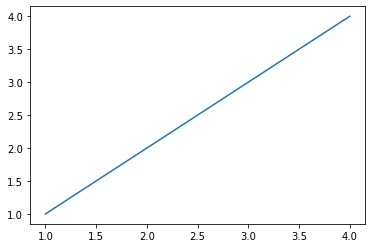

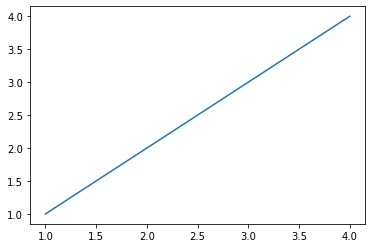

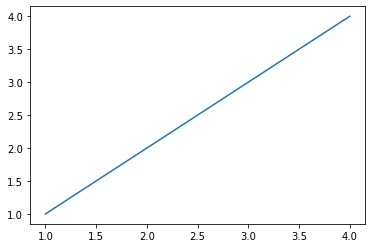

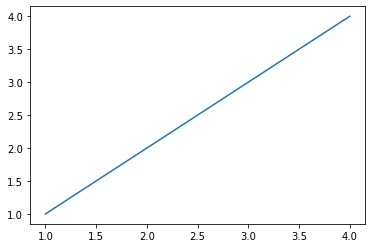

In [26]:
x=[[1,2,3,4],[1,2,3,4],[1,2,3,4],[1,2,3,4]]
y=[[1,2,3,4],[1,2,3,4],[1,2,3,4],[1,2,3,4]]
for i in range(len(x)):
    plt.figure()
    plt.plot(x[i],y[i])
    plt.show()



In [493]:
for i in range(len(arr_final)):
    date=arr_final[i,1]
    year=float(date[0:4])
    month=float(date[5:7])
    day=float(date[8:10])
    arr_final[i,1]=(year-2010)*365+month*30+day
    for j in range(5):
        try:
            arr_final[i][j]=float(arr_final[i][j])
        except:
            arr_final[i][j]=0
    #dt.append((year-2010)*365+month*30+day)
    #print (dt)
    

In [497]:
arr_final

array([['9415250.0', '361.0', '177.0', '36.51325', '-114.3359806'],
       ['9415250.0', '362.0', '167.0', '36.51325', '-114.3359806'],
       ['9415250.0', '363.0', '159.0', '36.51325', '-114.3359806'],
       ...,
       ['390059119102001.0', '889.0', '2.13', '39.01638889',
        '-119.1722222'],
       ['390059119102001.0', '890.0', '2.01', '39.01638889',
        '-119.1722222'],
       ['390059119102001.0', '891.0', '1.99', '39.01638889',
        '-119.1722222']], dtype='<U32')

In [500]:
x=np.concatenate((arr_final[:,:2].astype(float),arr_final[:,3:].astype(float)),axis=1)

y=arr_final[:,2].astype(float)
y

array([177.  , 167.  , 159.  , ...,   2.13,   2.01,   1.99])

In [501]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

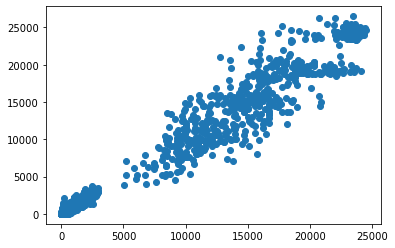

In [502]:
from sklearn.ensemble import RandomForestRegressor
regr_forest = make_pipeline(StandardScaler(),RandomForestRegressor(max_depth=12, random_state=0))
regr_forest.fit(X_train, y_train)
y_pred_forest=regr_forest.predict(X_test)
plt.scatter(y_pred_forest,y_test)

In [503]:
sk.metrics.r2_score(y_pred_forest,y_test)

0.9800632833114059

In [614]:
meta=[]
with open('/Users/marcberghouse/Downloads/usgs_stream_discharge', newline = '') as data:                                                                                          
    data_reader = csv.reader(data, delimiter='\t')
    for row in data_reader:
        count=count+1
        if count>0:
            if row[0]!='USGS':
                meta.append(row)

In [1]:
count=0
df_str=[]
idx=-1
import csv
with open('/Users/marcberghouse/Machine-Learning-in-Hydrology/data/streamflow/usgs_stream_discharge', newline = '') as data:                                                                                          
    data_reader = csv.reader(data, delimiter='\t')
    for row in data_reader:
        count=count+1
        if count>2:
            if row[0]!='USGS':
                if "agency_cd" in row[0]:
                    for i in range(len(row)):
                        #Get index for discharge
                        if "00060_00003" in row[i]:
                            if "cd" not in row[i]:
                                idx=i
                        #Get index for Temp (mean)
                        if "00010_00003" in row[i]:
                            if "cd" not in row[i]:
                                idx_temp=i
# #                         #pH (med)
                        if "00400_00008" in row[i]:
                            if "cd" not in row[i]:
                                idx_ph=i
# #                         #Sediment Load (mean)
#                         if "80155_00003" in row[i]:
#                             if "cd" not in row[i]:
#                                 idx_sed=i
#                         #Get index for Specific Conductance (mean)
                        if "00095_00003" in row[i]:
                            if "cd" not in row[i]:
                                idx_cond=i
        if idx!=-1:
            try:
                if ("n" not in row[idx])&("_" not in row[idx]) :
                    df_str.append([row[1],row[2],row[idx]
                                   ,row[idx_temp],row[idx_cond]
                                   ,row[idx_ph]])
                                  #,row[idx_temp_max],row[idx_temp_min]])
            except: 
                continue
                #print ("error with indexing")
                #print(row,count)

In [2]:
import numpy as np
arr_final=np.array(df_str)
for i in range(len(arr_final)):
    date=arr_final[i,1]
    year=float(date[0:4])
    month=float(date[5:7])
    day=float(date[8:10])
    arr_final[i,1]=(year-1990)*365+month*30+day
    for j in range(6):
        try:
            arr_final[i][j]=float(arr_final[i][j])
        except:
            arr_final[i][j]=np.nan


In [3]:
#Drop Nans if you set the except value in the cell above to nan
import pandas as pd
df=pd.DataFrame(arr_final.astype(float),columns=['site_id','date','discharge','temp','conductivity','pH'])
df.dropna(how='any',inplace=True)
df.drop(df.index[df.pH>14], inplace=True)
arr_final=np.array(df)
arr_final
df

,site_id,date,discharge,temp,conductivity,pH
5783,1481500.0,6141.0,254.0,15.6,259.0,7.9
5784,1481500.0,6142.0,239.0,15.6,286.0,8.0
5785,1481500.0,6143.0,219.0,16.6,296.0,8.1
5786,1481500.0,6144.0,213.0,18.2,299.0,8.2
5787,1481500.0,6145.0,217.0,18.7,303.0,8.2
...,...,...,...,...,...,...
103575,6711565.0,11307.0,52.4,5.1,1210.0,7.9
103576,6711565.0,11308.0,50.3,4.6,1170.0,7.9
103577,6711565.0,11309.0,49.1,4.5,1140.0,7.9
103578,6711565.0,11310.0,48.8,3.8,1140.0,7.9


In [6]:
#!pip install pandas-profiling
from pandas_profiling import ProfileReport

profile = ProfileReport(df, title="Pandas Profiling Report")

In [7]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
x=np.concatenate((arr_final[:,:2].astype(float),arr_final[:,3:].astype(float)),axis=1)

y=arr_final[:,2].astype(float)
len(y)


52147

In [5]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)

In [16]:
df.columns[0]

'site_id'

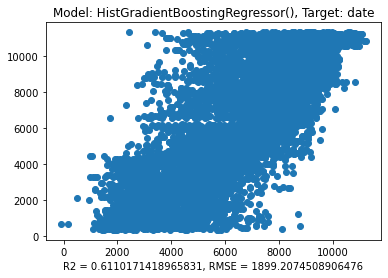

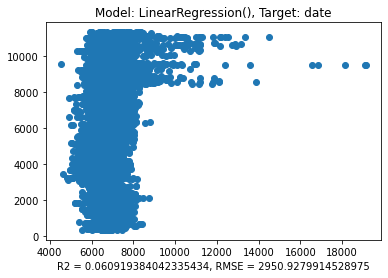

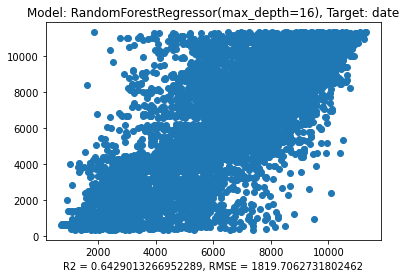

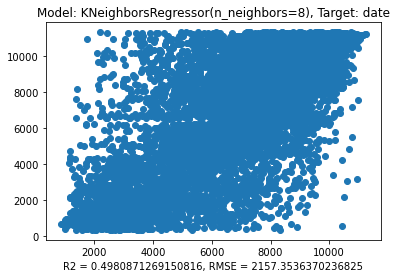

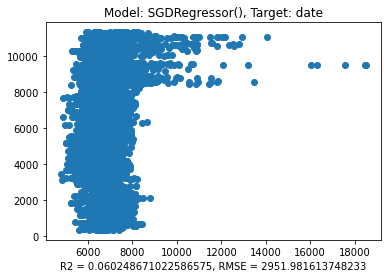

...

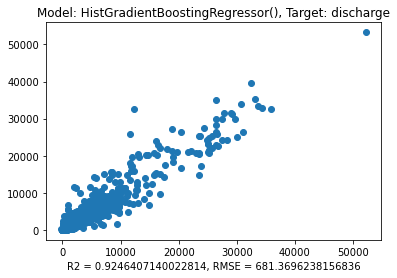

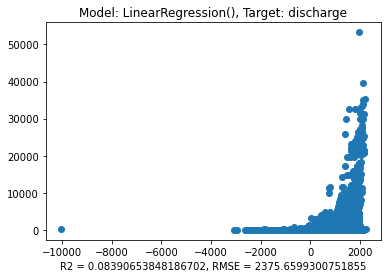

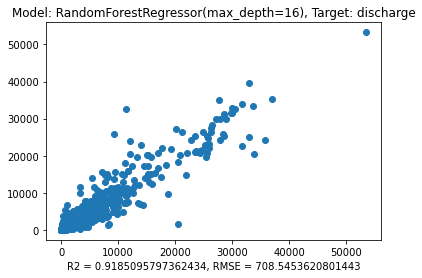

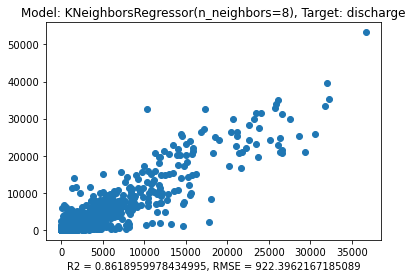

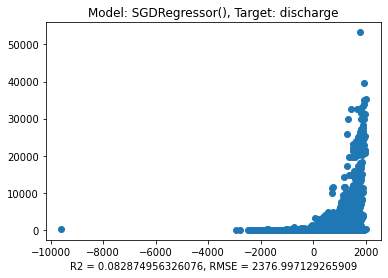

ValueError: Unknown label type: (array([7.60e-01, 7.80e-01, 8.30e-01, ..., 6.89e+04, 6.93e+04, 7.02e+04]),)

In [4]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split


import matplotlib.pyplot as plt
from sklearn.svm import SVC
model_list=[HistGradientBoostingRegressor(),LinearRegression(),RandomForestRegressor(max_depth=16)
            ,KNeighborsRegressor(n_neighbors=8),SGDRegressor(max_iter=1000, tol=1e-3)
            , GaussianNB(),AdaBoostRegressor()]

for j in range(1,6):
    if j == 0:
        x=arr_final[:,1:].astype(float)
        y=arr_final[:,0].astype(float)
        X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
    else:
        x=np.concatenate((arr_final[:,:j].astype(float),arr_final[:,j+1:].astype(float)),axis=1)
        y=arr_final[:,j].astype(float)
        X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
    
    count = 0
    for i in model_list:
        regr = make_pipeline(StandardScaler(),i)
        regr.fit(X_train, y_train)
        y_pred=regr.predict(X_test)
        plt.figure()
        plt.scatter(y_pred,y_test)
        r2=regr.score(X_test,y_test)
        rmse=mean_squared_error(y_pred,y_test, squared=False)
        plt.title('Model: '+str(model_list[count])+', Target: '+str(df.columns[j]))
        plt.xlabel('R2 = '+str(r2)+', RMSE = '+str(rmse))
        plt.show()
        count = count + 1

In [9]:
from sklearn.metrics import r2_score
r2_score(y_pred_forest,y_test)

0.8036429866674726

In [10]:
from sklearn.linear_model import LassoCV

lasso_pipeline = make_pipeline(StandardScaler(), LassoCV(n_jobs=-1))
forest_pipeline = make_pipeline(StandardScaler(),RandomForestRegressor(n_estimators=100,max_depth=16))
from sklearn.ensemble import HistGradientBoostingRegressor

gbdt_pipeline = make_pipeline(StandardScaler(), HistGradientBoostingRegressor(random_state=0,l2_regularization=1,max_leaf_nodes=50))

In [49]:

from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV

estimators = [
    ("Random Forest", forest_pipeline),
    ("Lasso", lasso_pipeline),
    ("Gradient Boosting", gbdt_pipeline),
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())
stacking_regressor

StackingRegressor(estimators=[('Random Forest',
                               Pipeline(steps=[('standardscaler',
                                                StandardScaler()),
                                               ('randomforestregressor',
                                                RandomForestRegressor(max_depth=16))])),
                              ('Lasso',
                               Pipeline(steps=[('standardscaler',
                                                StandardScaler()),
                                               ('lassocv',
                                                LassoCV(n_jobs=-1))])),
                              ('Gradient Boosting',
                               Pipeline(steps=[('standardscaler',
                                                StandardScaler()),
                                               ('histgradientboostingregressor',
                                                HistGradientBoostingRegressor(l2_regula

NameError: name 'y_true' is not defined

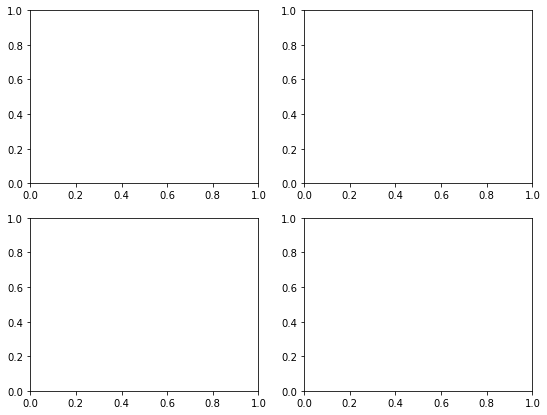

In [38]:
import time
import matplotlib.pyplot as plt
#from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_validate, cross_val_predict

fig, axs = plt.subplots(2, 2, figsize=(9, 7))
axs = np.ravel(axs)

for ax, (name, est) in zip(
    axs, estimators + [("Stacking Regressor", stacking_regressor)]
):
    scorers = {"R2": "r2", "MAE": "neg_mean_absolute_error"}

    start_time = time.time()
    scores = cross_validate(
        est, x, y, scoring=list(scorers.values()), n_jobs=-1, verbose=0
    )
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, x, y, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.2f} +- "
            f"{np.std(scores[f'test_{value}']):.2f}"
        )
        for key, value in scorers.items()
    }
    #plt.scatter(y_pred,y_true)

#     display = PredictionErrorDisplay.from_predictions(
#         y_true=y,
#         y_pred=y_pred,
#         kind="actual_vs_predicted",
#         ax=ax,
#         scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
#         line_kwargs={"color": "tab:red"},
#     )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.2f} seconds")

    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="upper left")

plt.suptitle("Single predictors versus stacked predictors")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.show()

In [50]:
stacking_regressor.fit(X_train, y_train)


StackingRegressor(estimators=[('Random Forest',
                               Pipeline(steps=[('standardscaler',
                                                StandardScaler()),
                                               ('randomforestregressor',
                                                RandomForestRegressor(max_depth=16))])),
                              ('Lasso',
                               Pipeline(steps=[('standardscaler',
                                                StandardScaler()),
                                               ('lassocv',
                                                LassoCV(n_jobs=-1))])),
                              ('Gradient Boosting',
                               Pipeline(steps=[('standardscaler',
                                                StandardScaler()),
                                               ('histgradientboostingregressor',
                                                HistGradientBoostingRegressor(l2_regula

0.8863952829389371

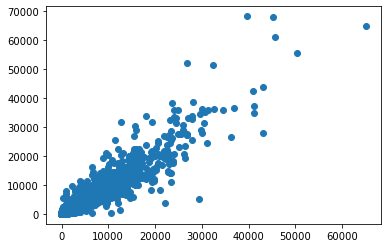

In [51]:
y_pred=stacking_regressor.predict(X_test)
plt.scatter(y_pred,y_test)
r2_score(y_pred,y_test)

In [34]:
!pip install scipy


[notice] A new release of pip available: 22.2.2 -> 23.0.1
[notice] To update, run: pip install --upgrade pip


In [35]:
!pip install --upgrade pip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 5.8 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: pip
    Found existing installation: pip 22.2.2
    Uninstalling pip-22.2.2:
      Successfully uninstalled pip-22.2.2


In [36]:
pip install --upgrade sklearn

  Preparing metadata (setup.py) ... done
  Created wheel for sklearn: filename=sklearn-0.0.post1-py3-none-any.whl size=2959 sha256=565aea0c78d2100120323b98a07075224867efaad64792117376441f55297112
  Stored in directory: /Users/marcberghouse/Library/Caches/pip/wheels/f8/e0/3d/9d0c2020c44a519b9f02ab4fa6d2a4a996c98d79ab2f569fa1
Successfully built sklearn
Note: you may need to restart the kernel to use updated packages.


In [14]:
from sklearn.model_selection import cross_val_score
# from sklearn import svm

# clf = svm.SVR(kernel='linear', C=1)
#regr_forest.fit(X_train, y_train)
scores = cross_val_score(gbdt_pipeline, x, y, cv=5,n_jobs=-1)
scores


array([-6.01198027e+01, -4.37463104e-02, -2.82191934e-03,  2.19213715e-02,
       -9.54215469e-01])

In [31]:
regr_forest = make_pipeline(StandardScaler(),RandomForestRegressor(max_depth=16))
from sklearn.model_selection import GridSearchCV

parameters = {'randomforestregressor__criterion':('squared_error', 'absolute_error'),
              'randomforestregressor__n_estimators':[200,400]
             }
forest_best = GridSearchCV(regr_forest, parameters, cv=2)
grid_reg=forest_best.fit(X_train, y_train)

KeyboardInterrupt: 

In [19]:
regr_forest.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'standardscaler', 'randomforestregressor', 'standardscaler__copy', 'standardscaler__with_mean', 'standardscaler__with_std', 'randomforestregressor__bootstrap', 'randomforestregressor__ccp_alpha', 'randomforestregressor__criterion', 'randomforestregressor__max_depth', 'randomforestregressor__max_features', 'randomforestregressor__max_leaf_nodes', 'randomforestregressor__max_samples', 'randomforestregressor__min_impurity_decrease', 'randomforestregressor__min_samples_leaf', 'randomforestregressor__min_samples_split', 'randomforestregressor__min_weight_fraction_leaf', 'randomforestregressor__n_estimators', 'randomforestregressor__n_jobs', 'randomforestregressor__oob_score', 'randomforestregressor__random_state', 'randomforestregressor__verbose', 'randomforestregressor__warm_start'])

In [30]:
grid_reg.cv_results_

{'mean_fit_time': array([ 5.35024035, 10.81420004]),
 'std_fit_time': array([0.05869663, 0.16252482]),
 'mean_score_time': array([0.38265562, 0.71635258]),
 'std_score_time': array([0.01662159, 0.01583564]),
 'param_randomforestregressor__n_estimators': masked_array(data=[100, 200],
              mask=[False, False],
        fill_value='?',
             dtype=object),
 'params': [{'randomforestregressor__n_estimators': 100},
  {'randomforestregressor__n_estimators': 200}],
 'split0_test_score': array([0.80919716, 0.81664557]),
 'split1_test_score': array([0.84770229, 0.84676721]),
 'mean_test_score': array([0.82844973, 0.83170639]),
 'std_test_score': array([0.01925256, 0.01506082]),
 'rank_test_score': array([2, 1], dtype=int32)}

In [18]:
df[df.discharge>50000]

,site_id,date,discharge,temp,conductivity,pH
35396,23432415.0,8888.0,68100.0,17.5,77.0,77.0
35397,23432415.0,8889.0,71200.0,17.3,76.0,76.0
35398,23432415.0,8890.0,63000.0,17.3,74.0,74.0
35407,23432415.0,8899.0,60500.0,17.1,58.0,58.0
35408,23432415.0,8900.0,63100.0,16.9,57.0,57.0
36021,23432415.0,9509.0,75000.0,14.9,100.0,100.0
36022,23432415.0,9510.0,143000.0,15.0,92.0,92.0
36398,23432415.0,9889.0,51100.0,14.2,112.0,112.0
37123,23432415.0,10610.0,51800.0,11.9,76.0,76.0
37124,23432415.0,10611.0,50400.0,12.0,72.0,72.0


In [19]:
df.drop(df[df['discharge'] > 50000].index, inplace = True)
df

,site_id,date,discharge,temp,conductivity,pH
5783,1481500.0,6141.0,254.0,15.6,259.0,7.9
5784,1481500.0,6142.0,239.0,15.6,286.0,8.0
5785,1481500.0,6143.0,219.0,16.6,296.0,8.1
5786,1481500.0,6144.0,213.0,18.2,299.0,8.2
5787,1481500.0,6145.0,217.0,18.7,303.0,8.2
...,...,...,...,...,...,...
103575,6711565.0,11307.0,52.4,5.1,1210.0,7.9
103576,6711565.0,11308.0,50.3,4.6,1170.0,7.9
103577,6711565.0,11309.0,49.1,4.5,1140.0,7.9
103578,6711565.0,11310.0,48.8,3.8,1140.0,7.9


In [20]:
df[df.discharge>50000]

,site_id,date,discharge,temp,conductivity,pH
